# Introduction

Ce deuxième notebook reprend le data set préparé, par le notebook d’exploration, et se résume comme suit : 
<ol>
    <li>Réduire la dimensionnalité des données, pour réduire la complexité du problème et éventuellement identifier des groupes d’individus distinguables (séparables) et non similaires, avec les méthodes :
        <ul>
            <li><strong>PCA</strong> : réduction linéaire des données ;</li>
            <li><strong>TSNE</strong> : réduction non-linéaire (variété) se focalisant sur la structure locale des données ;</li>
            <li><strong>UMPA</strong> : similaire au <strong>TSNE</strong> mais se basant sur  une variété <em>Riemannienne</em> ;</li>
        </ul>
    </li>
    <li> Tester et comparer plusieurs  techniques de clustering par :
        <ul>
            <li><em>Densité</em> : <strong>DBSCAN</strong> ;</li>
            <li><em>Agglomération</em> : Clustering Hiérarchique par lien Simple (<strong>HCS</strong>) ;</li>
            <li><em>Inertie</em> sur des données de type :
        <ul>
            <li>Numérique : 
        <ul>
            <li><strong>KMeans</strong></li>
            <li><strong>KMeans++</strong> : variante plus stable du <strong>KMeans</strong> </li>
            <li><strong>MiniBatchKMeans(++)</strong> : variante  du <strong>KMeans++</strong> qui travail sur des sous-ensembles (batch) des données pour réduire la complexité temporelle ;</li>
            <li><strong>BisectingKMeans(++)</strong> : variante itérative du <strong>KMeans++</strong> qui détermine les centroïdes de façon dichotomique (<em>bissection</em>) i.e. à chaque itération les clusters sont coupés en deux ;</li>
        </ul>
</li>
            <li>Catégoriel : <strong>KModes</strong> ;</li>
            <li>Mixtes : <strong>KPrototypes</strong>, un mélange de <strong>KMeans</strong> (sur les données numériques) et de  <strong>KModes</strong> (sur les données catégorielles) ;</li>
        </ul>

</li>
        </ul>
    </li>
    <li> Evaluer les performances du meilleure modèle de segmentation et interpréter les groupes produits.
    </li>
</ol>


In [1]:
# Librairies personnalisées
from my_functions.common_functions import *
from my_functions.machine_learning_common_functions import *
from my_functions.dimensionality_reduction_functions import *

from sklearn.manifold import TSNE
import umap
from sklearn.cluster import AgglomerativeClustering, KMeans, MiniBatchKMeans,BisectingKMeans, DBSCAN
from kmodes.kmodes import KModes
from kmodes.kprototypes import KPrototypes
from sklearn.metrics import adjusted_rand_score
import shap

%matplotlib inline
low_memory=False # faible mémoire vive (RAM) pour gérer la lecture de gros fichiers

In [552]:
# Chargement du data set préparé
data = pd.read_csv('olist.csv', low_memory=low_memory)
data

,customer_unique_id,Freshness(R),multi_orders(F),payment_value(M),review_score(S),daytime,weekday,month,orders_volume,payment_sequential,payment_installments,pcateg,customer_state,payment_type
0,0000366f3b9a7992bf8c76cfdf3221e2,0.840025,0,2.0,5,1.0,3.0,10.0,1,1,8,63.0,5.0,3.0
1,0000b849f77a49e4a4ce2b2a4ca5be3f,0.835723,0,1.0,4,1.0,6.0,10.0,1,1,1,62.0,5.0,3.0
2,0000f46a3911fa3c0805444483337064,0.227613,0,1.0,3,2.0,2.0,8.0,1,1,8,55.0,4.0,3.0
3,0000f6ccb0745a6a4b88665a16c9f078,0.538405,0,1.0,4,2.0,3.0,1.0,1,1,4,56.0,4.0,3.0
4,0004aac84e0df4da2b147fca70cf8255,0.585848,0,2.0,5,2.0,5.0,3.0,1,1,6,56.0,5.0,3.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
91471,fffcf5a5ff07b0908bd4e2dbc735a684,0.357120,0,4.0,5,2.0,3.0,7.0,3,1,10,62.0,4.0,3.0
91472,fffea47cd6d3cc0a88bd621562a9d061,0.623285,0,1.0,4,2.0,1.0,2.0,1,1,1,49.0,4.0,3.0
91473,ffff371b4d645b6ecea244b27531430a,0.182688,0,2.0,5,3.0,5.0,5.0,1,1,1,54.0,4.0,3.0
91474,ffff5962728ec6157033ef9805bacc48,0.828774,0,2.0,5,3.0,4.0,10.0,1,1,5,57.0,4.0,3.0


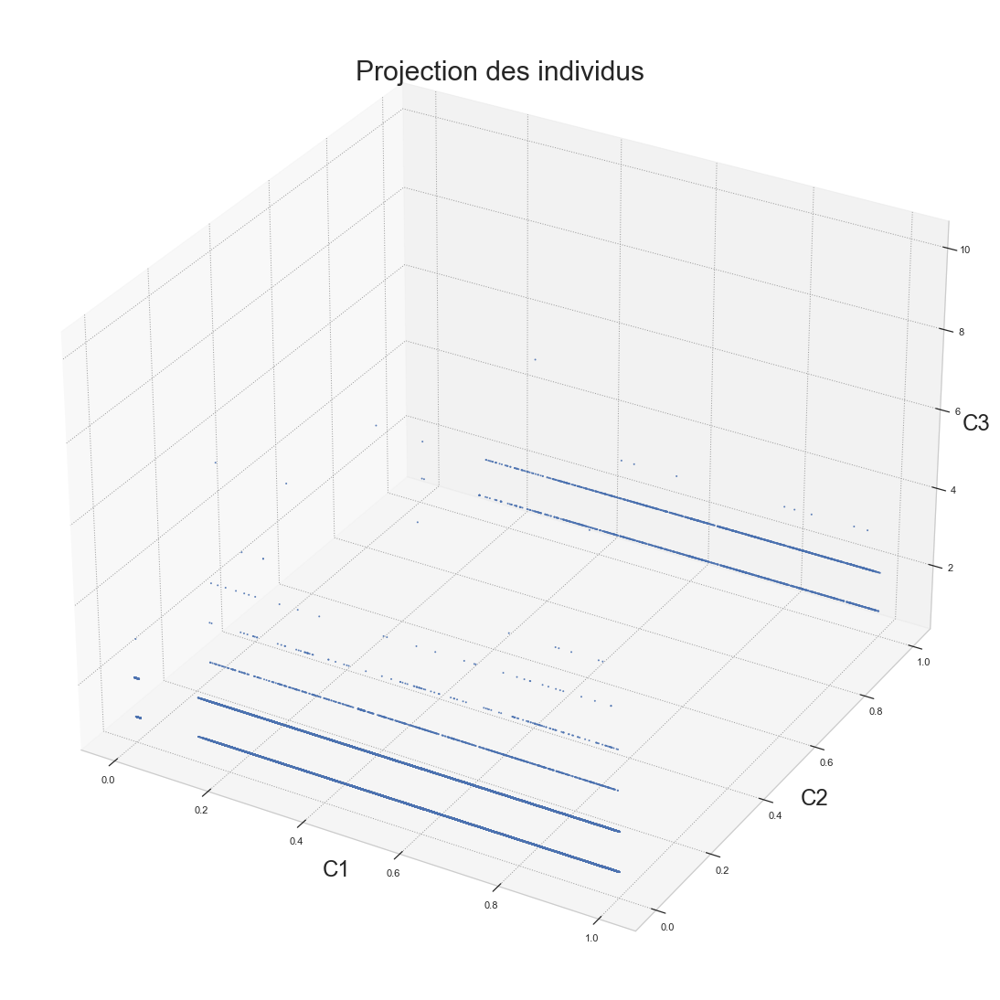

In [3]:
%matplotlib inline
# Projection des données sur les 3 axes R-F-M
DisplayManifold3D(data[['Freshness(R)', 'multi_orders(F)', 'payment_value(M)']].values, s=1)

# 1. Réducion Dimensionnelle

Dans cette première partie, les données subissent différentes méthodes de réduction dimensionnelle.

## 1.1. PCA

La première méthode de réduction dimensionnelle utilisée est la plus simple et la plus rapide.

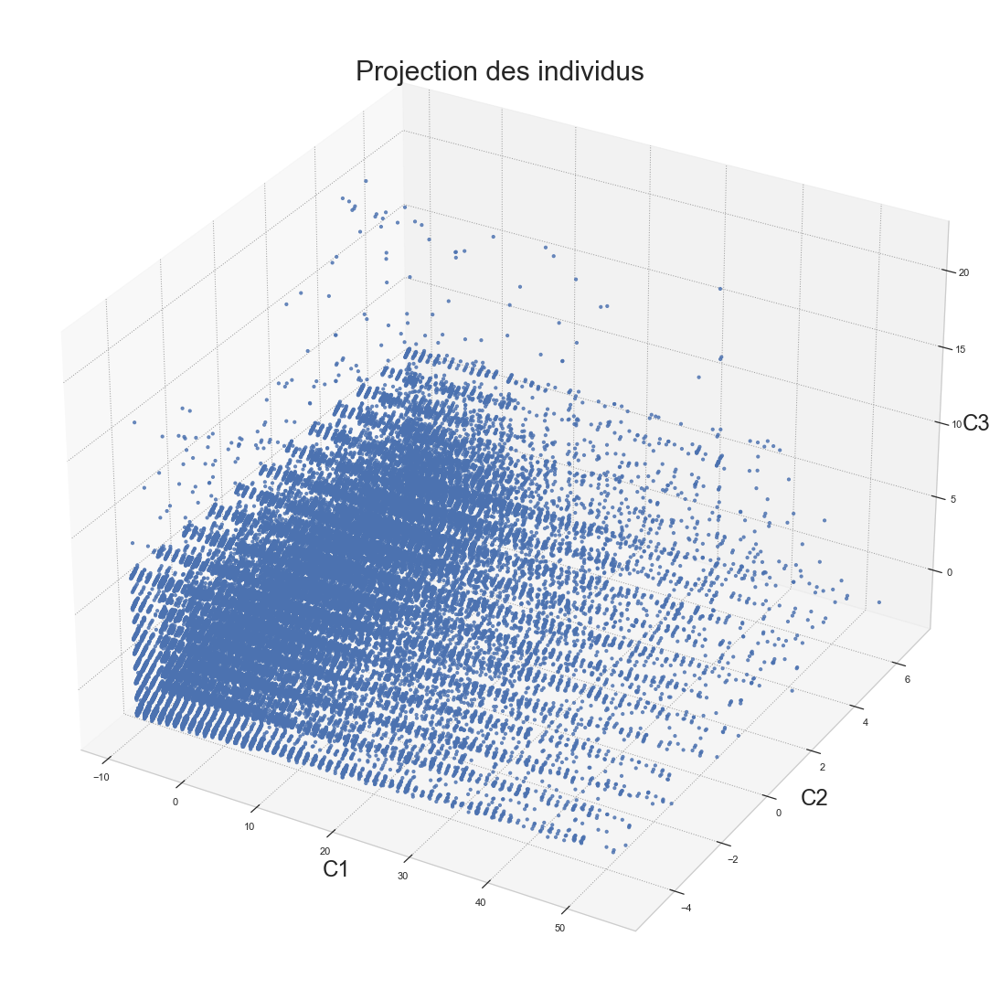

In [4]:
# %matplotlib widget
%matplotlib inline

pca = PCA(data, 3, enable_display_circles=False, enable_display_scree_plot=False, display_3D=True)

La réduction des données par PCA résulte en une masse de données dense et homogène. De plus la projection ne montre aucune structure susceptible de produire une segmentation pertinente.

## 1.2. Variétés (Manifolds)

Les prochaines méthodes de réduction dimensionnelle, bien que plus complexe que du PCA, tentent de projeter de façon non-linéaire les données sur des variétés (formes géométriques) dans un espace de dimension inférieure.

### 1.2.1. TSNE

TSNE converti les similarités entre les données en probabilités et essaie de reproduire au mieux ces probabilités dans l’espace de dimension inférieure.

In [559]:
tsne_manifolded = ManifoldReduction3D(data, manifold = TSNE(n_components=3, perplexity=100, init="random", random_state=0, learning_rate='auto', metric='minkowski'))

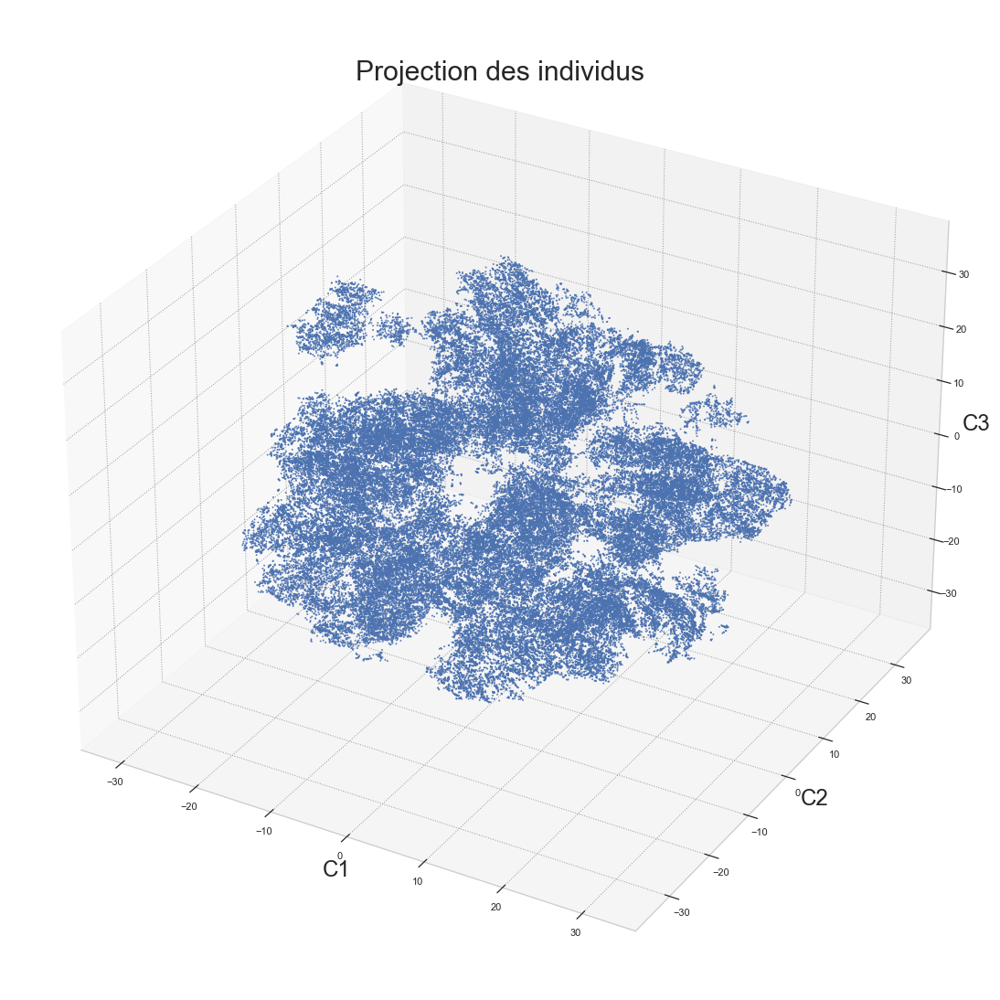

In [560]:
# %matplotlib widget
DisplayManifold3D(tsne_manifolded, s=1)

TSNE produit une réduction/projection des données, bien que non homogène, très dispersée et fortement connectée. Ce qui rend la distinction de groupes difficile.

### 1.2.2. UMAP

De manière similaire à TSNE, UMAP tente de respecter la structure locale des données pour les réduire, mais les projette sur une variété Riemannienne.

In [9]:
umaped = ManifoldReduction3D(data, manifold = umap.UMAP(n_neighbors=100, min_dist=0.0, metric='minkowski', n_components=3))

In [10]:
pd.DataFrame(umaped, columns=['C'+str(i) for i in range (1,4)]).to_csv('olist_umaped.csv', index=False)

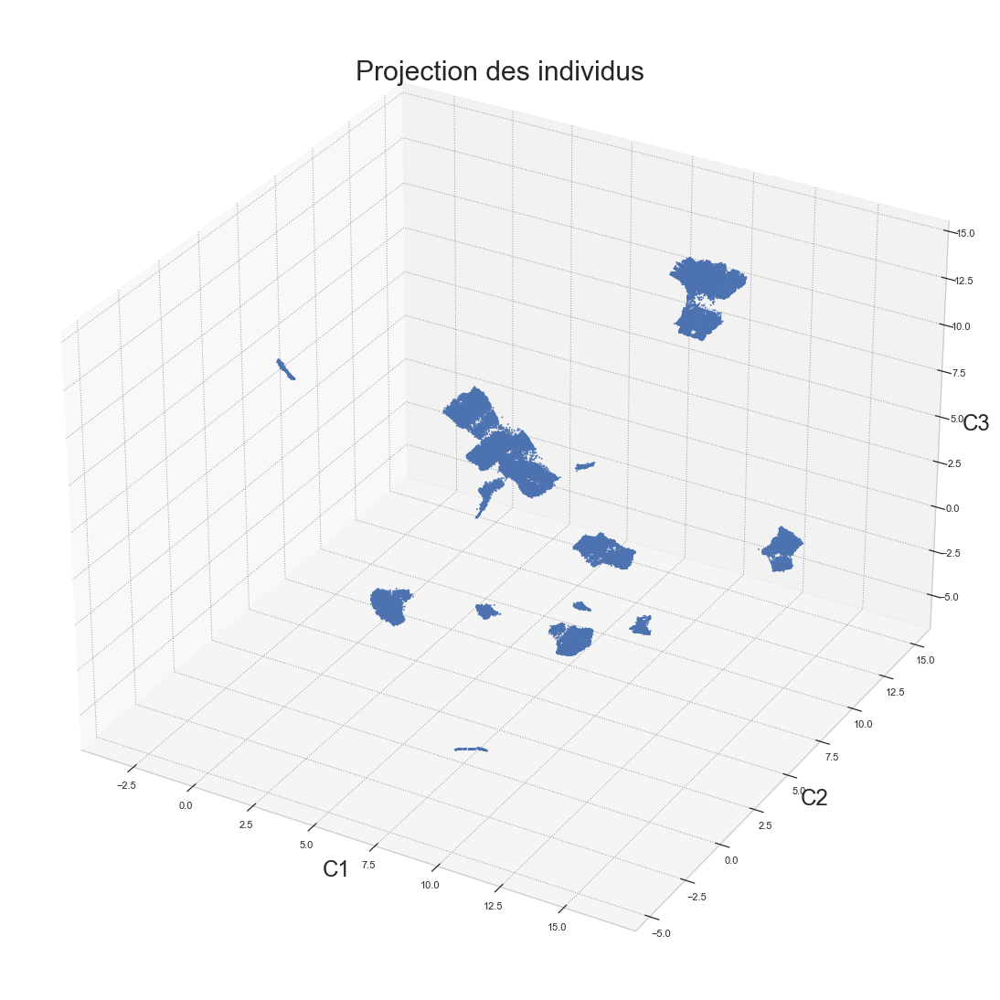

In [11]:
# %matplotlib widget
%matplotlib inline
DisplayManifold3D(umaped, s=1)

Cette dernière méthode produit une réduction des données qui exhibe des groupes très denses, éloignés les uns des autres et hétérogènes. Ainsi, cette projection est celle susceptible de donner la meilleure segmentation possible.

# 2. Clustering

<p>Dans cette partie, les différentes techniques de segmentation (présentées en introduction), seront tester plusieurs fois de suite (<em>n_iter</em>) pour diminuer l’impact du hasard intrinsèque. </p>
De plus, toutes ces techniques seront comparées grâce à aux critères suivant :
<ul>
    <li><strong> Variance (Calinski-Harabasz Index)</strong> : Élevée pour des clusters denses et bien séparés.</li>
    <li><strong> Similarité (Davies-Bouldin Index) [0,1]</strong> :
<ul>
    <li> Similarité moyenne entre chaque cluster et son cluster le plus similaire.</li>
    <li> Faible pour un meilleur clustering.</li>
</ul>
</li>
    <li><strong> Silhouette [-1,1]</strong> : 
<ul>
    <li><strong>-1</strong> : mauvais clustering ;</li>
    <li><strong>0</strong> : chevauchement ;</li>
    <li><strong>+1</strong> : clusters denses ;</li>
</ul>
</li>
    <li><strong> Temps (s)</strong> : temps d'exécution (complexité temporelle).</li>
</ul>

In [114]:
# Sélection des scores pour l'évaluation des modèles
scores = ['Calinski-Harabasz(Var)', 'Davies-Bouldin(Sim)', 'Silhouette']
best_models = []

Perfs = None
try :
    # Chargement des Perfs précédentes
    Perfs = pd.read_csv('Perfs.csv', low_memory=low_memory)
except:
    Perfs = pd.DataFrame(columns=['Model']+scores, index=[])

Perfs

,Model,Calinski-Harabasz(Var),Davies-Bouldin(Sim),Silhouette,Time(s),hue
0,DBSCAN,2160.105667,1.562368,-0.236398,30.920804,df
1,DBSCAN,299230.376100,0.259163,0.733469,253.267249,umaped
2,DBSCAN,338645.909900,0.298992,0.741529,425.288206,umaped
3,DBSCAN,338645.909900,0.298992,0.741529,335.649529,umaped
4,DBSCAN,2160.098557,1.562369,-0.236399,29.557987,df
...,...,...,...,...,...,...
941,KPrototypes(9),805.861176,12.800959,-0.007845,613.255155,df
942,KPrototypes(10),731.410015,11.218519,-0.006101,758.681390,df
943,KPrototypes(11),701.602624,9.941161,-0.017098,887.153904,df
944,KPrototypes(12),630.880085,11.323038,-0.017142,958.960141,df


In [115]:
data = pd.DataFrame(umaped, columns=['C'+str(i) for i in range (1,4)])
scale = 'std'
hue = 'umaped'
# hue = 'df'
display_components=3 # <1 aucun diplay, 3 display 3D, sinon display 2D sur le nombre de composantes choisies
projection = umaped
# %matplotlib widget

## 2.1. DBSCAN

L'algorithme DBSCAN considère les clusters comme des zones à haute densité séparées par des zones à faible densité.

-------------------- DBSCAN --------------------
Model                            DBSCAN
Calinski-Harabasz(Var)    299950.857401
Davies-Bouldin(Sim)            0.259362
Silhouette                      0.73449
Time(s)                      428.553993
hue                              umaped
Name: 923, dtype: object


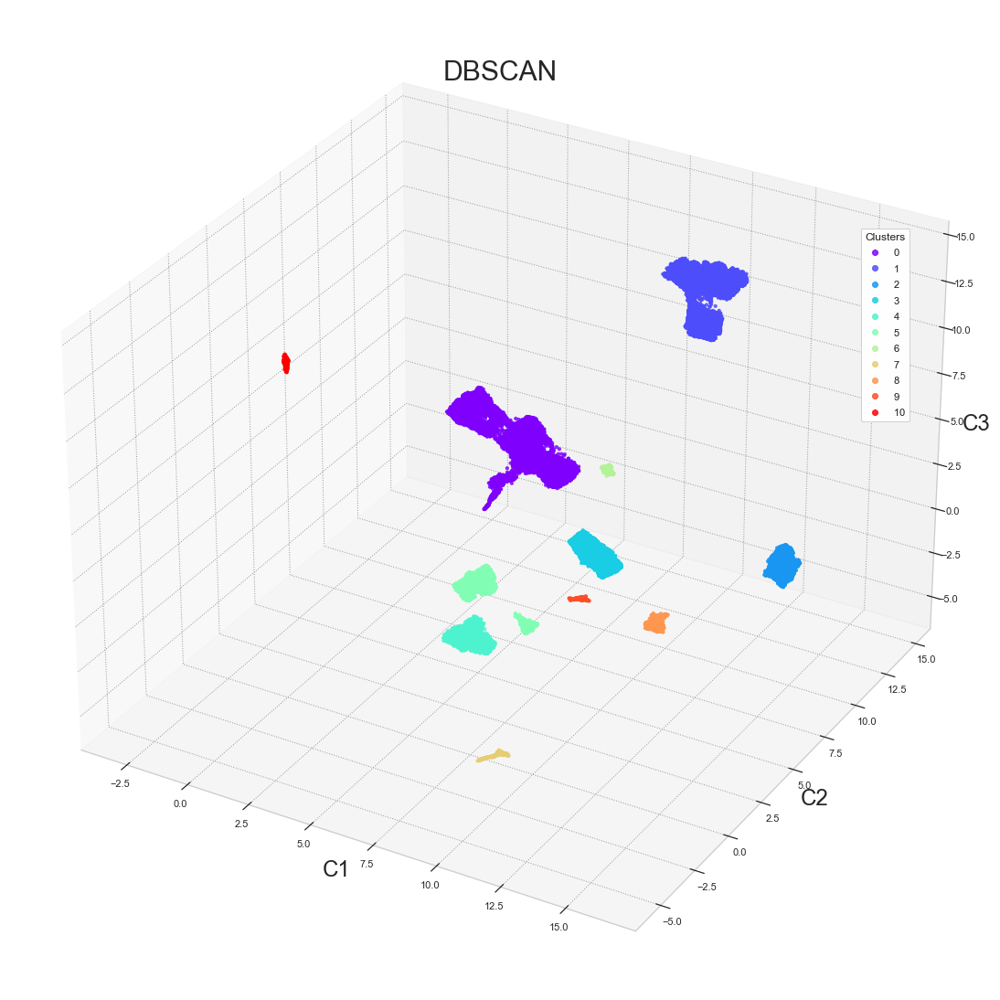

In [15]:
# %matplotlib widget
dbscan = clustering(data, DBSCAN(eps=2, min_samples=100, n_jobs=-1), 'DBSCAN', projection, Perfs, scale=scale, scores=scores, hue=hue, display_components=display_components)
best_models.append('DBSCAN')

<p>DBSCAN a produit de 10 segments d’individus, quasiment un segment par groupes de données dans la projection. Même si cette segmentation est fidèle à la projection des données, le grand nombre de segments rendrait la démarche marketing très importante, surtout si on considère les petits clusters proches (5, 6) peuvent être un seul segment.</p>

Contrairement à DBSCAN, qui trouve seul le nombre de clusters , tous les prochains algorithmes de  clustering ont besoin de l’hyperparamètre du nombre de clusters à identifier (k). Donc, on exécute plus fois ces algorithme sur plage de valeurs possible de k (kmin et kmax).

In [54]:
n_iter = 10 # le nombre de réédition de chaque exécution
kmin = 2 # borne inférieure de la plage de l'hyperparamètre k
kmax = 13 # borne supérieure de la plage de l'hyperparamètre k

## 2.2. Hierarchical Clustering with Single linkage (HCS)

<P>Le clustering hiérarchique est une famille générale d'algorithmes de clustering qui construisent des clusters imbriqués en les fusionnant ou en les divisant successivement.</P>
HCS minimise la distance moyenne entre les individus les plus proches des clusters deux à deux.

-------------------- HCS(2) --------------------
Model                          HCS(2)
Calinski-Harabasz(Var)    5501.914437
Davies-Bouldin(Sim)          0.715866
Silhouette                   0.283738
Time(s)                     93.256267
hue                            umaped
Name: 941, dtype: object


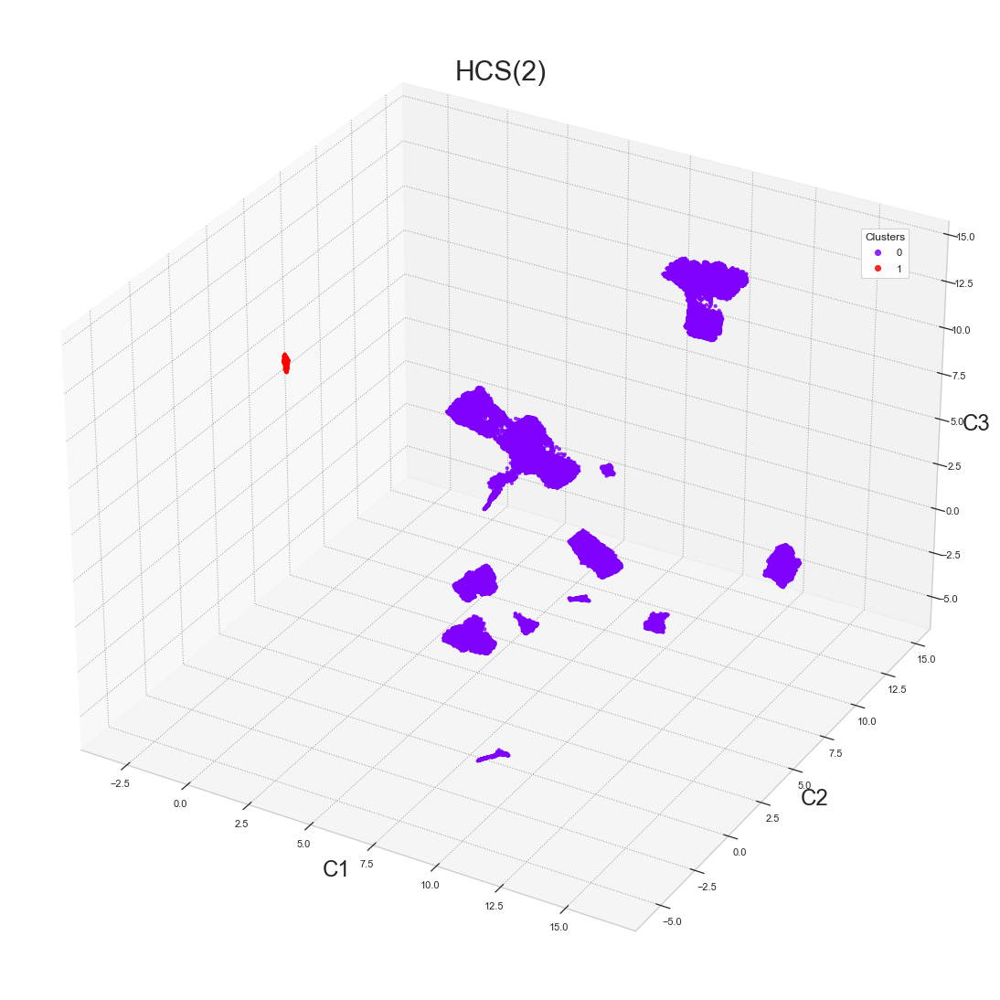

-------------------- HCS(3) --------------------
Model                           HCS(3)
Calinski-Harabasz(Var)    34081.621856
Davies-Bouldin(Sim)           0.697664
Silhouette                    0.454849
Time(s)                      96.138704
hue                             umaped
Name: 942, dtype: object


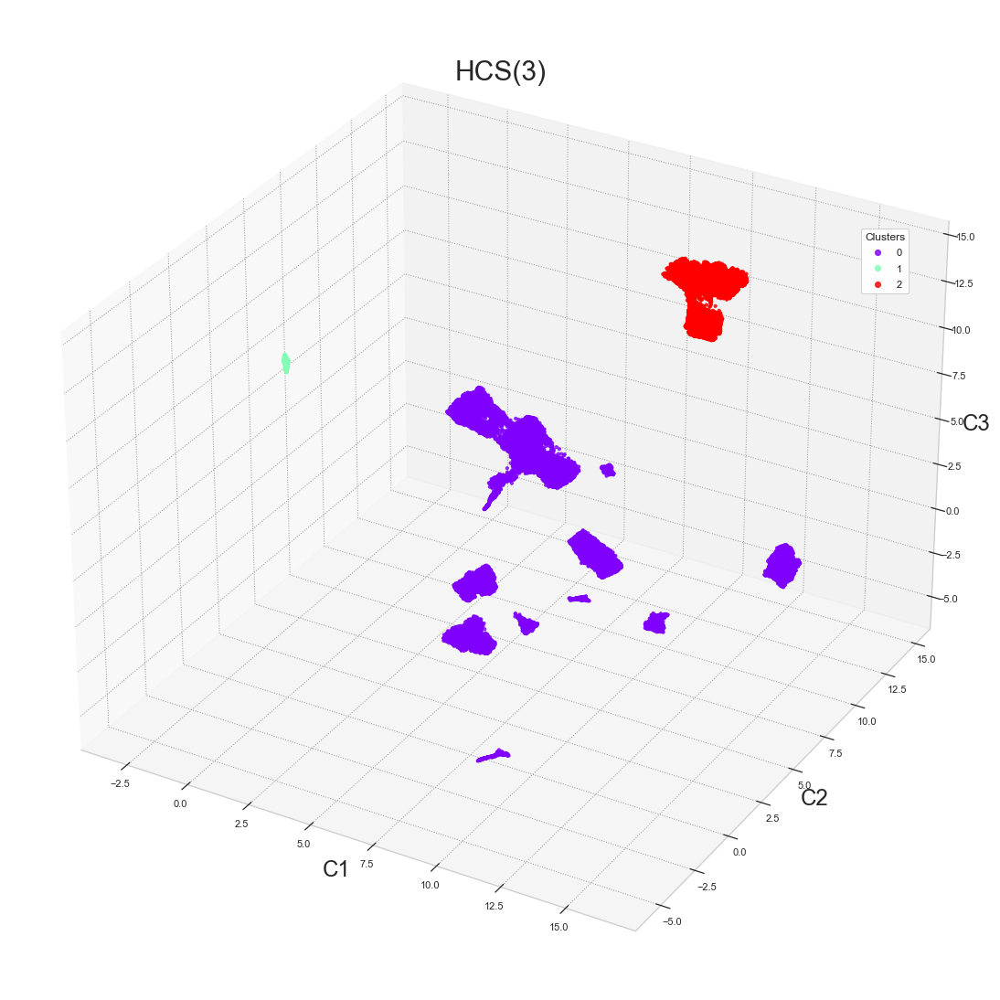

-------------------- HCS(4) --------------------
Model                           HCS(4)
Calinski-Harabasz(Var)    25039.834578
Davies-Bouldin(Sim)           0.694552
Silhouette                    0.356712
Time(s)                      96.322705
hue                             umaped
Name: 943, dtype: object


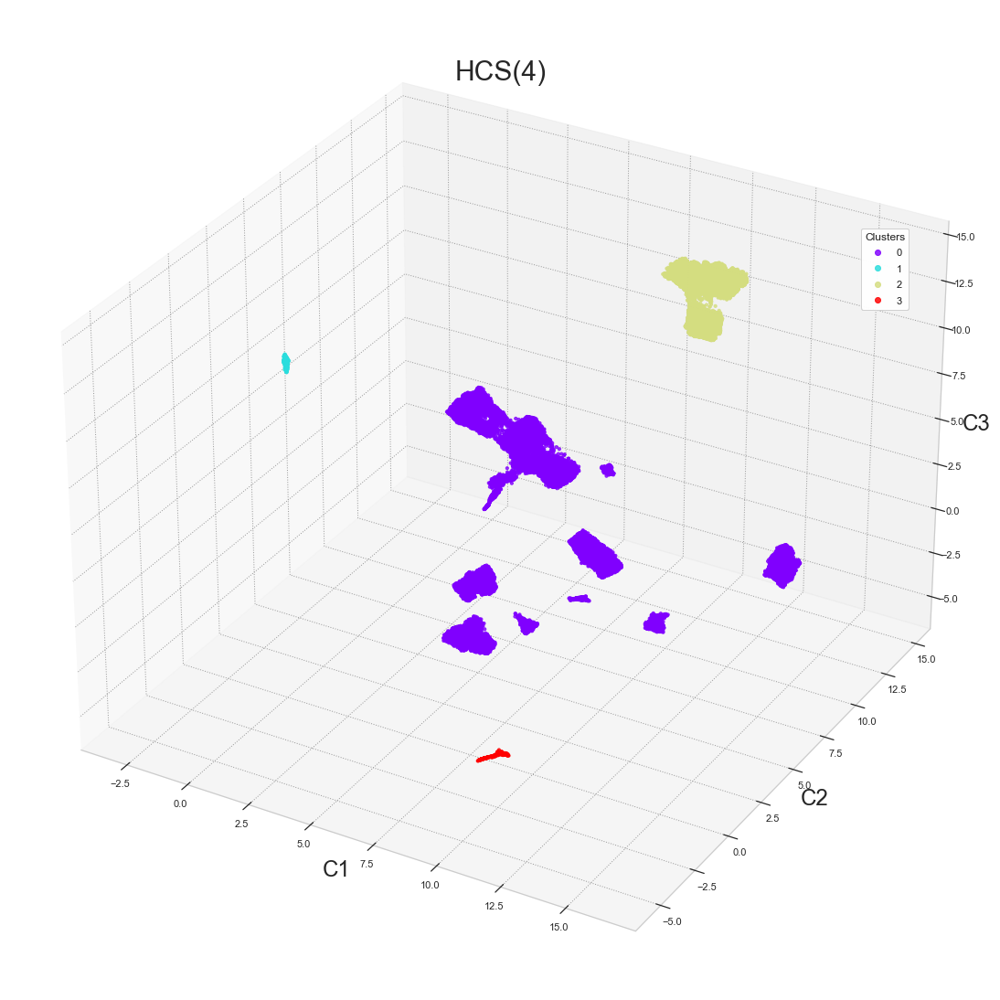

-------------------- HCS(5) --------------------
Model                           HCS(5)
Calinski-Harabasz(Var)    78443.878025
Davies-Bouldin(Sim)           0.528966
Silhouette                    0.566432
Time(s)                      96.634318
hue                             umaped
Name: 944, dtype: object


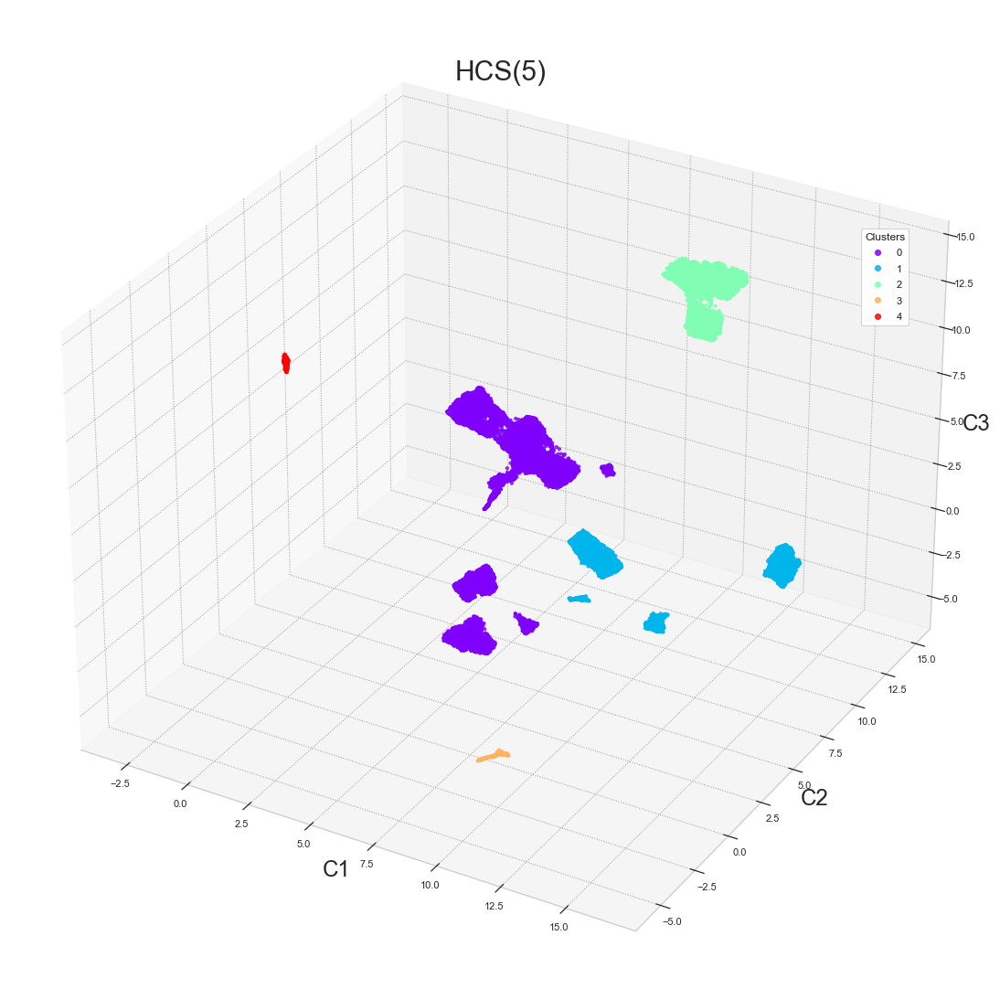

-------------------- HCS(6) --------------------
Model                            HCS(6)
Calinski-Harabasz(Var)    157370.534508
Davies-Bouldin(Sim)             0.54531
Silhouette                      0.67409
Time(s)                      100.921769
hue                              umaped
Name: 945, dtype: object


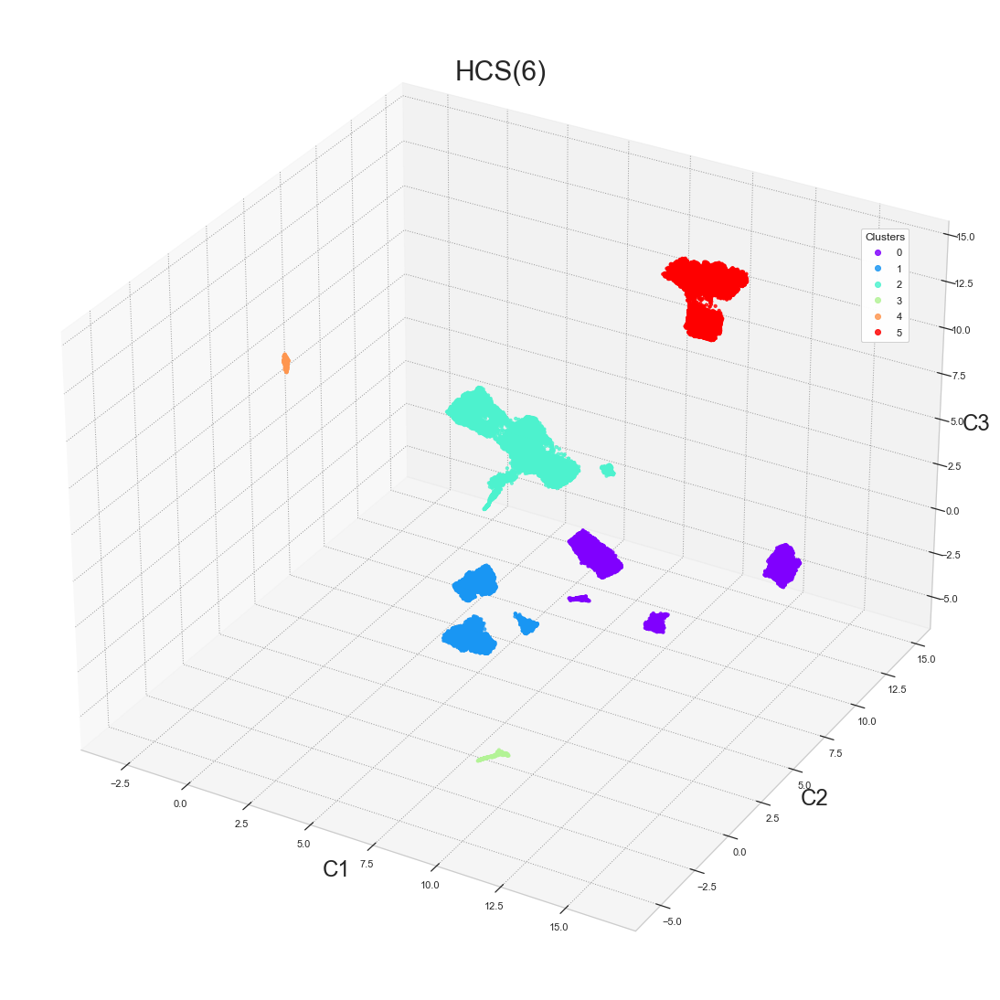

-------------------- HCS(7) --------------------
Model                            HCS(7)
Calinski-Harabasz(Var)    208030.421996
Davies-Bouldin(Sim)            0.448698
Silhouette                     0.708786
Time(s)                       108.76074
hue                              umaped
Name: 946, dtype: object


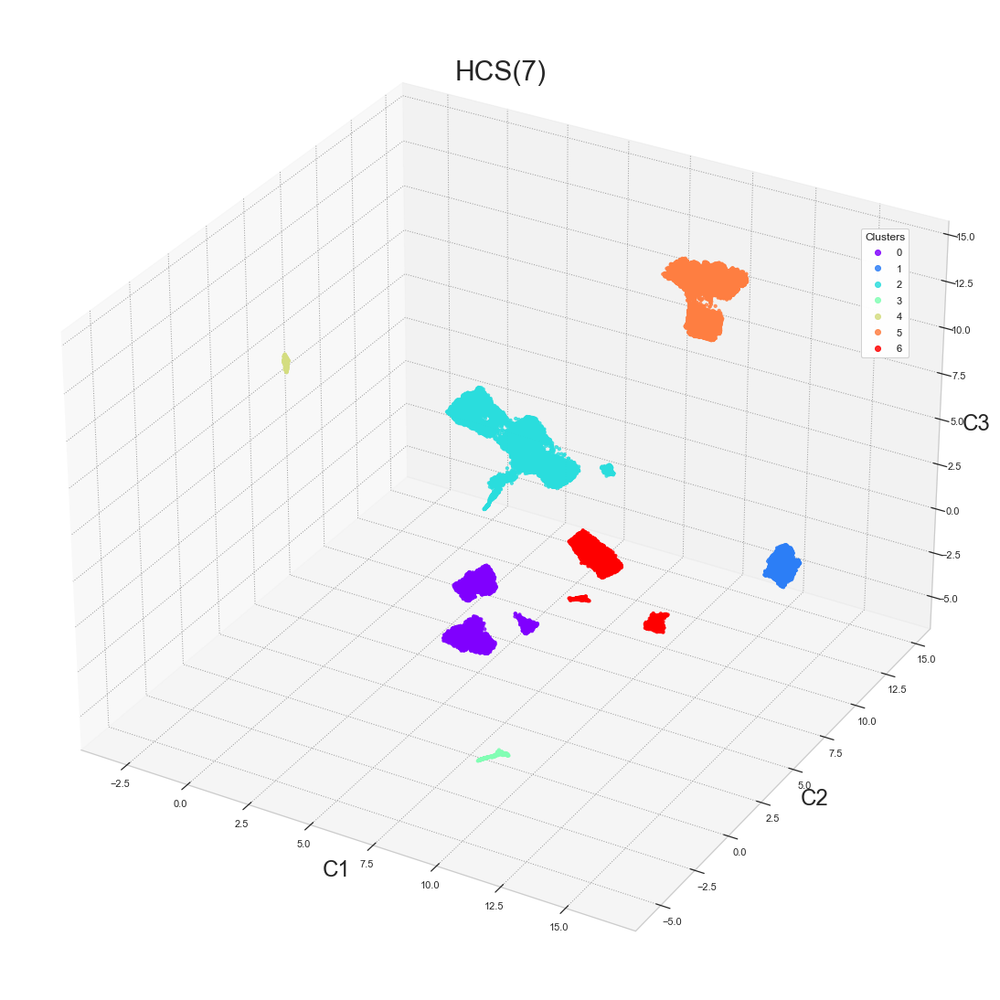

-------------------- HCS(8) --------------------
Model                            HCS(8)
Calinski-Harabasz(Var)    274152.188666
Davies-Bouldin(Sim)            0.338175
Silhouette                     0.745077
Time(s)                       103.97836
hue                              umaped
Name: 947, dtype: object


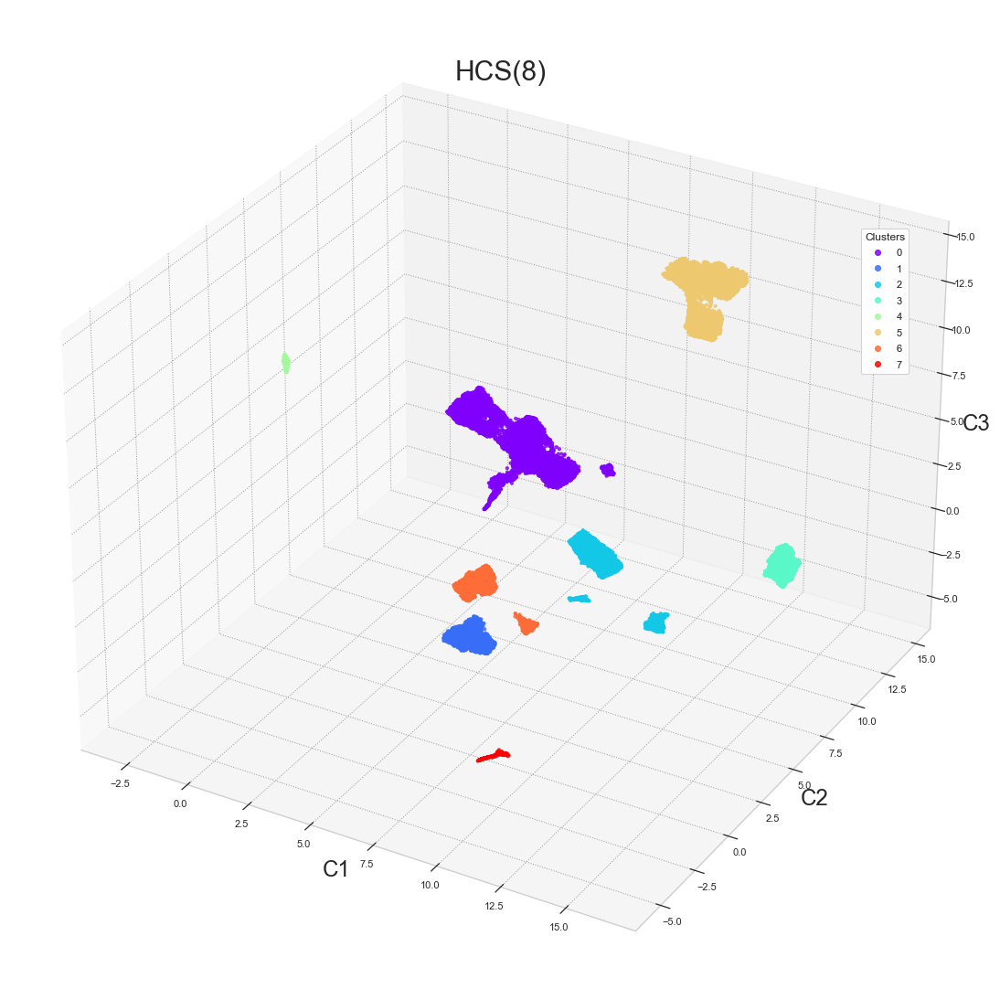

-------------------- HCS(9) --------------------
Model                            HCS(9)
Calinski-Harabasz(Var)    277257.016779
Davies-Bouldin(Sim)            0.338654
Silhouette                     0.715445
Time(s)                       97.116181
hue                              umaped
Name: 948, dtype: object


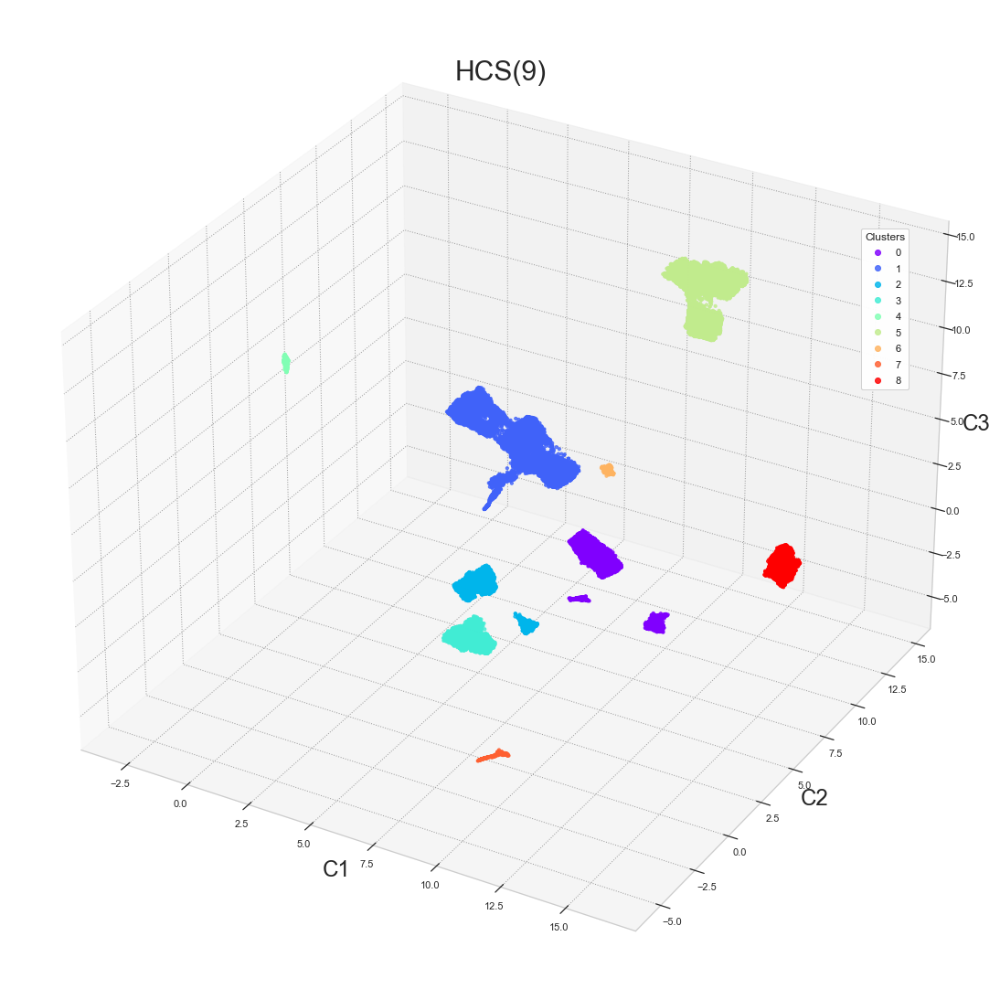

-------------------- HCS(10) --------------------
Model                           HCS(10)
Calinski-Harabasz(Var)    321103.664873
Davies-Bouldin(Sim)              0.3194
Silhouette                     0.734198
Time(s)                       94.576765
hue                              umaped
Name: 949, dtype: object


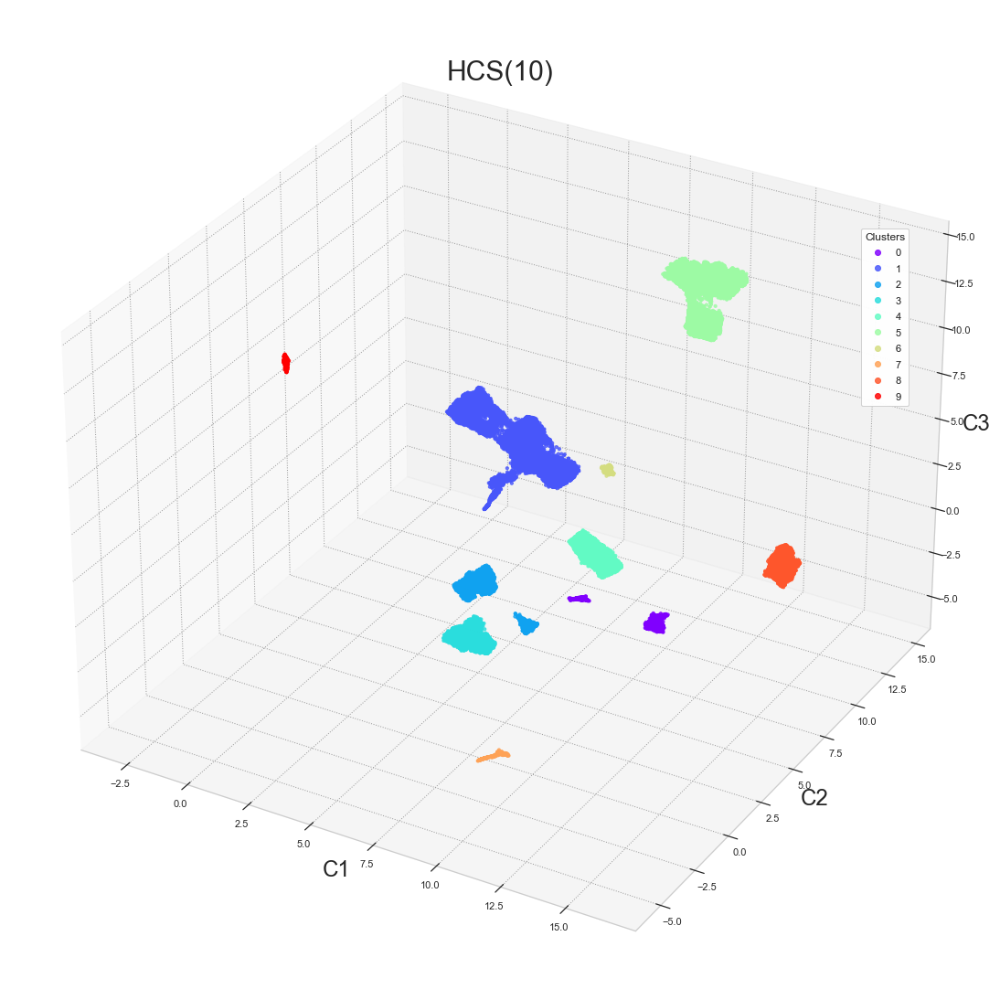

-------------------- HCS(11) --------------------
Model                           HCS(11)
Calinski-Harabasz(Var)    299950.857401
Davies-Bouldin(Sim)            0.259362
Silhouette                      0.73449
Time(s)                      104.515586
hue                              umaped
Name: 950, dtype: object


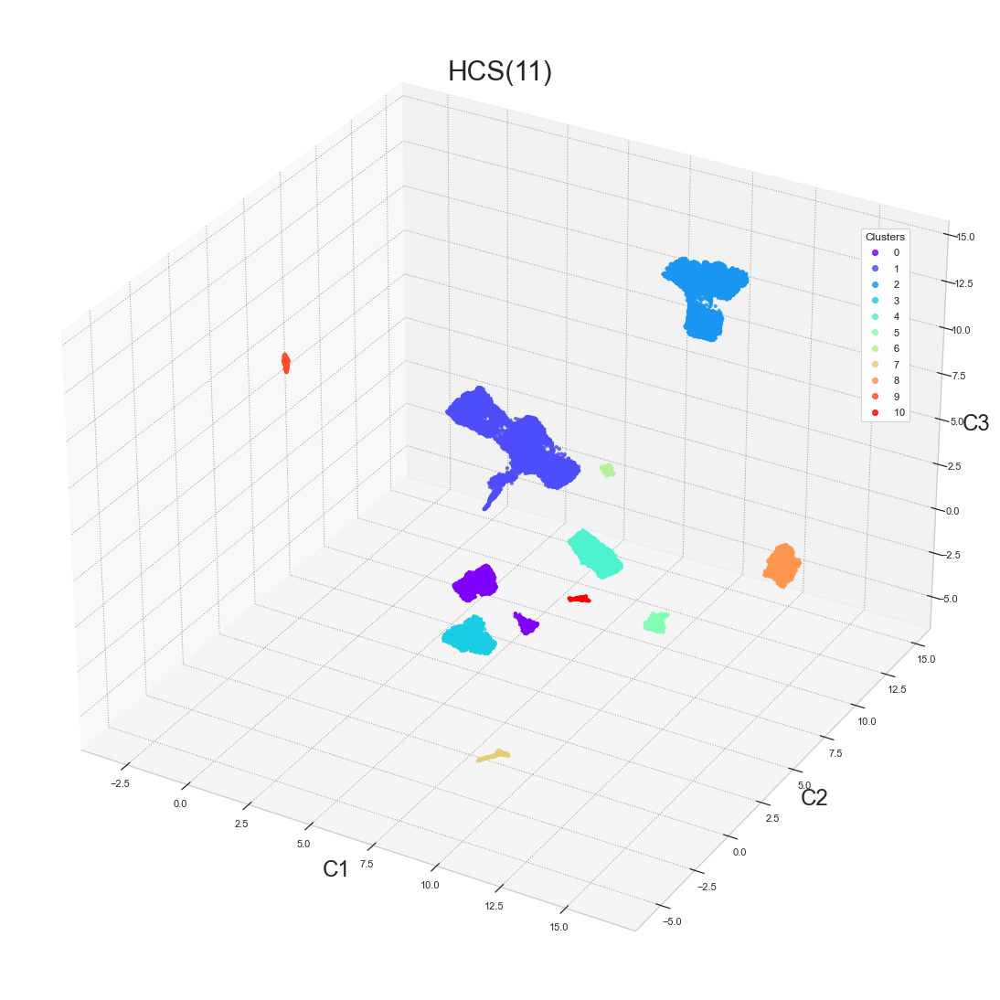

-------------------- HCS(12) --------------------
Model                           HCS(12)
Calinski-Harabasz(Var)    297835.751135
Davies-Bouldin(Sim)            0.235092
Silhouette                     0.742263
Time(s)                       94.448267
hue                              umaped
Name: 951, dtype: object


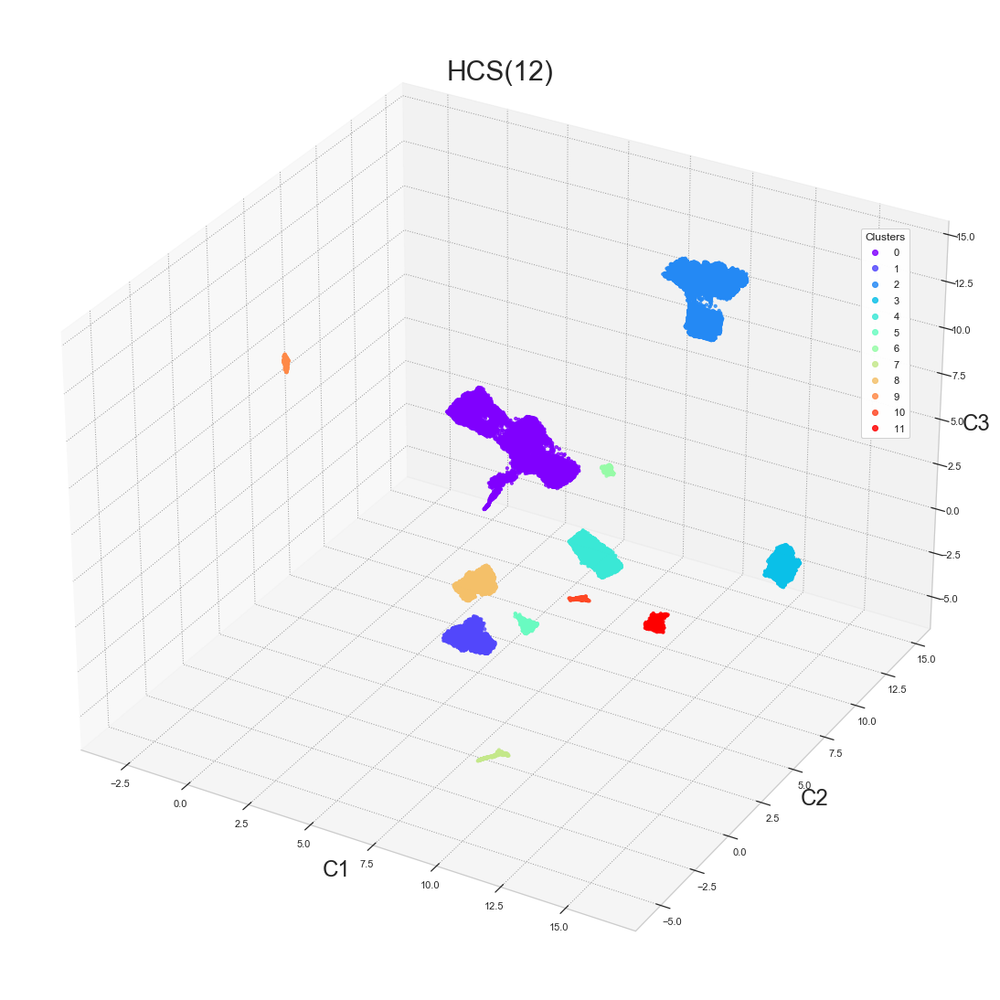

-------------------- HCS(13) --------------------
Model                           HCS(13)
Calinski-Harabasz(Var)    273015.692346
Davies-Bouldin(Sim)            0.398832
Silhouette                     0.525099
Time(s)                       92.025757
hue                              umaped
Name: 952, dtype: object


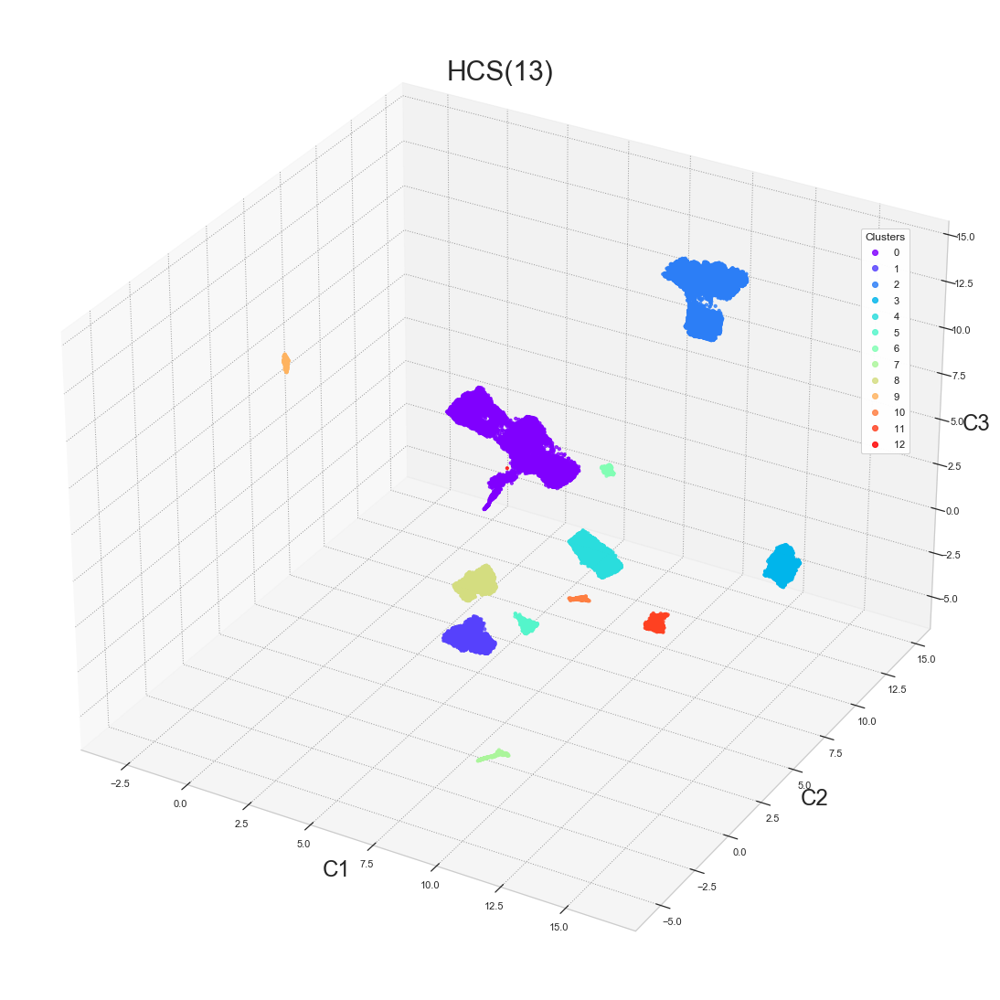

In [57]:
%matplotlib inline
hcs = []
for i in range(n_iter):
    for k in range(kmin, kmax+1):
        cls = clustering(data, AgglomerativeClustering(n_clusters=k, linkage='single'), 'HCS('+str(k)+')', projection, Perfs, scale=scale, scores=scores, hue=hue, display_components=display_components)
        hcs.append(cls)

On compare les scores du clustering par HCS sur la plage des valeurs de k.

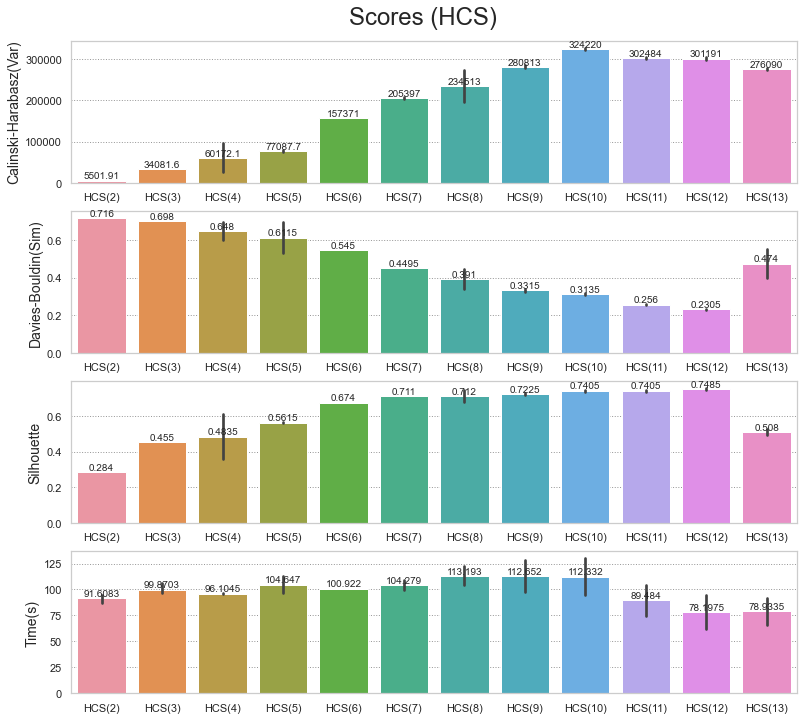

In [70]:
display_scores(Perfs[(Perfs['Model'].str.startswith('HCS')) & (Perfs['hue']=='umaped')], y='HCS', width=13, height =12, rotation=0, hspace=0.2)

<p>Le meilleur compromis des scores est obtenu pour <strong>k=10</strong>, mais on retombe sur le même problème que DBSCAN i.e. le nombre de segments des clients est trop important pour être exploitable par l’équipe marketing.</p>
<p>Le choix le plus pertinent est <strong>k=6</strong>, car grâce à l’affichage précédent des clusters sur la projection des données on constate qu’il donne la meilleure partition minimale, surtout si on considère les cluster <strong>3</strong> et <strong>4</strong> comme des outliers ce qui ramènerait le nombre de segments à 4.</p>


In [124]:
best_models.append('HCS(6)')

## 2.3. KMeans

La prochaine famille d’algorithmes de clustering tente de minimiser l’inertie des clusters de manière successive et donc produire les k clusters les plus resserrés possible sur eux-mêmes.

In [60]:
data = pd.DataFrame(umaped, columns=['C'+str(i) for i in range (1,4)])
scale = 'std'
hue = 'umaped'
# hue = 'df'
display_components=3 # <1 aucun diplay, 3 display 3D, sinon display 2D sur le nombre de composantes choisies
# %matplotlib widget

In [78]:
n_iter = 1
kmin = 2
kmax = 13

### 2.3.1. Basic

La version standard (basique) du KMeanns.

-------------------- KMeans(2) --------------------
Model                        KMeans(2)
Calinski-Harabasz(Var)    76865.075851
Davies-Bouldin(Sim)           1.025141
Silhouette                    0.477181
Time(s)                       1.706897
hue                             umaped
Name: 953, dtype: object


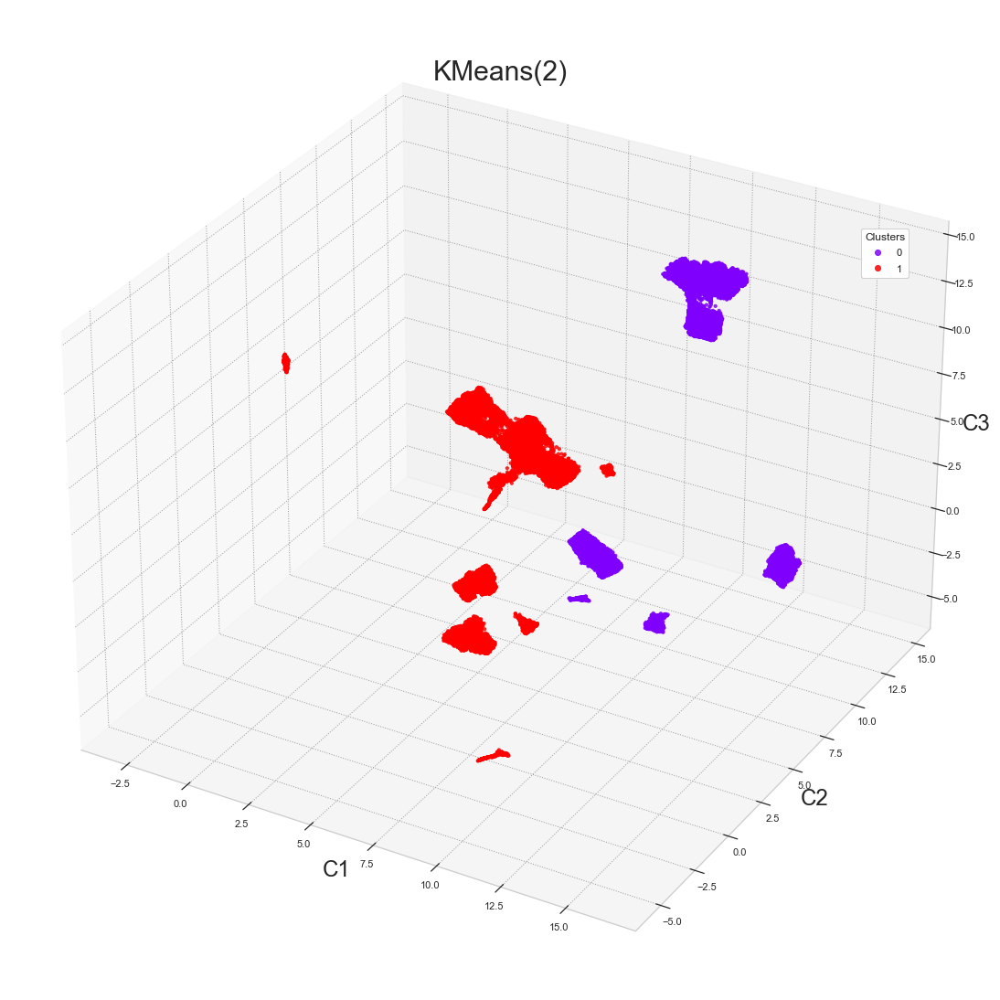

-------------------- KMeans(3) --------------------
Model                         KMeans(3)
Calinski-Harabasz(Var)    117366.622078
Davies-Bouldin(Sim)            0.726198
Silhouette                     0.594956
Time(s)                        0.564036
hue                              umaped
Name: 954, dtype: object


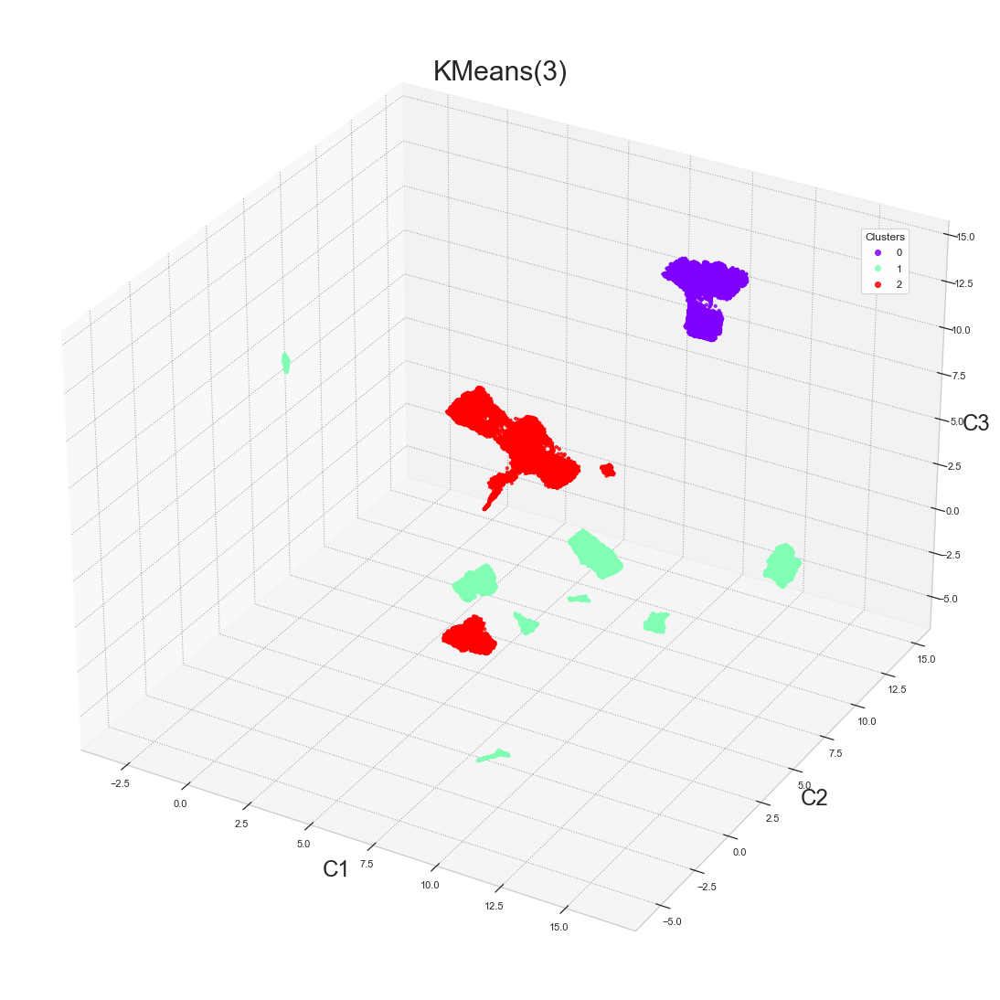

-------------------- KMeans(4) --------------------
Model                        KMeans(4)
Calinski-Harabasz(Var)    139862.13375
Davies-Bouldin(Sim)           0.769382
Silhouette                    0.636364
Time(s)                       0.754379
hue                             umaped
Name: 955, dtype: object


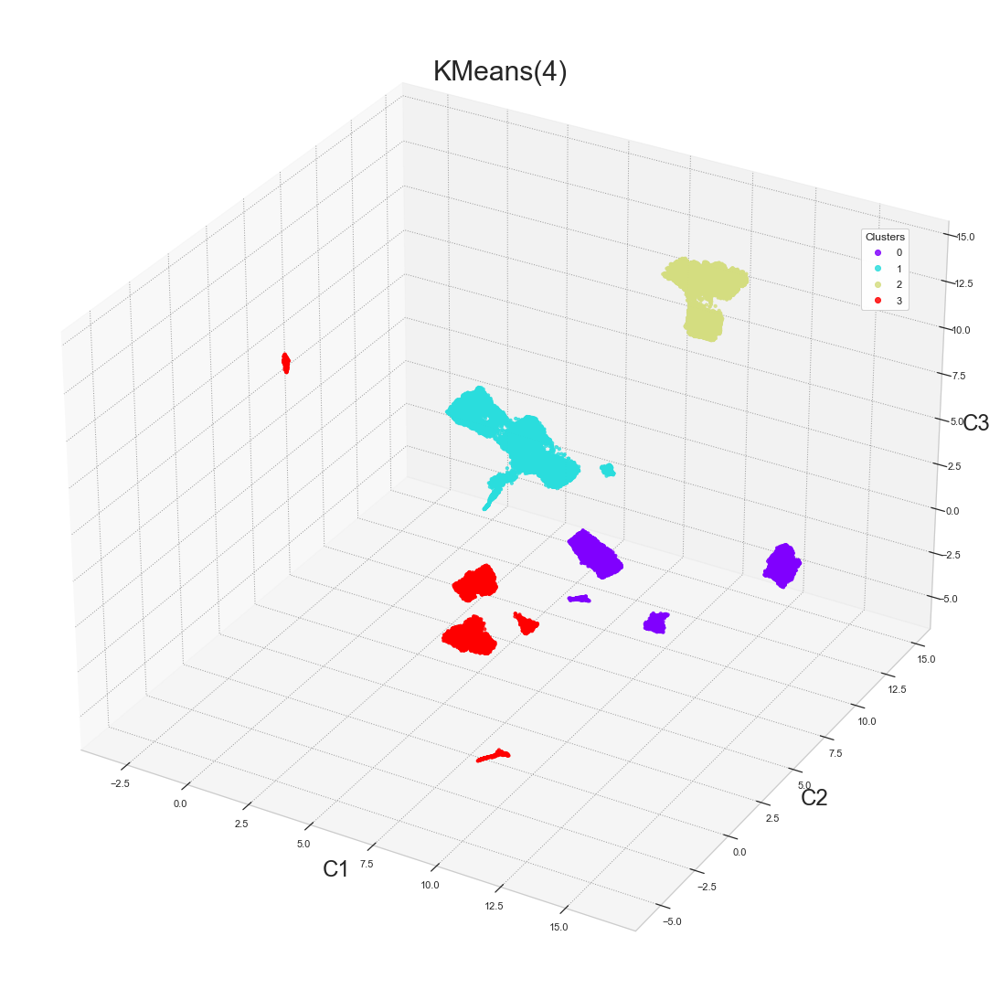

-------------------- KMeans(5) --------------------
Model                         KMeans(5)
Calinski-Harabasz(Var)    176487.886345
Davies-Bouldin(Sim)             0.57894
Silhouette                     0.679977
Time(s)                        0.646201
hue                              umaped
Name: 956, dtype: object


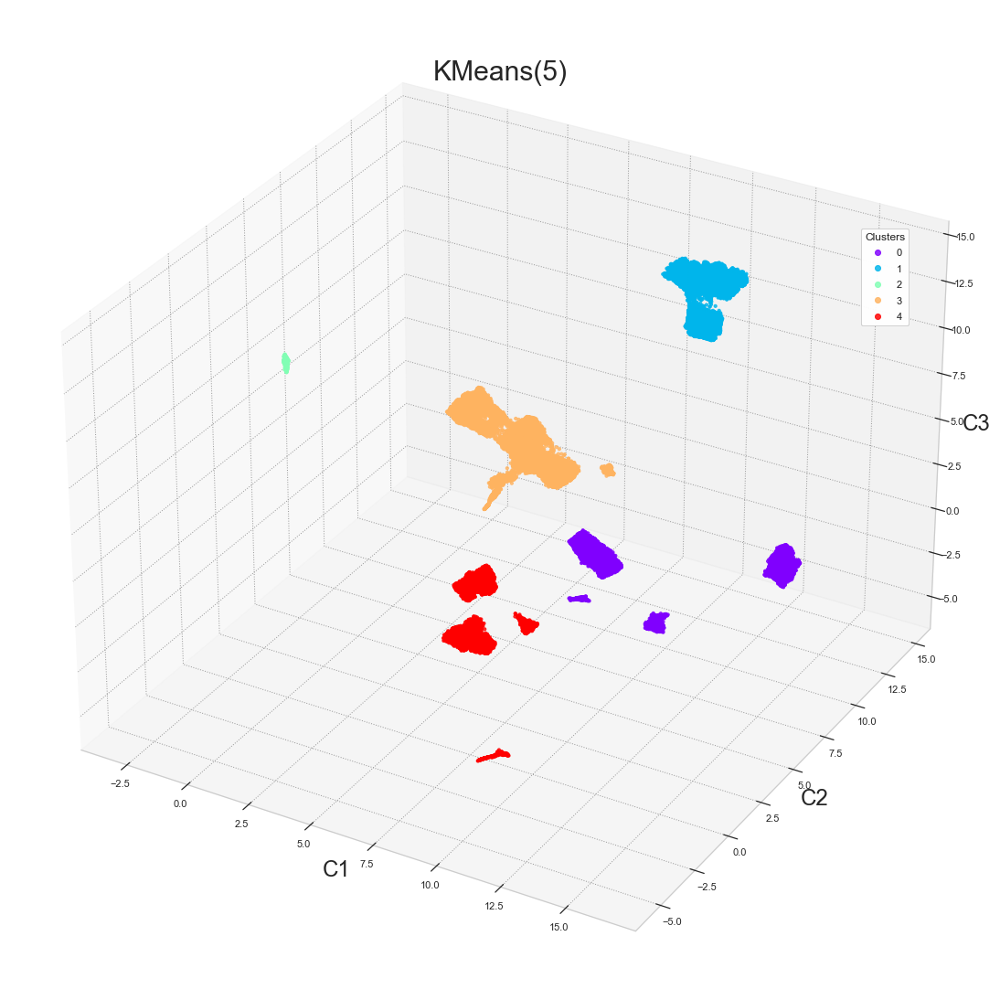

-------------------- KMeans(6) --------------------
Model                         KMeans(6)
Calinski-Harabasz(Var)    157370.534508
Davies-Bouldin(Sim)             0.54531
Silhouette                      0.67409
Time(s)                        0.611656
hue                              umaped
Name: 957, dtype: object


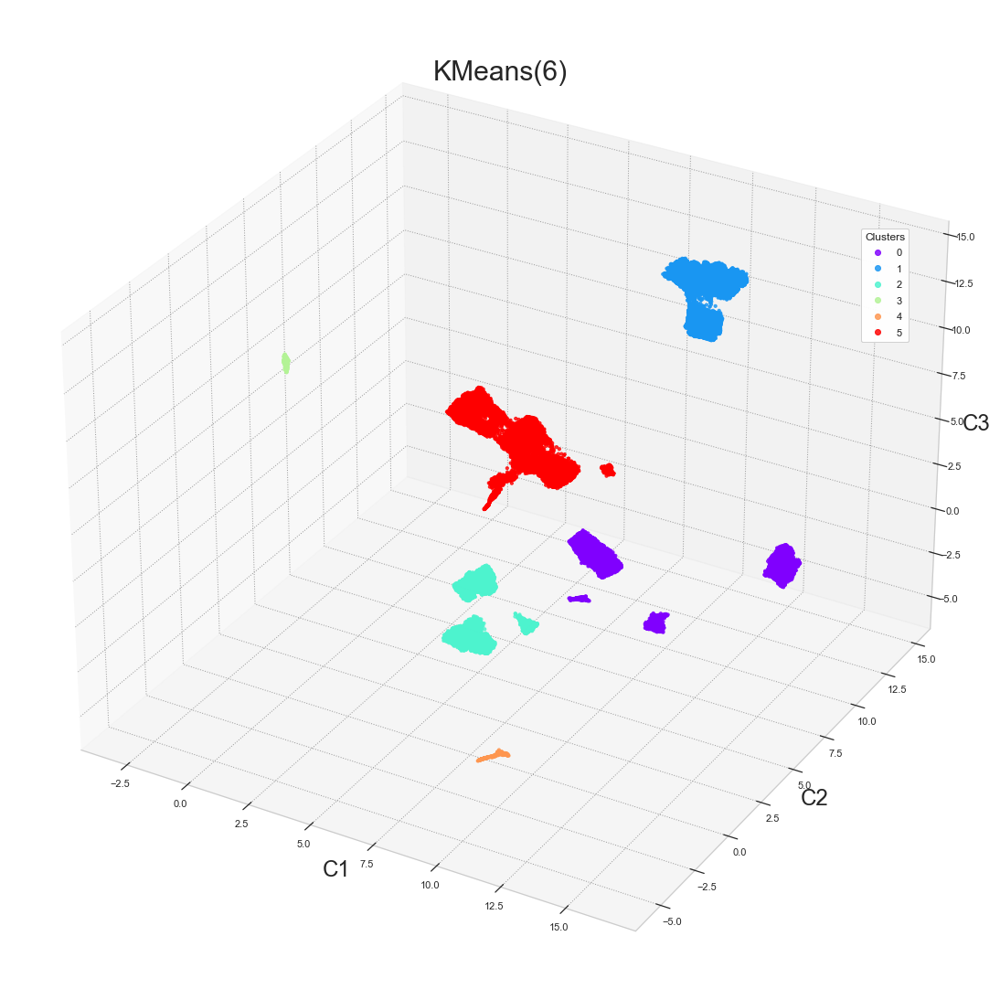

-------------------- KMeans(7) --------------------
Model                         KMeans(7)
Calinski-Harabasz(Var)    197007.291529
Davies-Bouldin(Sim)            0.689393
Silhouette                     0.577195
Time(s)                        0.851742
hue                              umaped
Name: 958, dtype: object


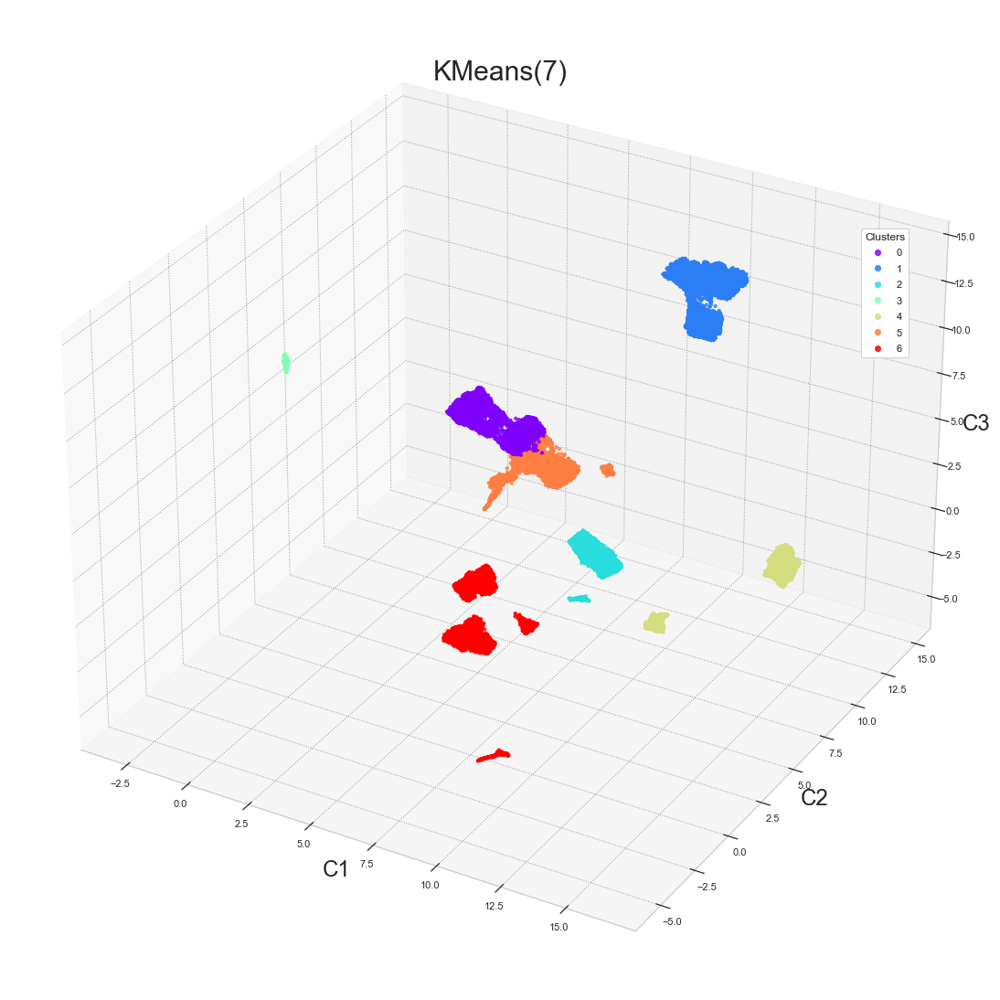

-------------------- KMeans(8) --------------------
Model                         KMeans(8)
Calinski-Harabasz(Var)    267712.860907
Davies-Bouldin(Sim)            0.596928
Silhouette                     0.628645
Time(s)                        0.700192
hue                              umaped
Name: 959, dtype: object


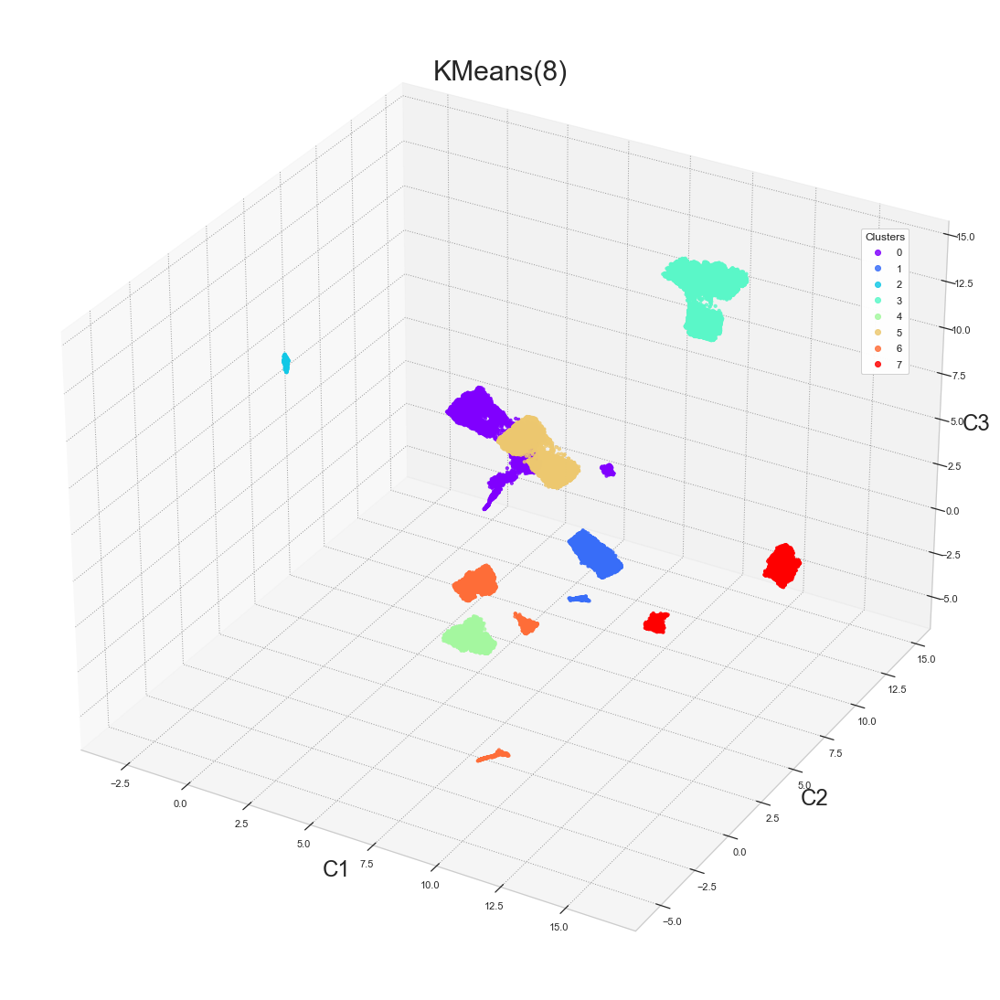

-------------------- KMeans(9) --------------------
Model                         KMeans(9)
Calinski-Harabasz(Var)    269511.179287
Davies-Bouldin(Sim)             0.53768
Silhouette                     0.671802
Time(s)                        1.208515
hue                              umaped
Name: 960, dtype: object


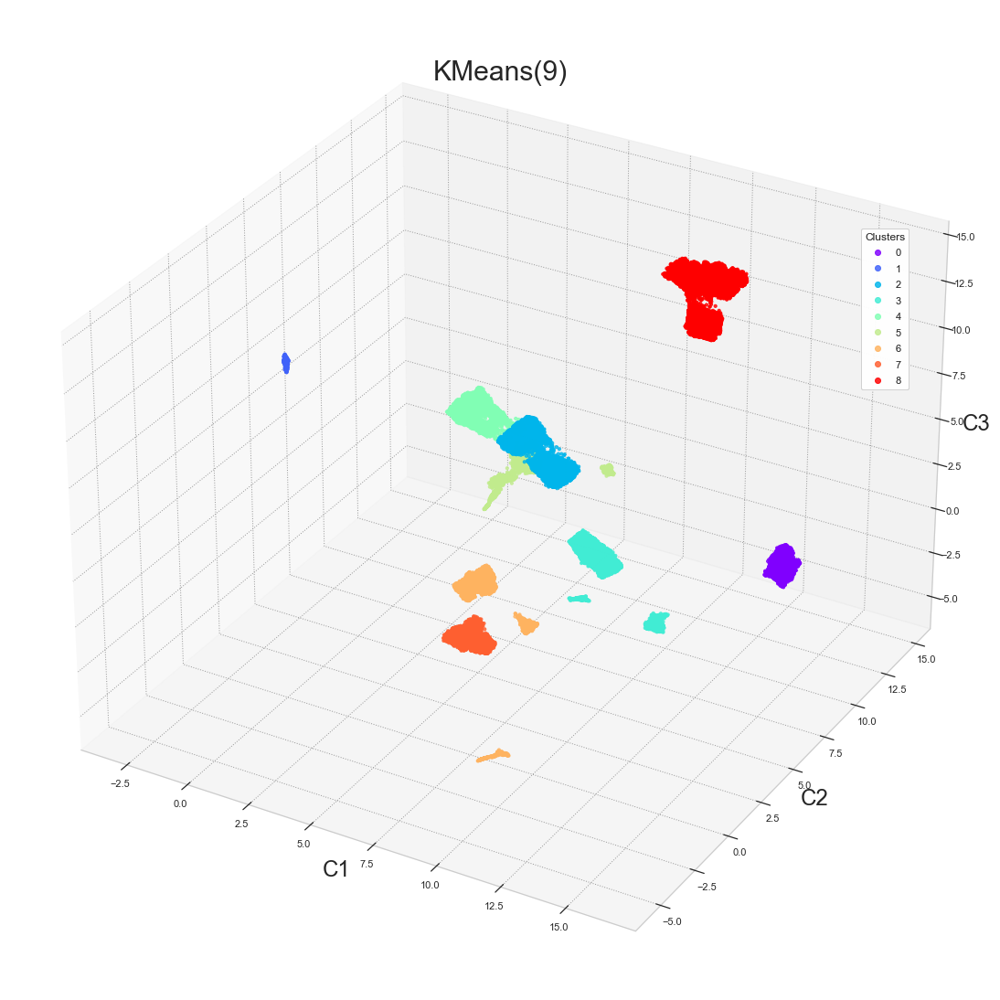

-------------------- KMeans(10) --------------------
Model                        KMeans(10)
Calinski-Harabasz(Var)    312842.707107
Davies-Bouldin(Sim)            0.636675
Silhouette                     0.570659
Time(s)                        1.172057
hue                              umaped
Name: 961, dtype: object


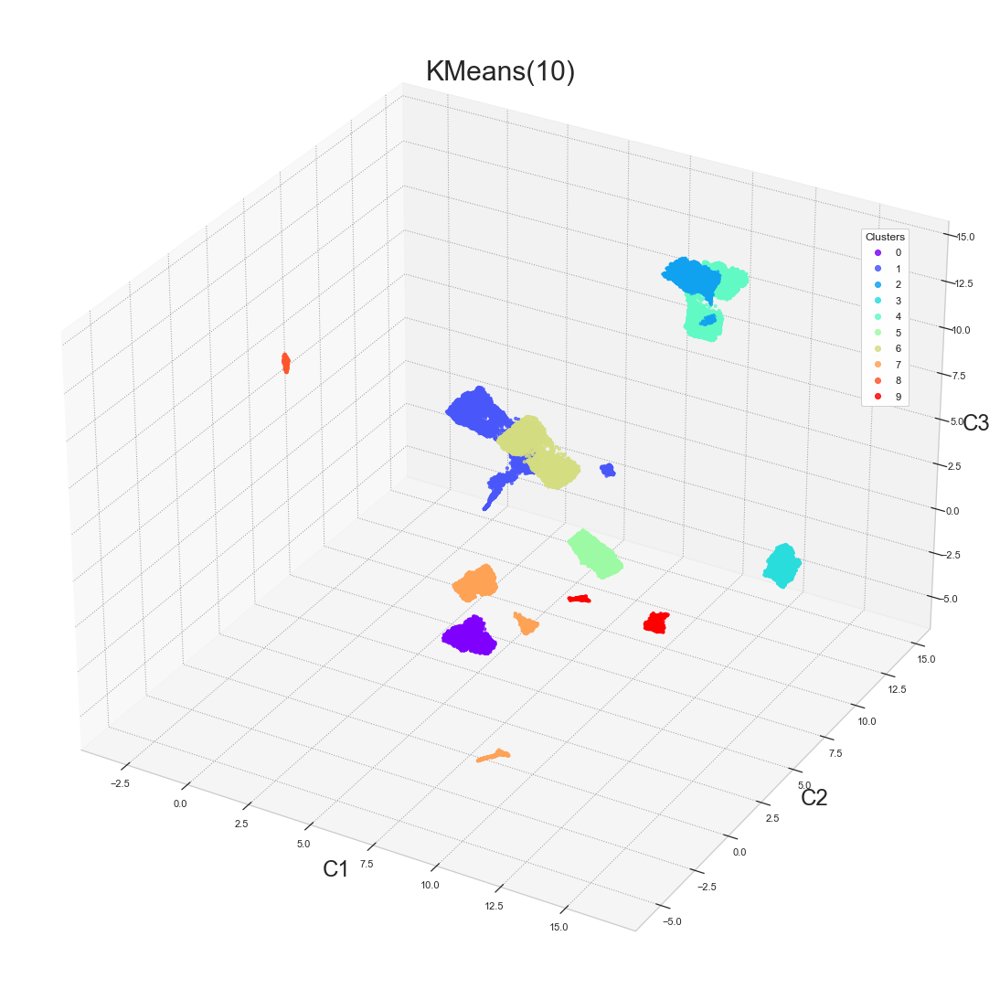

-------------------- KMeans(11) --------------------
Model                        KMeans(11)
Calinski-Harabasz(Var)    383432.596613
Davies-Bouldin(Sim)             0.54628
Silhouette                     0.593327
Time(s)                        0.897078
hue                              umaped
Name: 962, dtype: object


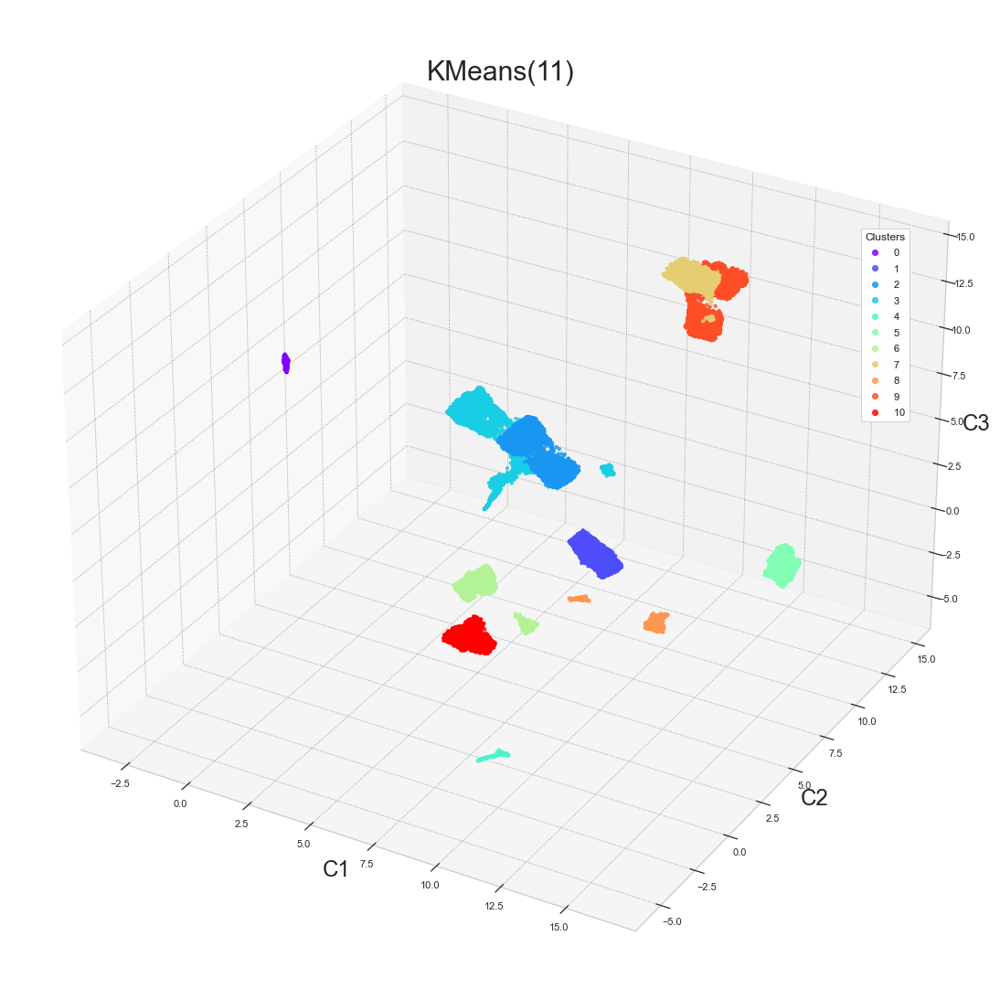

-------------------- KMeans(12) --------------------
Model                        KMeans(12)
Calinski-Harabasz(Var)    278436.818967
Davies-Bouldin(Sim)            0.707477
Silhouette                     0.552168
Time(s)                        2.424522
hue                              umaped
Name: 963, dtype: object


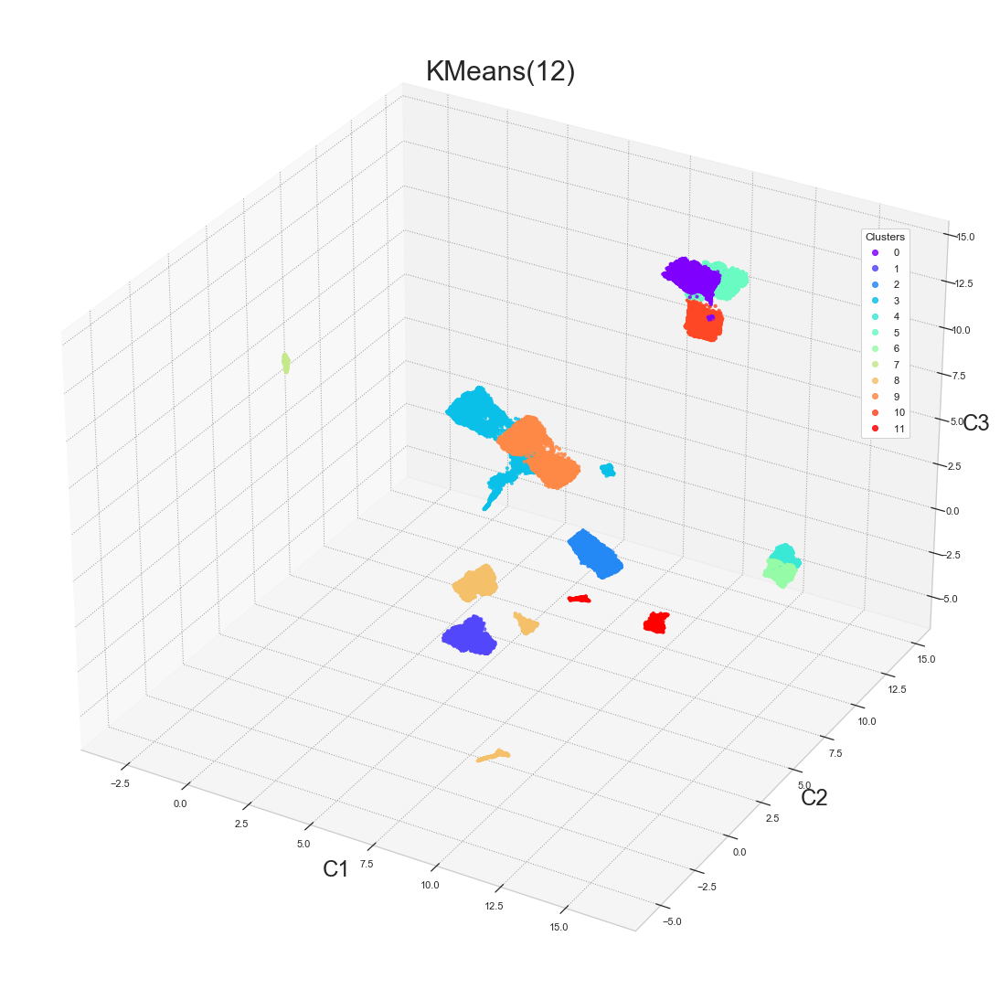

-------------------- KMeans(13) --------------------
Model                        KMeans(13)
Calinski-Harabasz(Var)    260794.473422
Davies-Bouldin(Sim)            0.566041
Silhouette                     0.530882
Time(s)                        0.958021
hue                              umaped
Name: 964, dtype: object


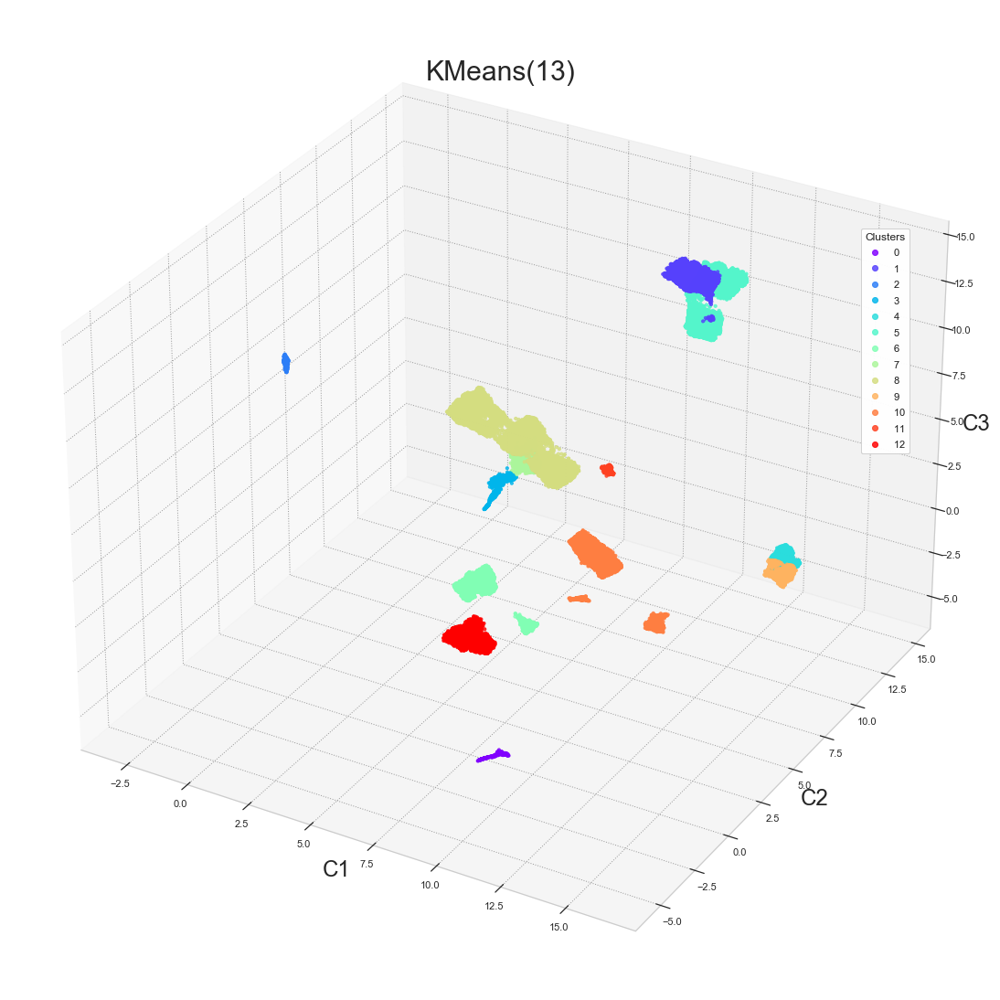

In [62]:
kmeans = []
for i in range(n_iter):
    for k in range(kmin, kmax+1):
        cls = clustering(data, KMeans(n_clusters=k, random_state=None, init='random'), 'KMeans('+str(k)+')', projection, Perfs, scale=scale, scores=scores, hue=hue, display_components=display_components)
        kmeans.append(cls)

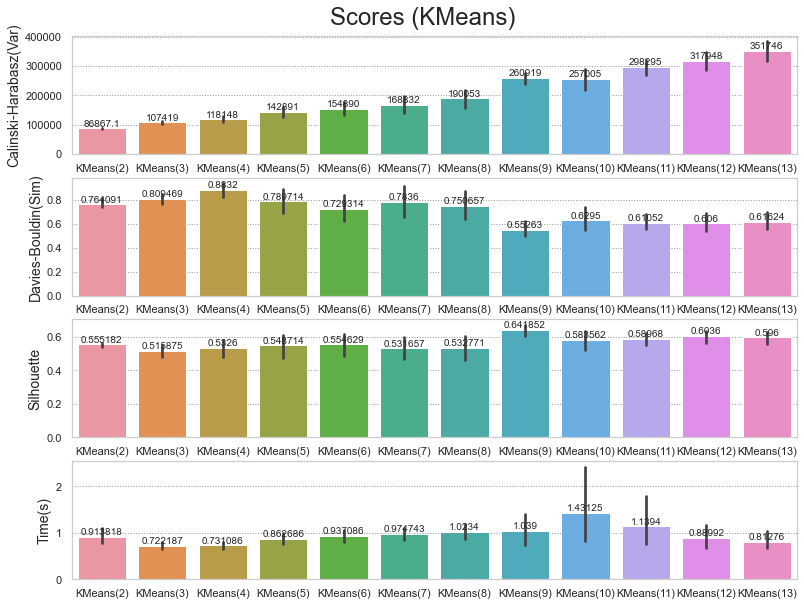

In [79]:
display_scores(Perfs[Perfs['Model'].str.startswith('KMeans(')], y='KMeans', width=13, height =10, rotation=0, hspace=0.2)

Comme précédemment, les scores du clustering favorisent un k élevé, mais selon les projections <strong>k=4</strong> donne la meilleure partition et ce en intégrant les clusters outliers (les plus éloignés) sont intégrés au cluster le plus proche (3).

In [125]:
best_models.append('KMeans(4)')

### 2.3.2. KMeans++ 

Cette variante du KMeans essaie de palier à l’inconvénient du KMeans basique : différentes exécutions peuvent mener à différentes partitions à cause du choix aléatoire des centroïdes initiaux (instabilité). Cela en lançant l’algorithme plusieurs fois l’algorithme, avant l’exécution principale (pré-clustering), pour converger vers des centroïdes initiaux donnant une partition plus stable.

-------------------- KMeans++(2) --------------------
Model                      KMeans++(2)
Calinski-Harabasz(Var)    76865.075851
Davies-Bouldin(Sim)           1.025141
Silhouette                    0.477181
Time(s)                       0.886585
hue                             umaped
Name: 965, dtype: object


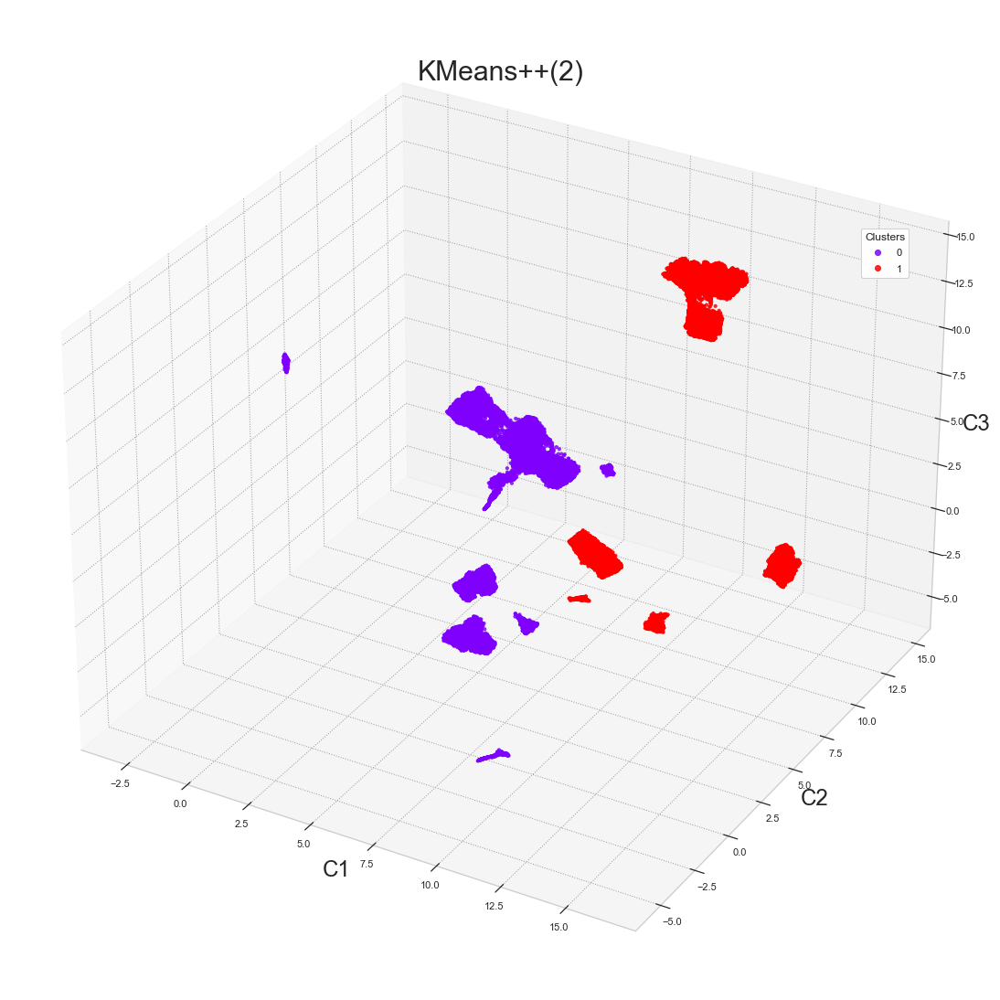

-------------------- KMeans++(3) --------------------
Model                       KMeans++(3)
Calinski-Harabasz(Var)    117366.622078
Davies-Bouldin(Sim)            0.726198
Silhouette                     0.594956
Time(s)                        1.132841
hue                              umaped
Name: 966, dtype: object


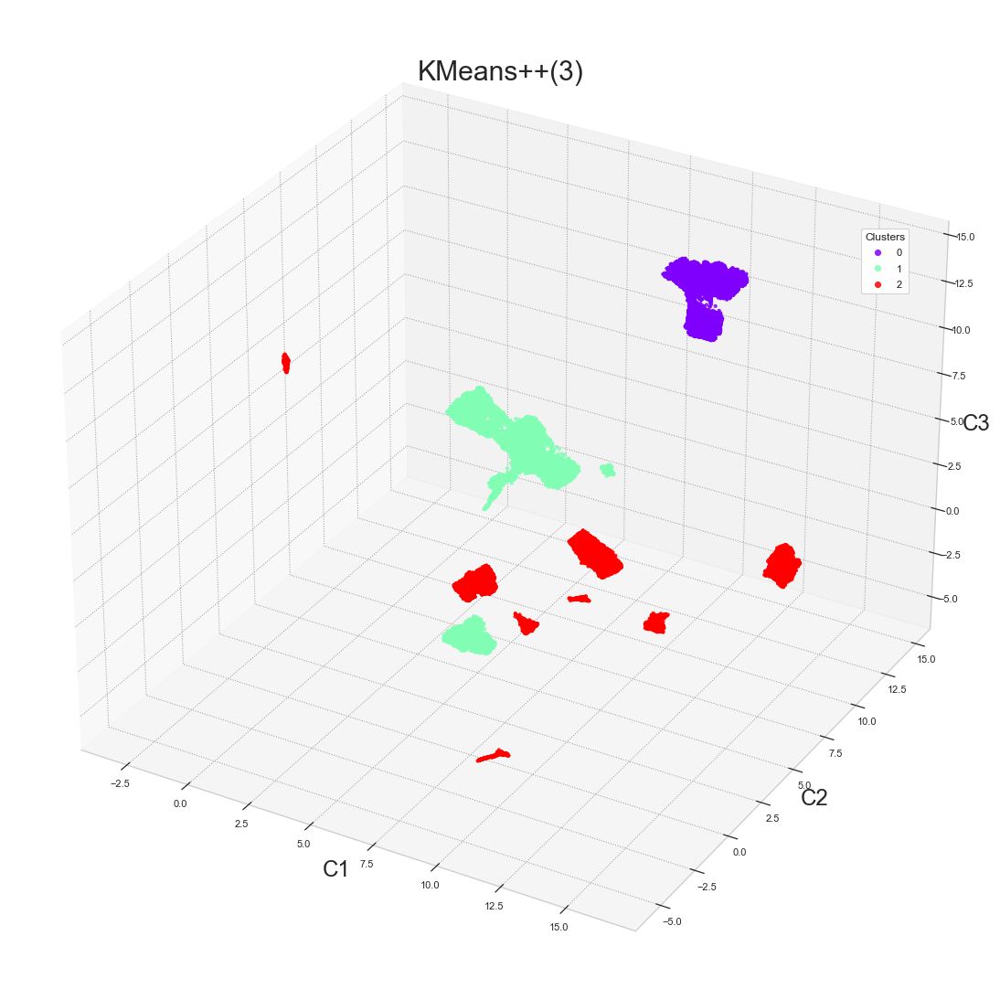

-------------------- KMeans++(4) --------------------
Model                      KMeans++(4)
Calinski-Harabasz(Var)    139862.13375
Davies-Bouldin(Sim)           0.769382
Silhouette                    0.636364
Time(s)                       1.826035
hue                             umaped
Name: 967, dtype: object


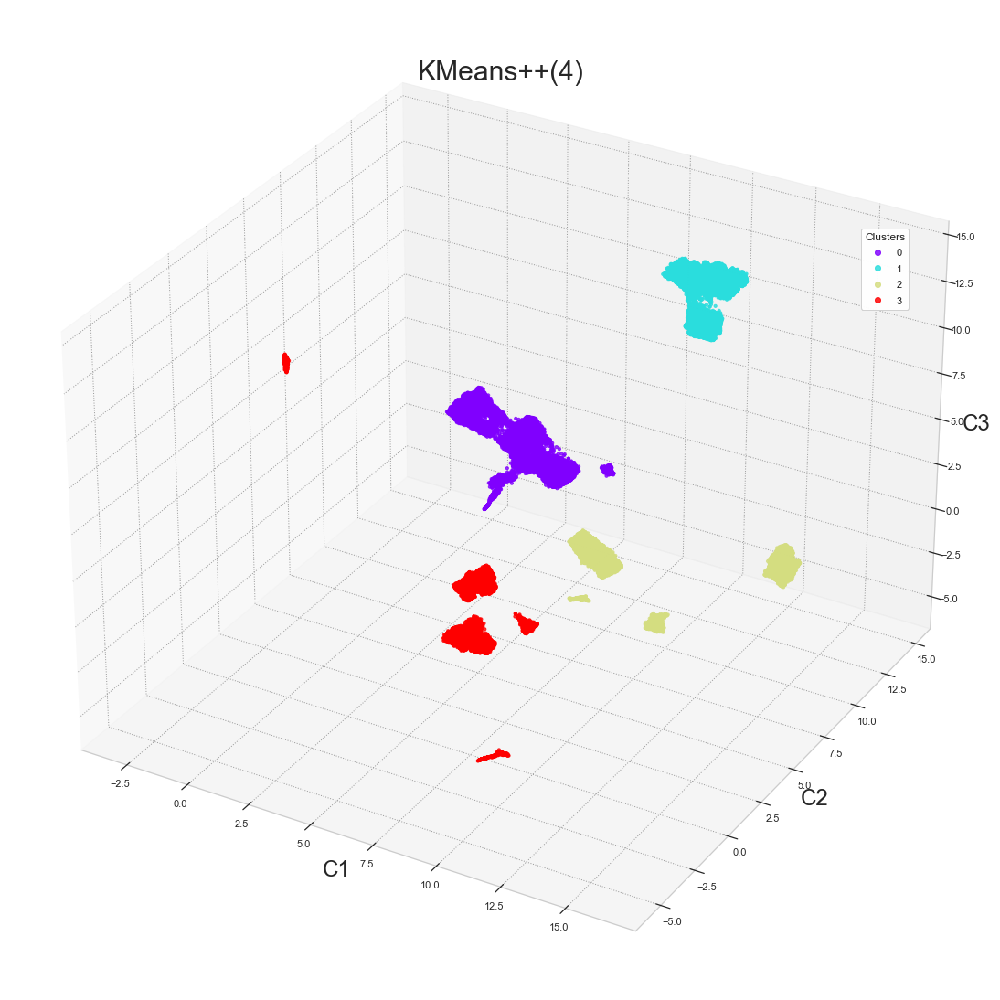

-------------------- KMeans++(5) --------------------
Model                       KMeans++(5)
Calinski-Harabasz(Var)    176487.886345
Davies-Bouldin(Sim)             0.57894
Silhouette                     0.679977
Time(s)                        1.647914
hue                              umaped
Name: 968, dtype: object


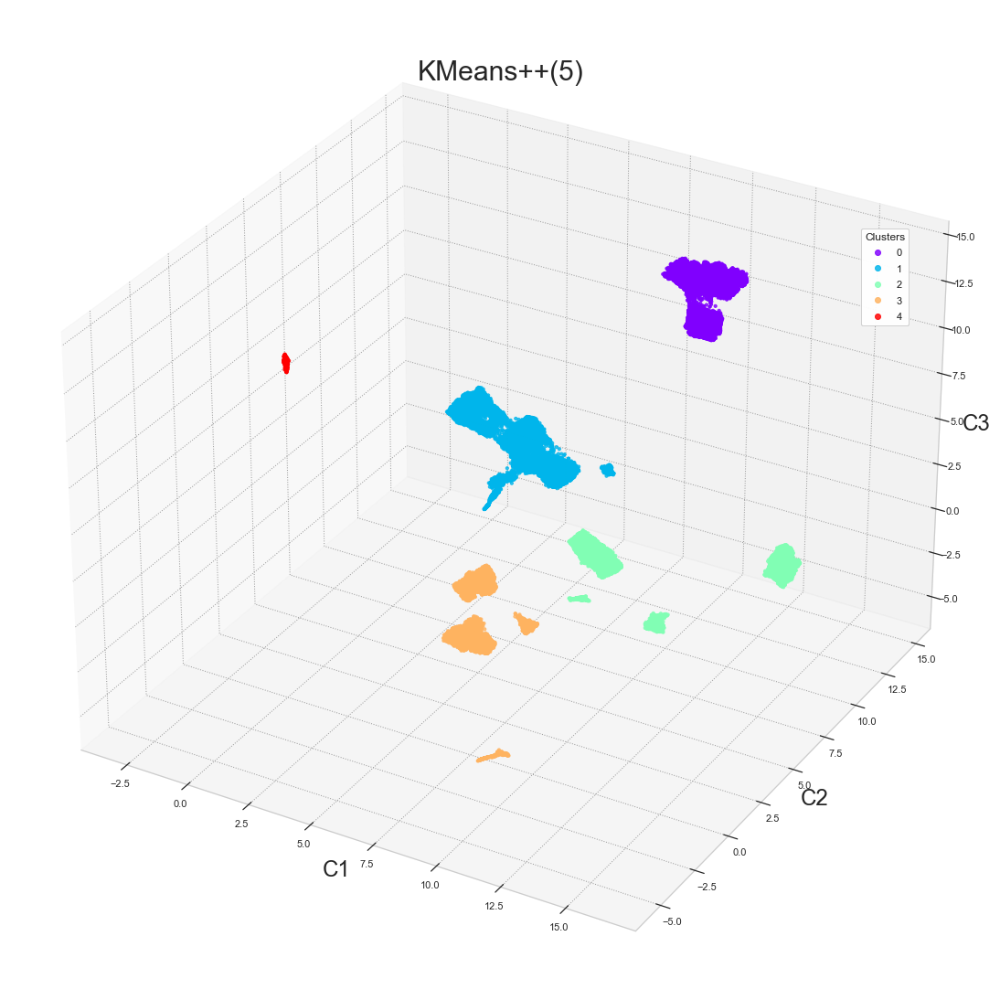

-------------------- KMeans++(6) --------------------
Model                       KMeans++(6)
Calinski-Harabasz(Var)    214198.094802
Davies-Bouldin(Sim)            0.467263
Silhouette                     0.704369
Time(s)                        2.115783
hue                              umaped
Name: 969, dtype: object


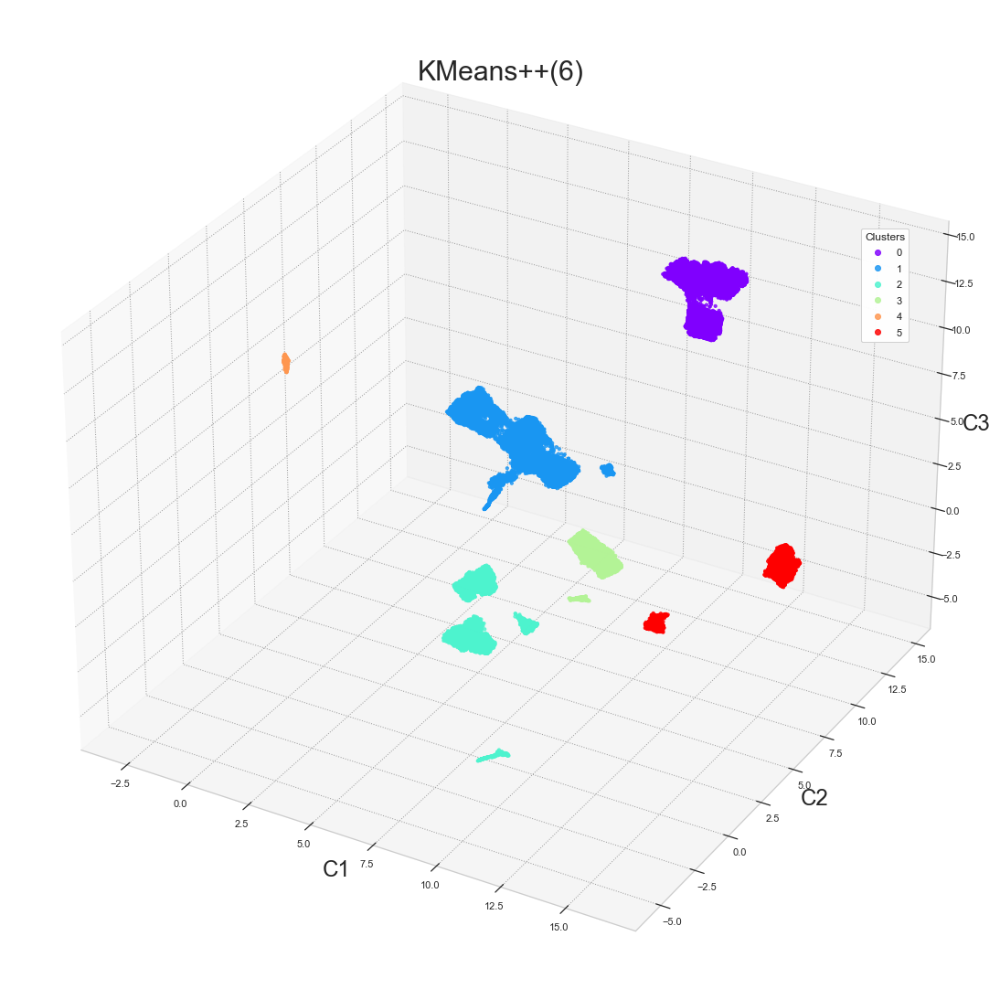

-------------------- KMeans++(7) --------------------
Model                       KMeans++(7)
Calinski-Harabasz(Var)    269711.001582
Davies-Bouldin(Sim)            0.405589
Silhouette                      0.72806
Time(s)                        2.074177
hue                              umaped
Name: 970, dtype: object


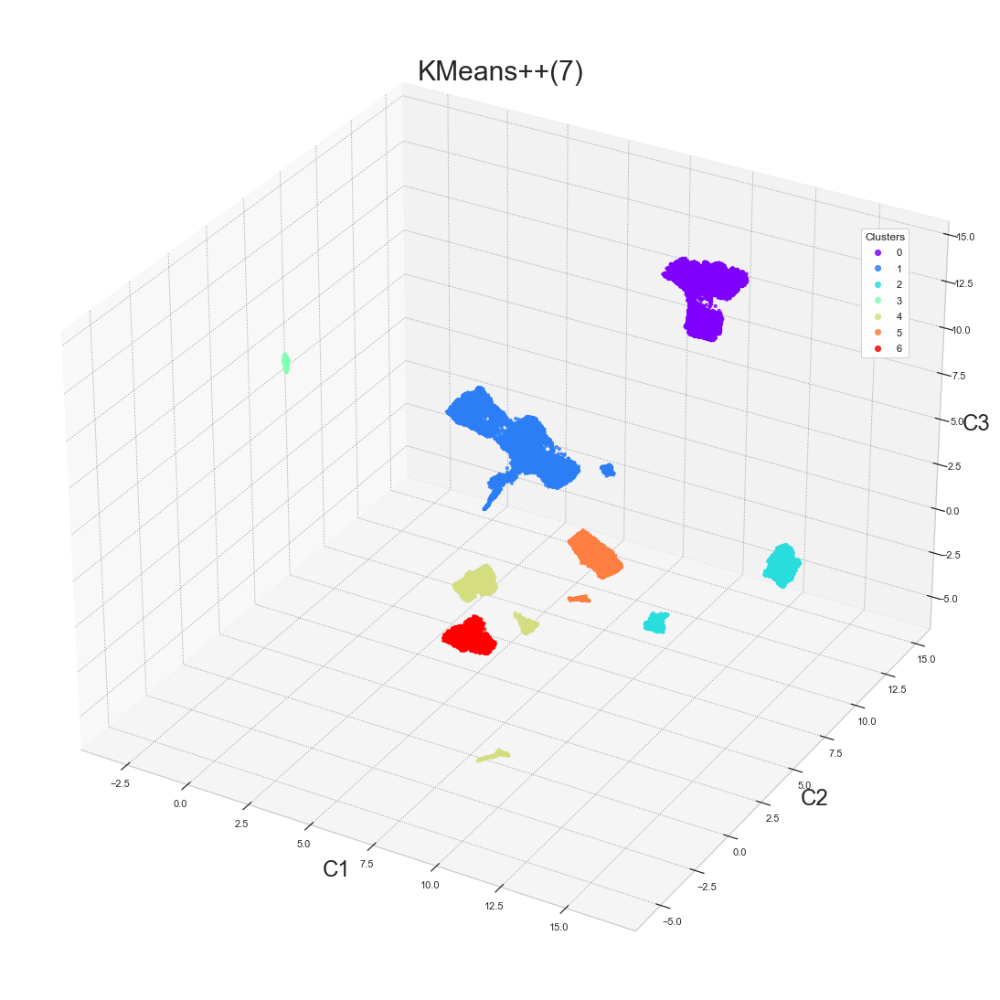

-------------------- KMeans++(8) --------------------
Model                       KMeans++(8)
Calinski-Harabasz(Var)    279048.353526
Davies-Bouldin(Sim)            0.412386
Silhouette                     0.742516
Time(s)                        1.820293
hue                              umaped
Name: 971, dtype: object


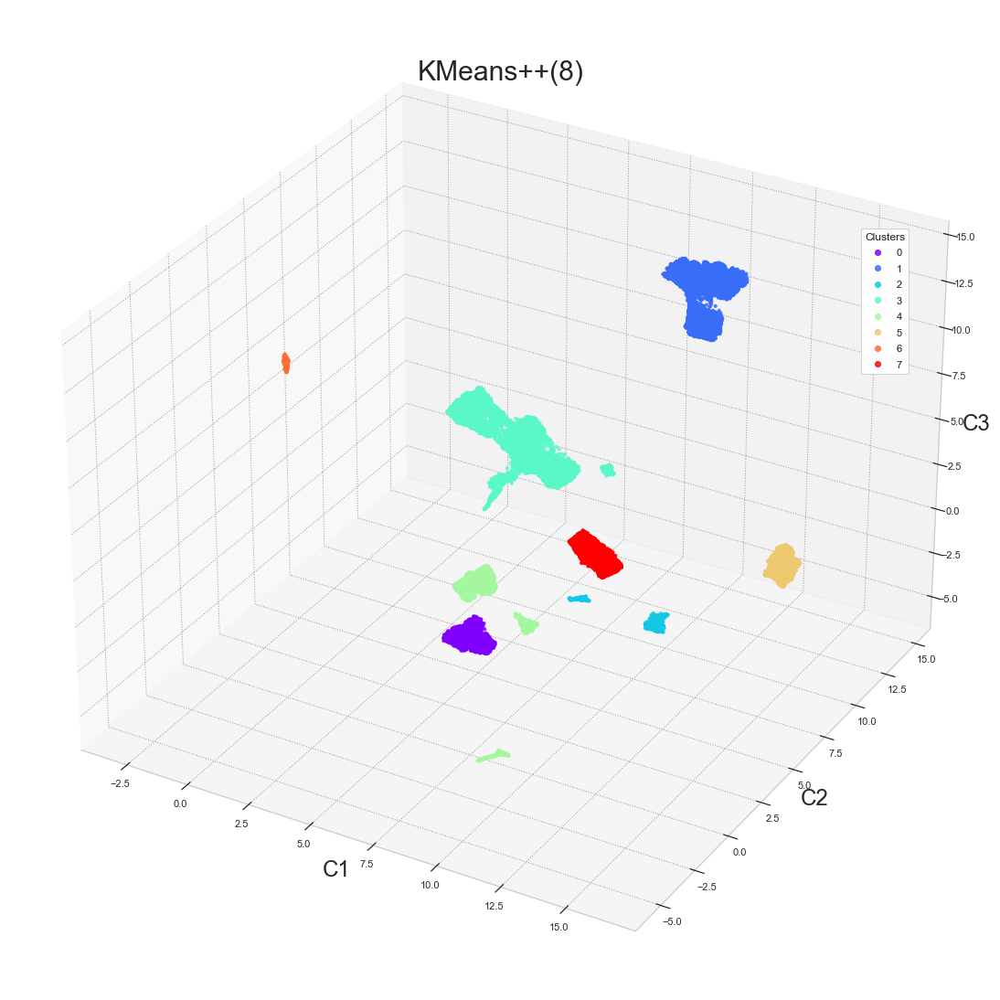

-------------------- KMeans++(9) --------------------
Model                       KMeans++(9)
Calinski-Harabasz(Var)    292803.956182
Davies-Bouldin(Sim)            0.550729
Silhouette                     0.657429
Time(s)                        2.739317
hue                              umaped
Name: 972, dtype: object


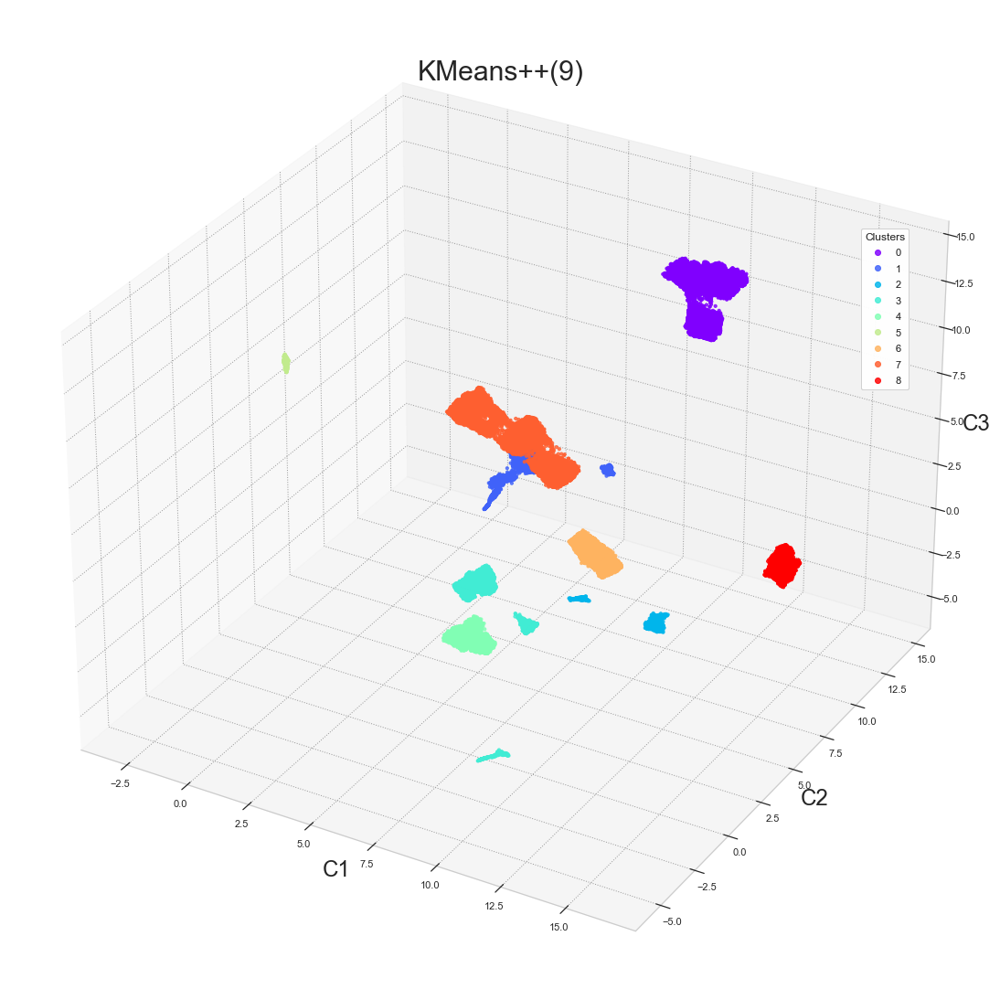

-------------------- KMeans++(10) --------------------
Model                      KMeans++(10)
Calinski-Harabasz(Var)    335306.961909
Davies-Bouldin(Sim)            0.457853
Silhouette                     0.679778
Time(s)                         2.99602
hue                              umaped
Name: 973, dtype: object


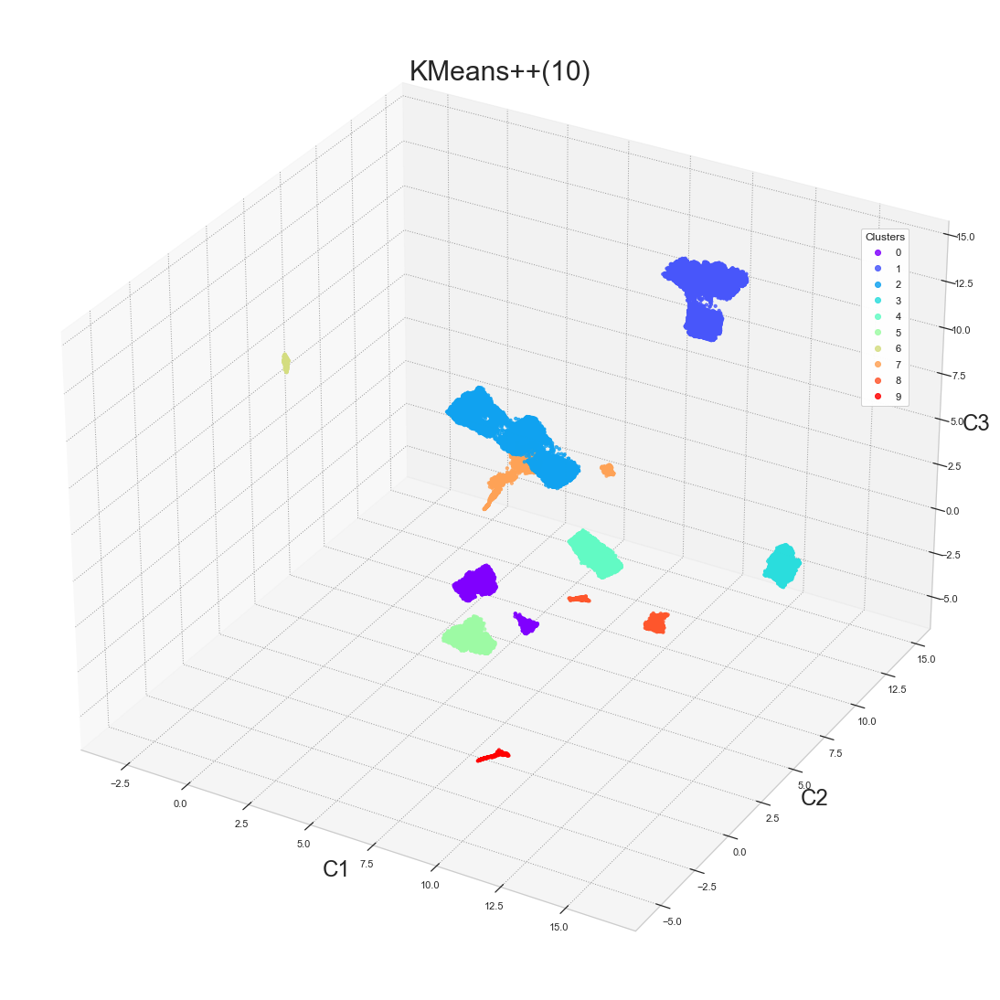

-------------------- KMeans++(11) --------------------
Model                     KMeans++(11)
Calinski-Harabasz(Var)    386626.64653
Davies-Bouldin(Sim)           0.519981
Silhouette                    0.607406
Time(s)                       3.107228
hue                             umaped
Name: 974, dtype: object


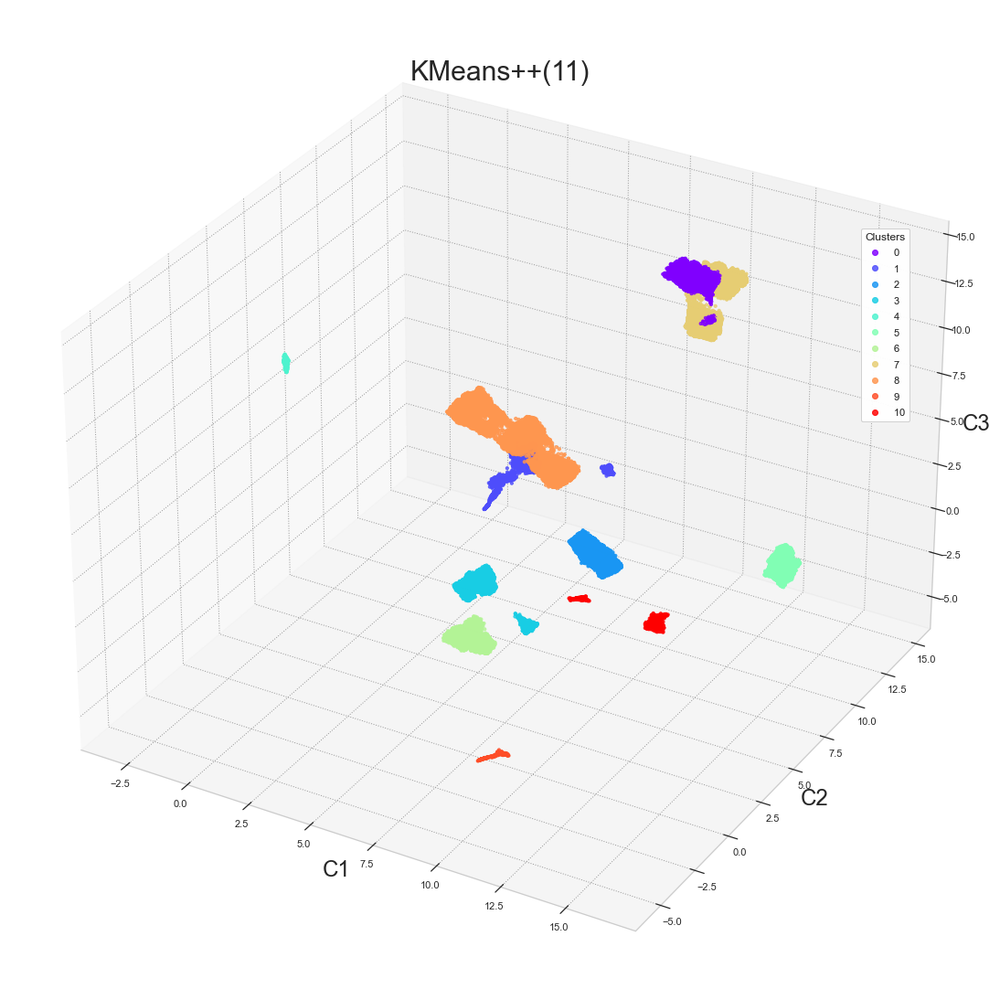

-------------------- KMeans++(12) --------------------
Model                      KMeans++(12)
Calinski-Harabasz(Var)    472354.143129
Davies-Bouldin(Sim)             0.49457
Silhouette                     0.637491
Time(s)                        4.032005
hue                              umaped
Name: 975, dtype: object


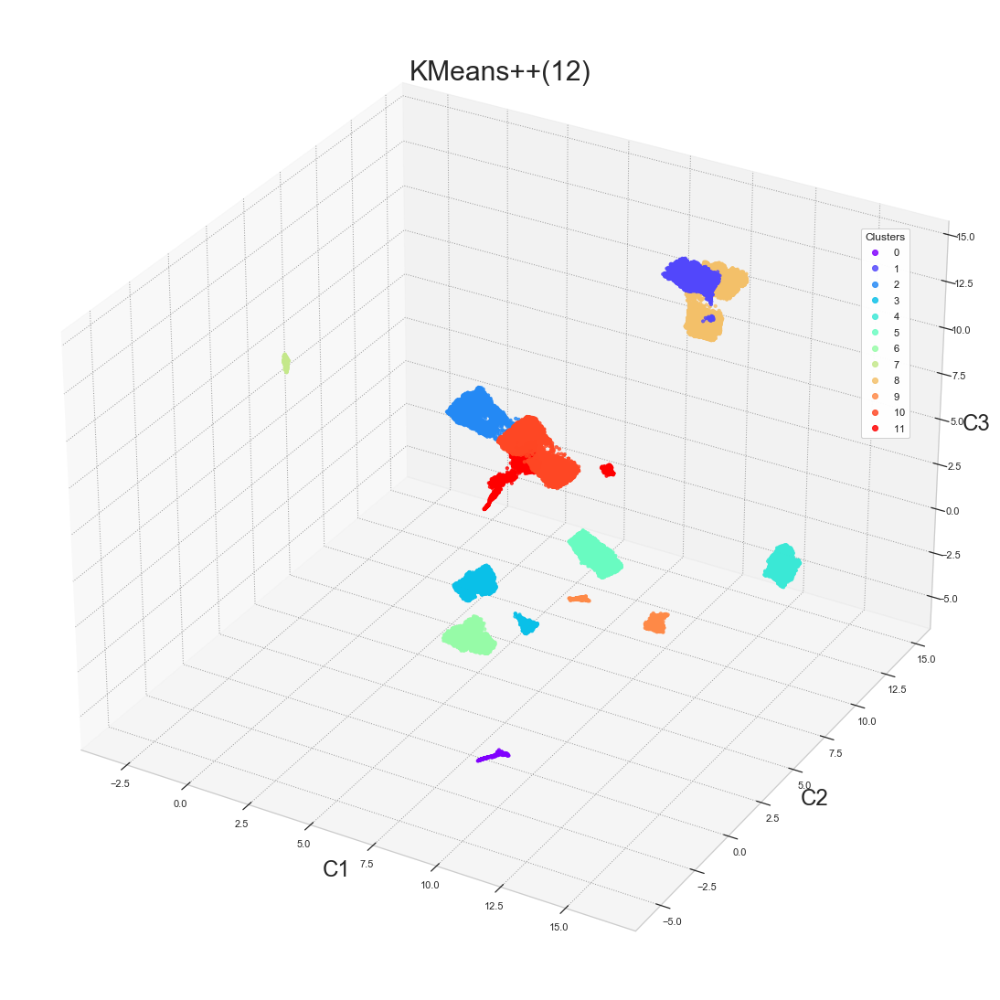

-------------------- KMeans++(13) --------------------
Model                      KMeans++(13)
Calinski-Harabasz(Var)    504665.101493
Davies-Bouldin(Sim)            0.466925
Silhouette                     0.641483
Time(s)                        4.400207
hue                              umaped
Name: 976, dtype: object


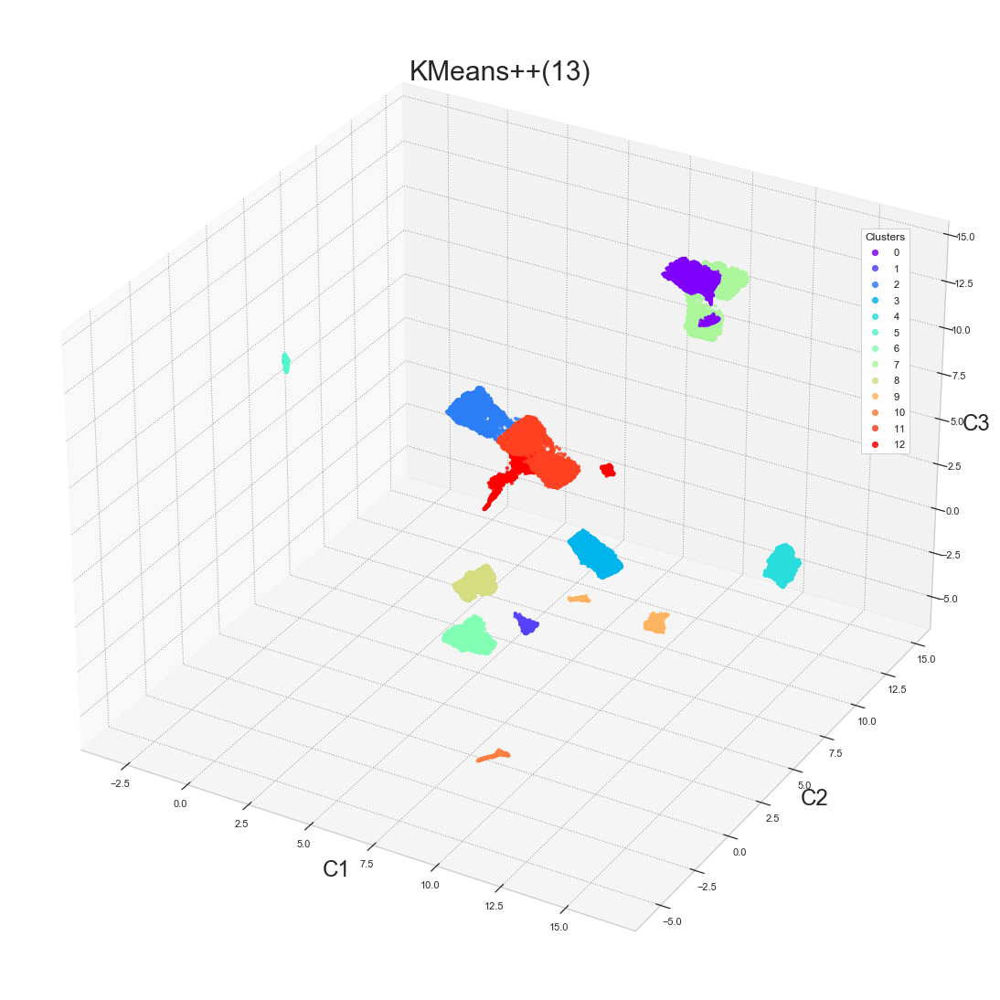

In [64]:
kmeans_pp = []
for i in range(n_iter):
    for k in range(kmin, kmax+1):
        cls = clustering(data, KMeans(n_clusters=k, random_state=None, init='k-means++'), 'KMeans++('+str(k)+')', projection, Perfs, scale=scale, scores=scores, hue=hue, display_components=display_components)
        kmeans_pp.append(cls)

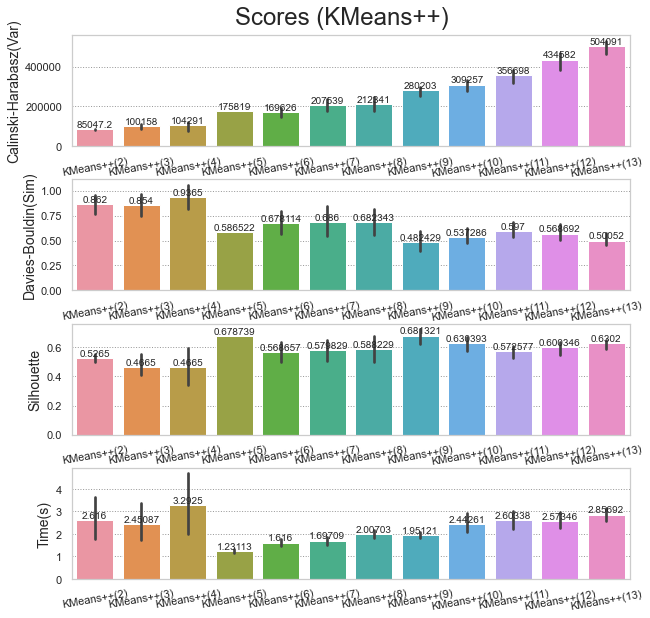

In [118]:
display_scores(Perfs[Perfs['Model'].str.startswith('KMeans++')], y='KMeans++', width=10, height =10, rotation=10, hspace=0.3)

L’interprétation des résultats est similaire à KMeans, sauf que maintenant on a une confiance plus forte due à la plus forte stabilité du KMeans++.  Cette stabilité sera évaluée dans la troisième partie de ce notebook.

In [126]:
best_models.append('KMeans++(4)')

### 2.3.3. MiniBatchKMeans(++)

Cette variante du KMeans(++), les données non plus individuellement mais par petits lots (mini batches), ce qui permet d’obtenir des résultats presque aussi bien que le KMeans(++) mais avec une meilleure complexité temporelle.

-------------------- MiniBatchKMeans(2) --------------------
Model                     MiniBatchKMeans(2)
Calinski-Harabasz(Var)          76865.075851
Davies-Bouldin(Sim)                 1.025141
Silhouette                          0.477181
Time(s)                             0.332769
hue                                   umaped
Name: 978, dtype: object


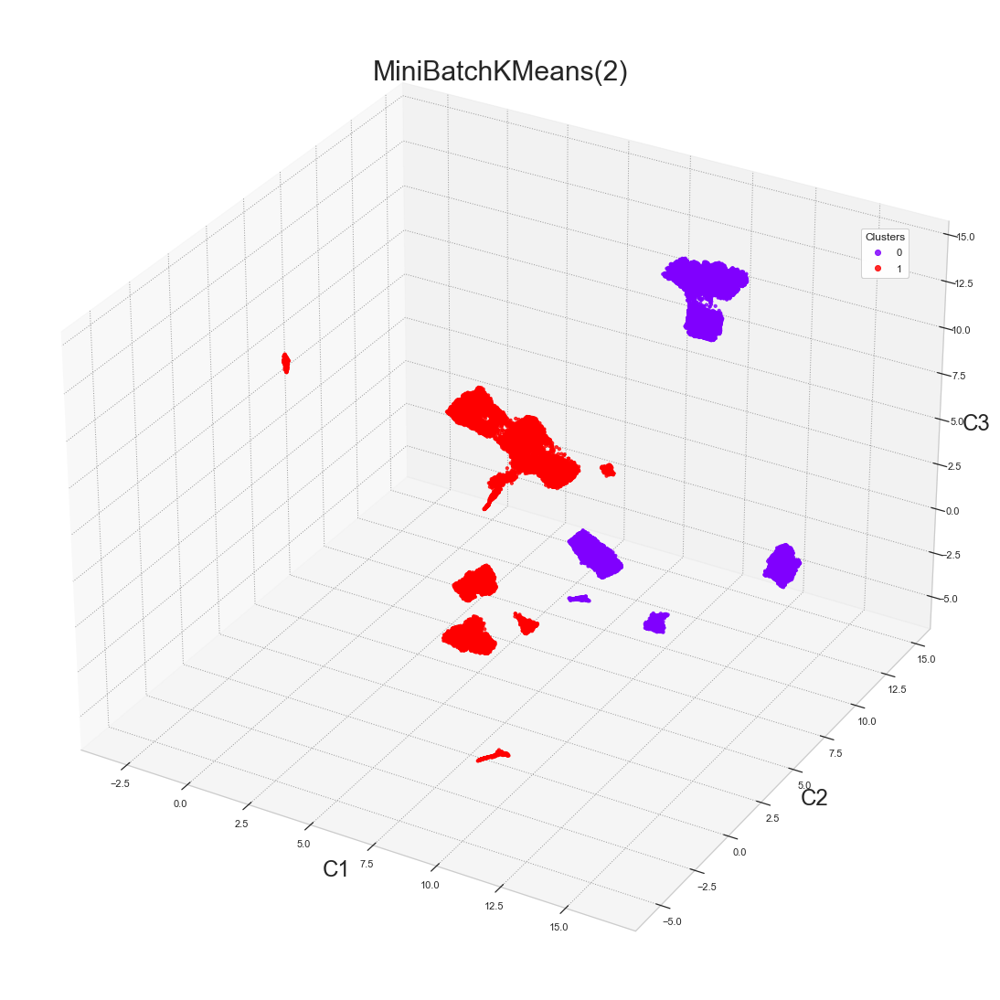

-------------------- MiniBatchKMeans(3) --------------------
Model                     MiniBatchKMeans(3)
Calinski-Harabasz(Var)         117366.622078
Davies-Bouldin(Sim)                 0.726198
Silhouette                          0.594956
Time(s)                             0.293241
hue                                   umaped
Name: 979, dtype: object


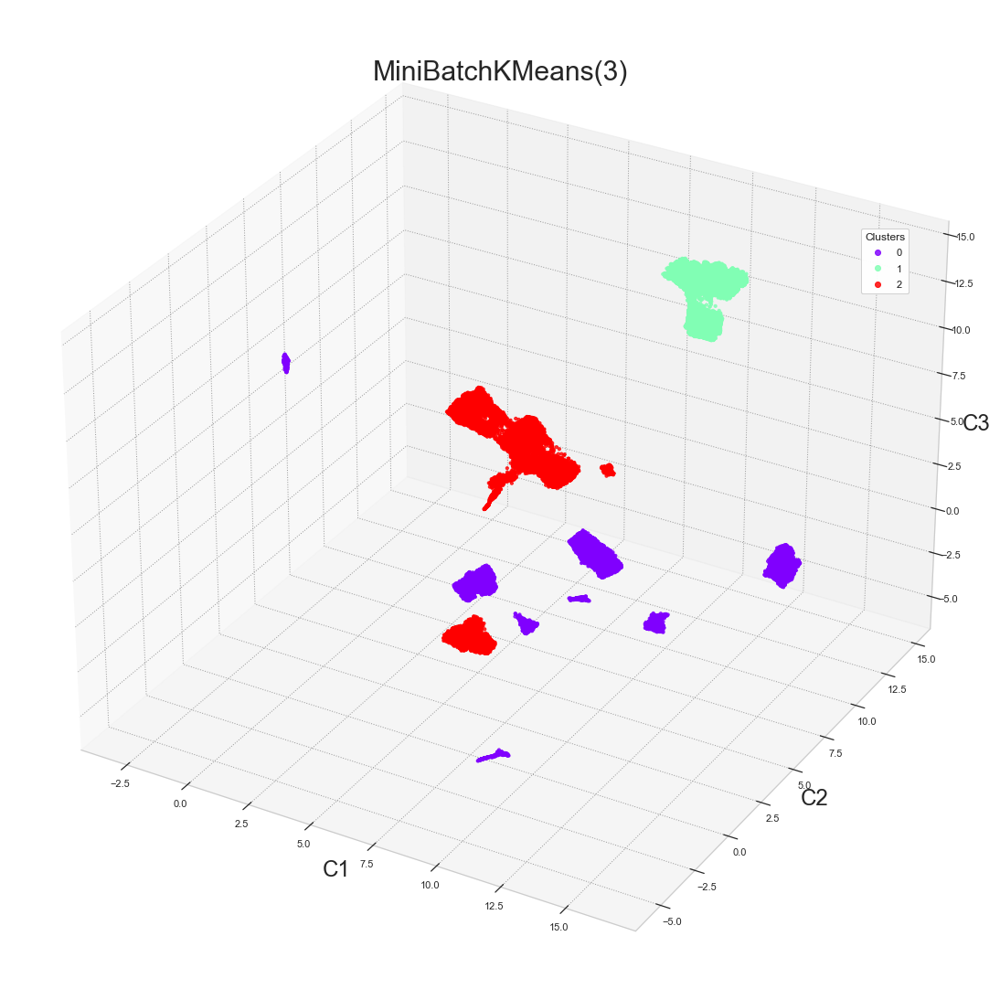

-------------------- MiniBatchKMeans(4) --------------------
Model                     MiniBatchKMeans(4)
Calinski-Harabasz(Var)          139862.13375
Davies-Bouldin(Sim)                 0.769382
Silhouette                          0.636364
Time(s)                             0.366538
hue                                   umaped
Name: 980, dtype: object


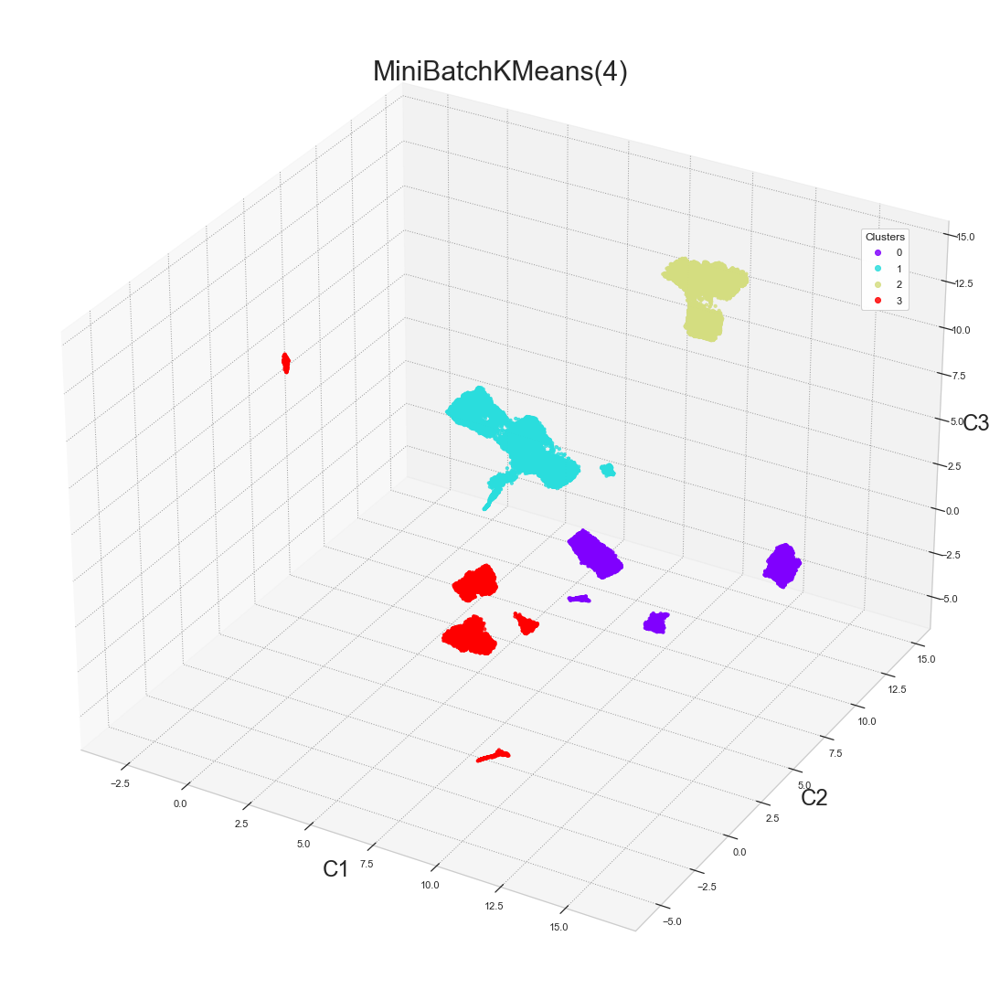

-------------------- MiniBatchKMeans(5) --------------------
Model                     MiniBatchKMeans(5)
Calinski-Harabasz(Var)         176487.886345
Davies-Bouldin(Sim)                  0.57894
Silhouette                          0.679977
Time(s)                             0.325242
hue                                   umaped
Name: 981, dtype: object


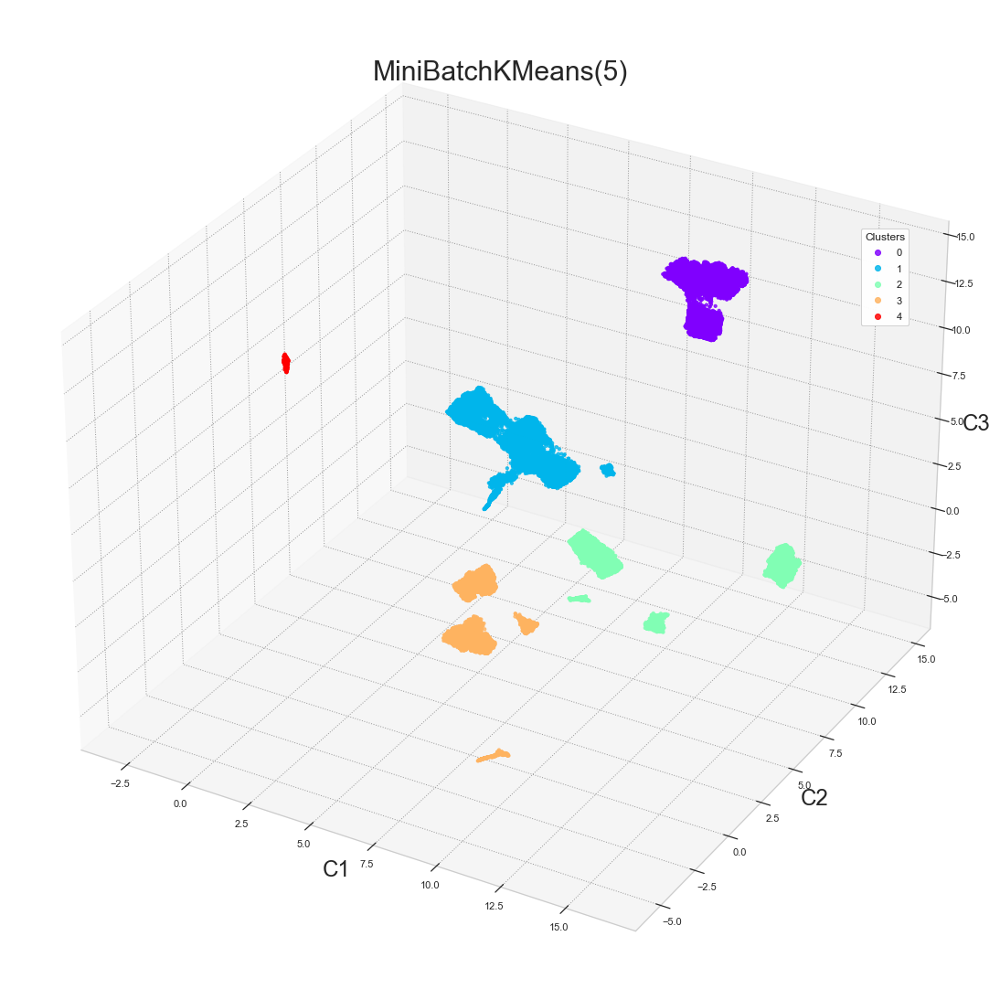

-------------------- MiniBatchKMeans(6) --------------------
Model                     MiniBatchKMeans(6)
Calinski-Harabasz(Var)         175256.989254
Davies-Bouldin(Sim)                 0.514884
Silhouette                          0.652592
Time(s)                             0.386827
hue                                   umaped
Name: 982, dtype: object


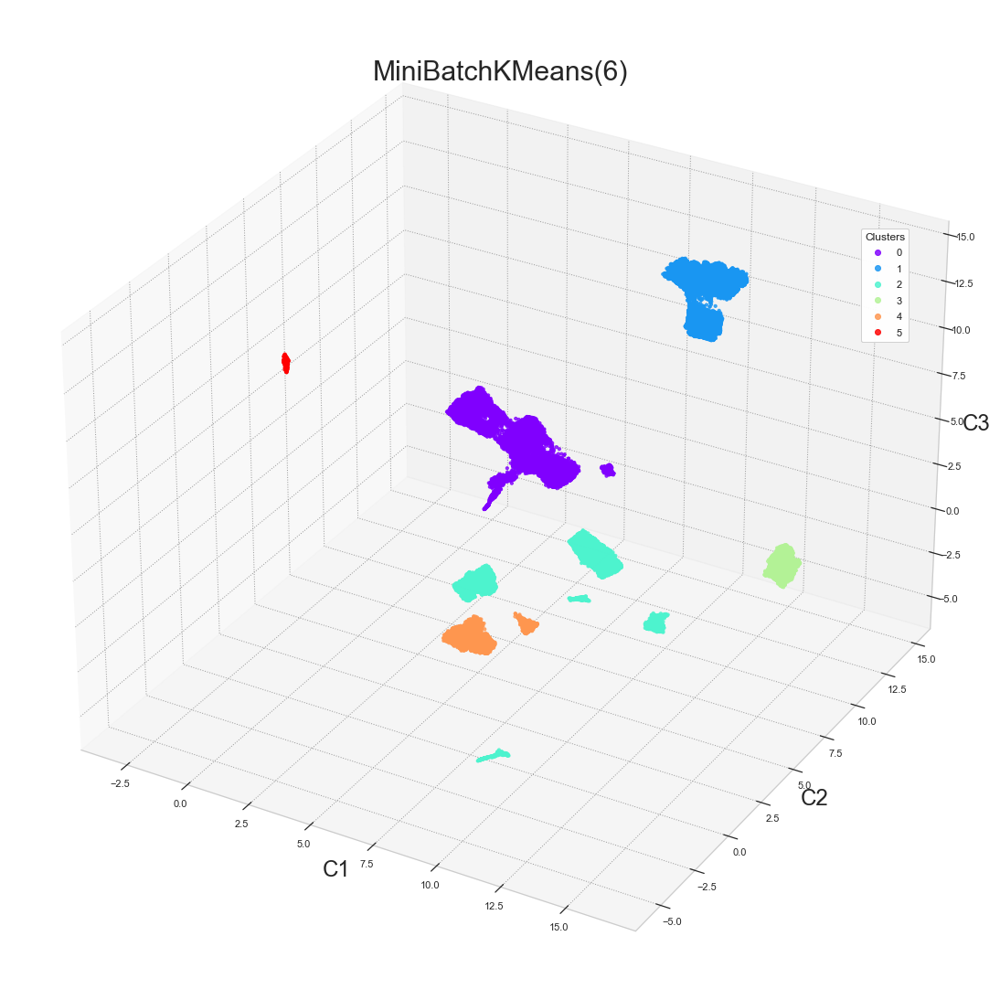

-------------------- MiniBatchKMeans(7) --------------------
Model                     MiniBatchKMeans(7)
Calinski-Harabasz(Var)         269711.001582
Davies-Bouldin(Sim)                 0.405589
Silhouette                           0.72806
Time(s)                             0.327256
hue                                   umaped
Name: 983, dtype: object


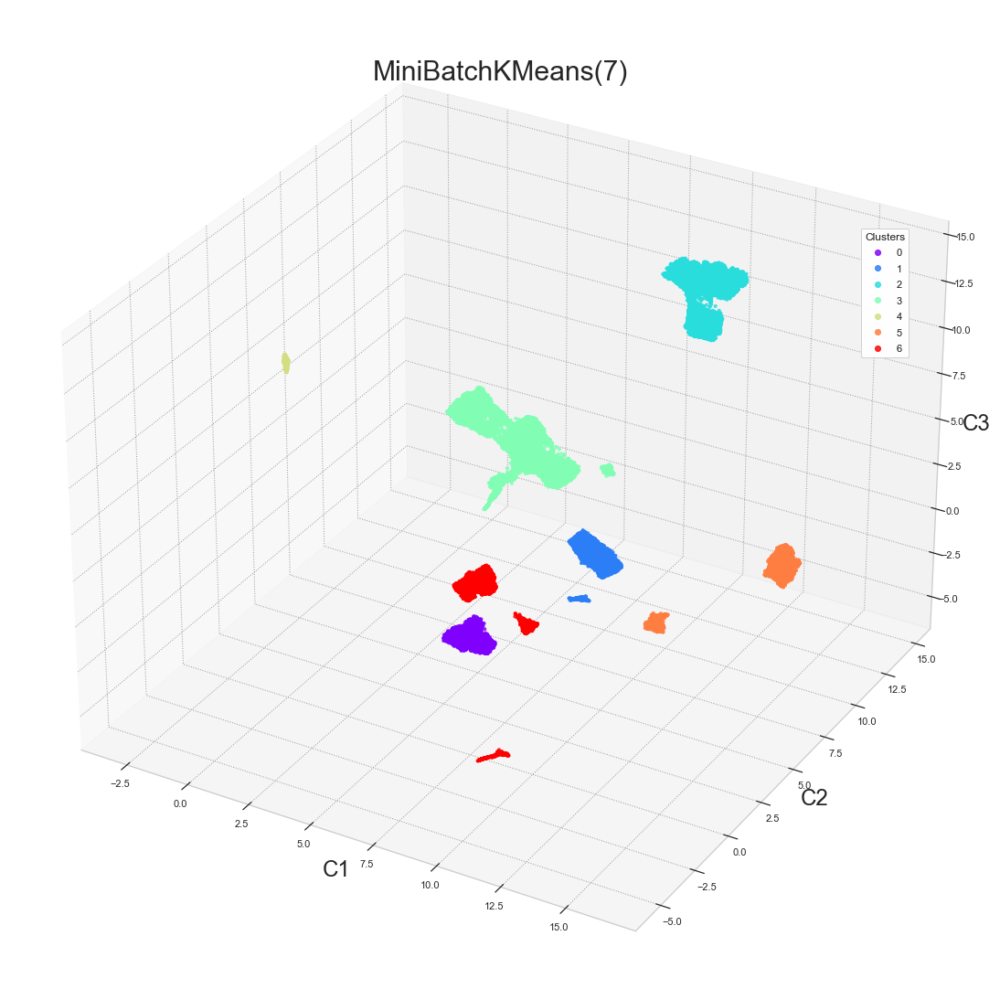

-------------------- MiniBatchKMeans(8) --------------------
Model                     MiniBatchKMeans(8)
Calinski-Harabasz(Var)         259367.683363
Davies-Bouldin(Sim)                 0.553444
Silhouette                          0.614663
Time(s)                              0.74925
hue                                   umaped
Name: 984, dtype: object


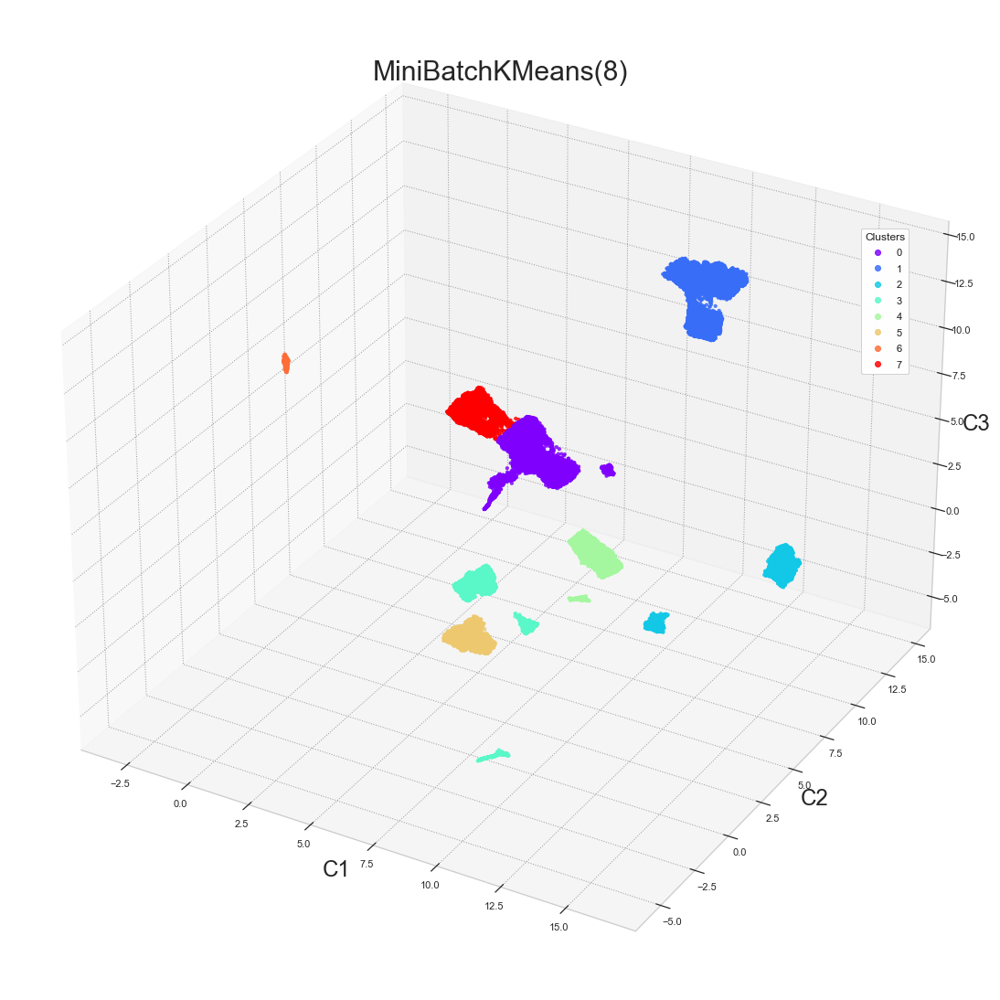

-------------------- MiniBatchKMeans(9) --------------------
Model                     MiniBatchKMeans(9)
Calinski-Harabasz(Var)         291271.274785
Davies-Bouldin(Sim)                 0.582081
Silhouette                          0.643293
Time(s)                             0.723563
hue                                   umaped
Name: 985, dtype: object


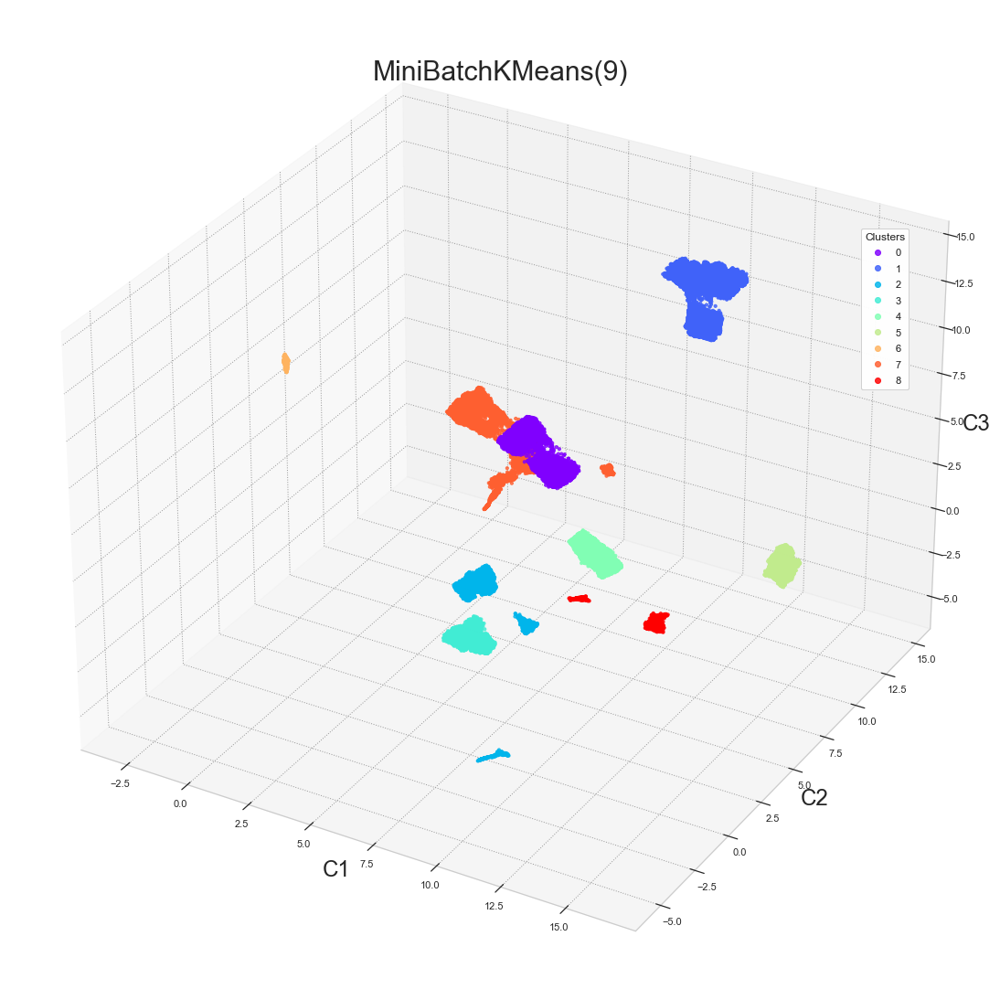

-------------------- MiniBatchKMeans(10) --------------------
Model                     MiniBatchKMeans(10)
Calinski-Harabasz(Var)          300576.467162
Davies-Bouldin(Sim)                  0.694945
Silhouette                           0.646697
Time(s)                              0.833501
hue                                    umaped
Name: 986, dtype: object


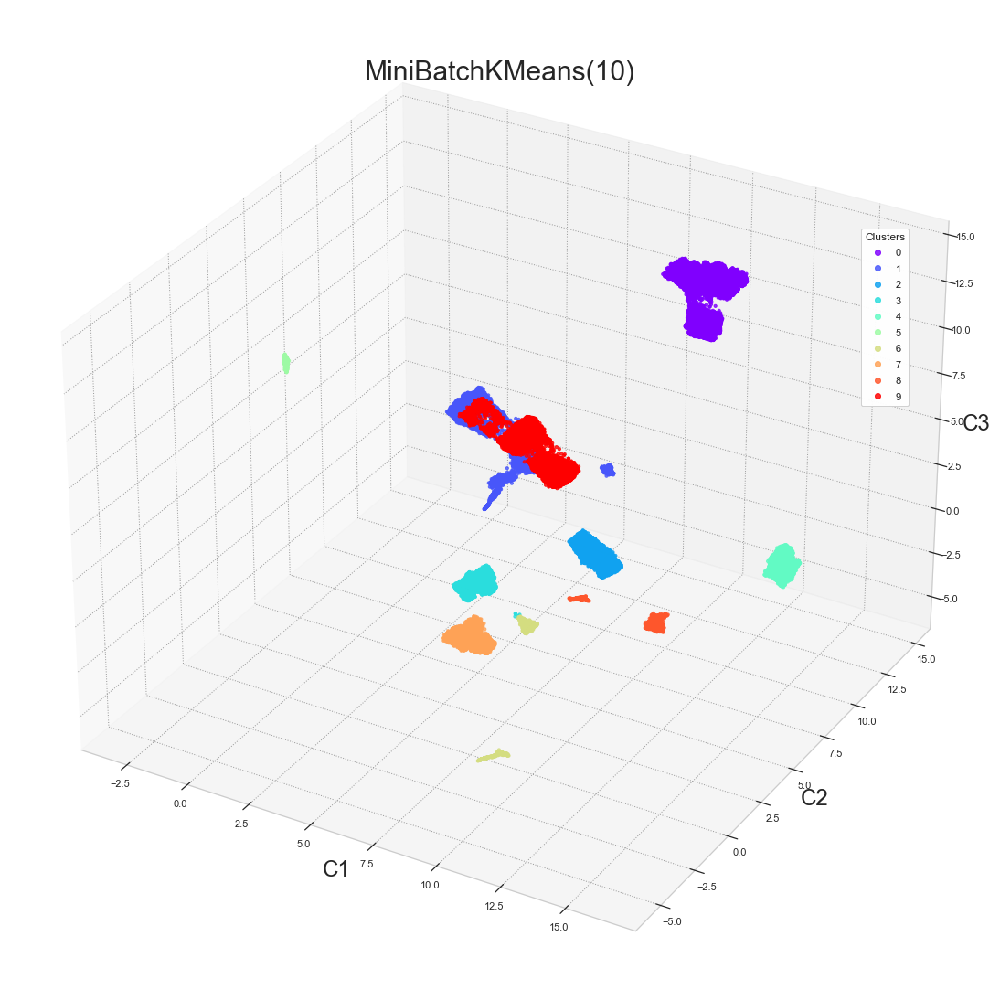

-------------------- MiniBatchKMeans(11) --------------------
Model                     MiniBatchKMeans(11)
Calinski-Harabasz(Var)          360867.991836
Davies-Bouldin(Sim)                  0.512585
Silhouette                            0.57917
Time(s)                              0.670273
hue                                    umaped
Name: 987, dtype: object


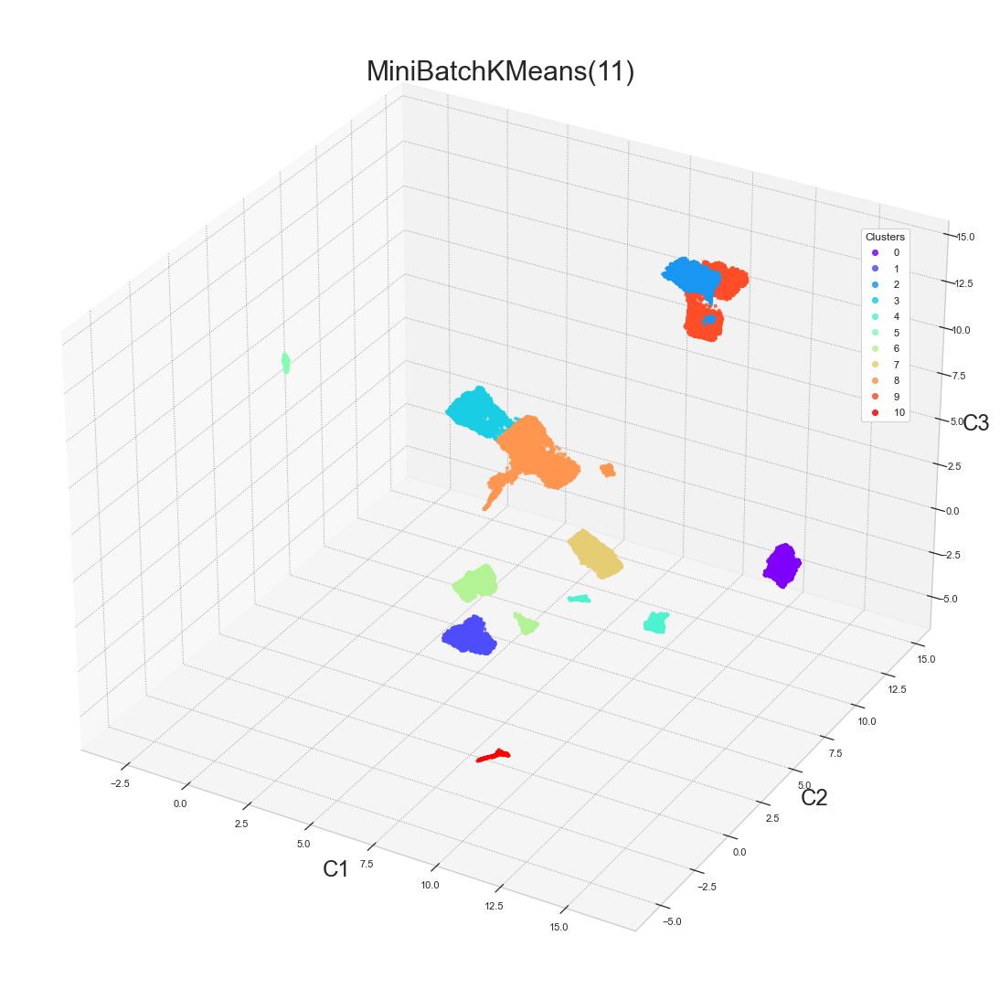

-------------------- MiniBatchKMeans(12) --------------------
Model                     MiniBatchKMeans(12)
Calinski-Harabasz(Var)          425504.191199
Davies-Bouldin(Sim)                  0.488742
Silhouette                           0.602494
Time(s)                              0.758537
hue                                    umaped
Name: 988, dtype: object


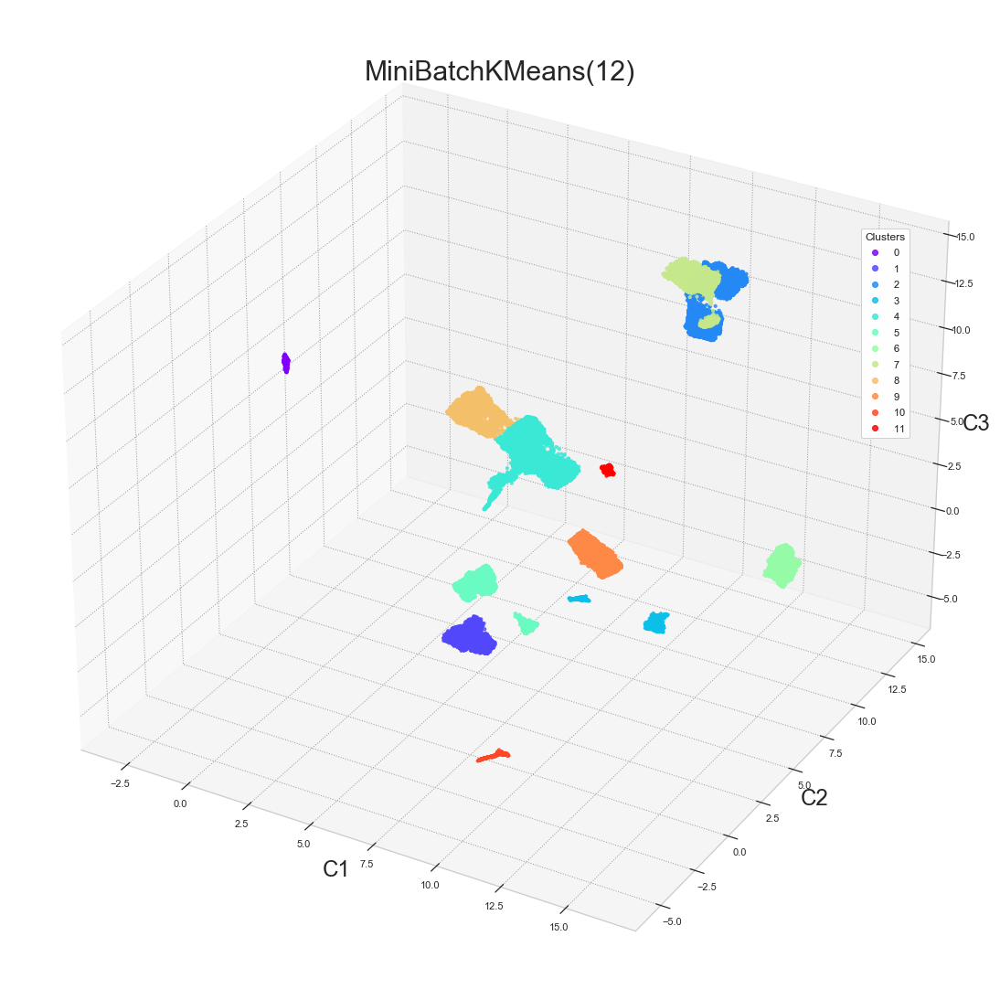

-------------------- MiniBatchKMeans(13) --------------------
Model                     MiniBatchKMeans(13)
Calinski-Harabasz(Var)          503044.974616
Davies-Bouldin(Sim)                  0.474801
Silhouette                           0.639103
Time(s)                              0.551012
hue                                    umaped
Name: 989, dtype: object


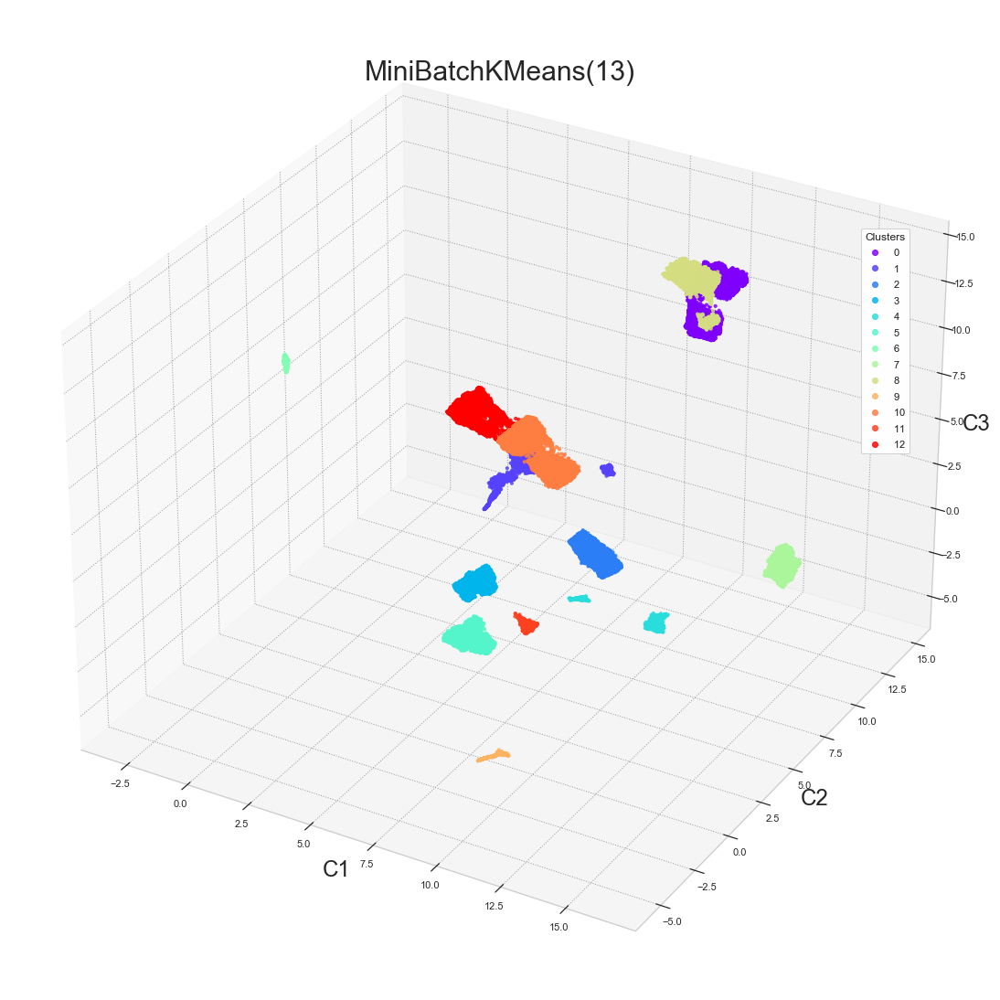

In [74]:
minibatch_kmeans = []
for i in range(n_iter):
    for k in range(kmin, kmax+1):
        cls = clustering(data, MiniBatchKMeans(n_clusters=k, random_state=None, init='k-means++', tol=0.001, batch_size = 2048), 'MiniBatchKMeans('+str(k)+')', projection, Perfs, scale=scale, scores=scores, hue=hue, display_components=display_components)
        minibatch_kmeans.append(cls)

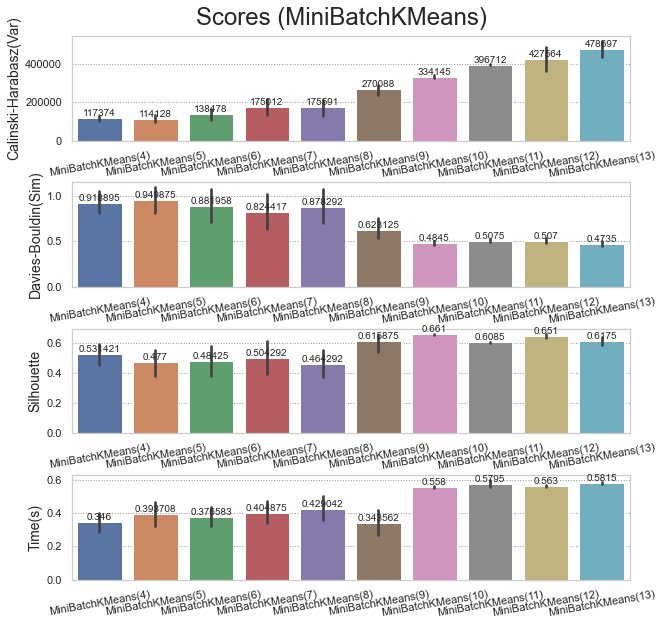

In [173]:
display_scores(Perfs[Perfs['Model'].str.startswith('MiniBatchKMeans')], y='MiniBatchKMeans', width=10, height =10, rotation=10, hspace=0.4)

In [127]:
best_models.append('MiniBatchKMeans(4)')

### 2.3.4. BisectingKMeans(++)

Ce dernier algorithme est à l’intersection entre HCS et KMEans(++). Autrement dit, c’est un KMeans(++) dans lequel de nouveaux clusters sont créés en coupant un des clusters précédents en deux.

-------------------- BisectingKMeans(2) --------------------
Model                     BisectingKMeans(2)
Calinski-Harabasz(Var)          76865.075851
Davies-Bouldin(Sim)                 1.025141
Silhouette                          0.477181
Time(s)                             0.182127
hue                                   umaped
Name: 1098, dtype: object


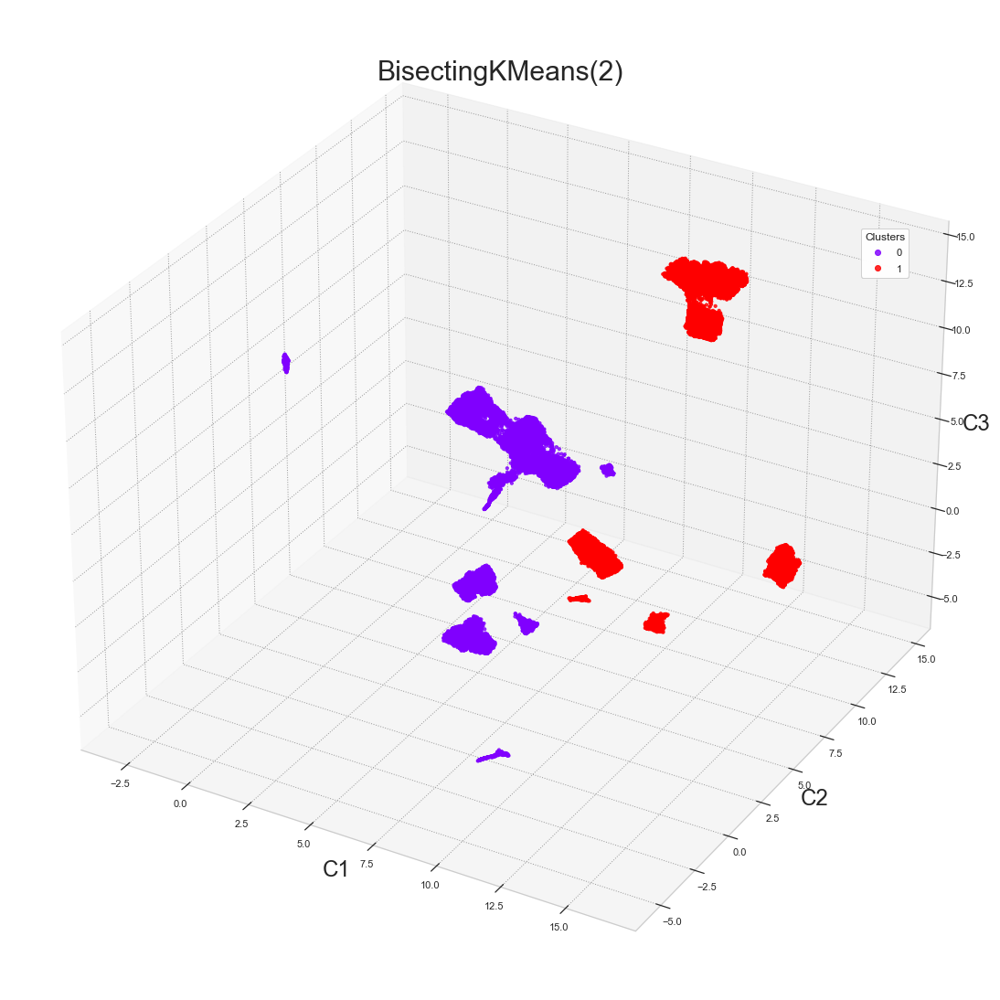

-------------------- BisectingKMeans(3) --------------------
Model                     BisectingKMeans(3)
Calinski-Harabasz(Var)         111938.362505
Davies-Bouldin(Sim)                 0.750307
Silhouette                          0.585149
Time(s)                             0.498374
hue                                   umaped
Name: 1099, dtype: object


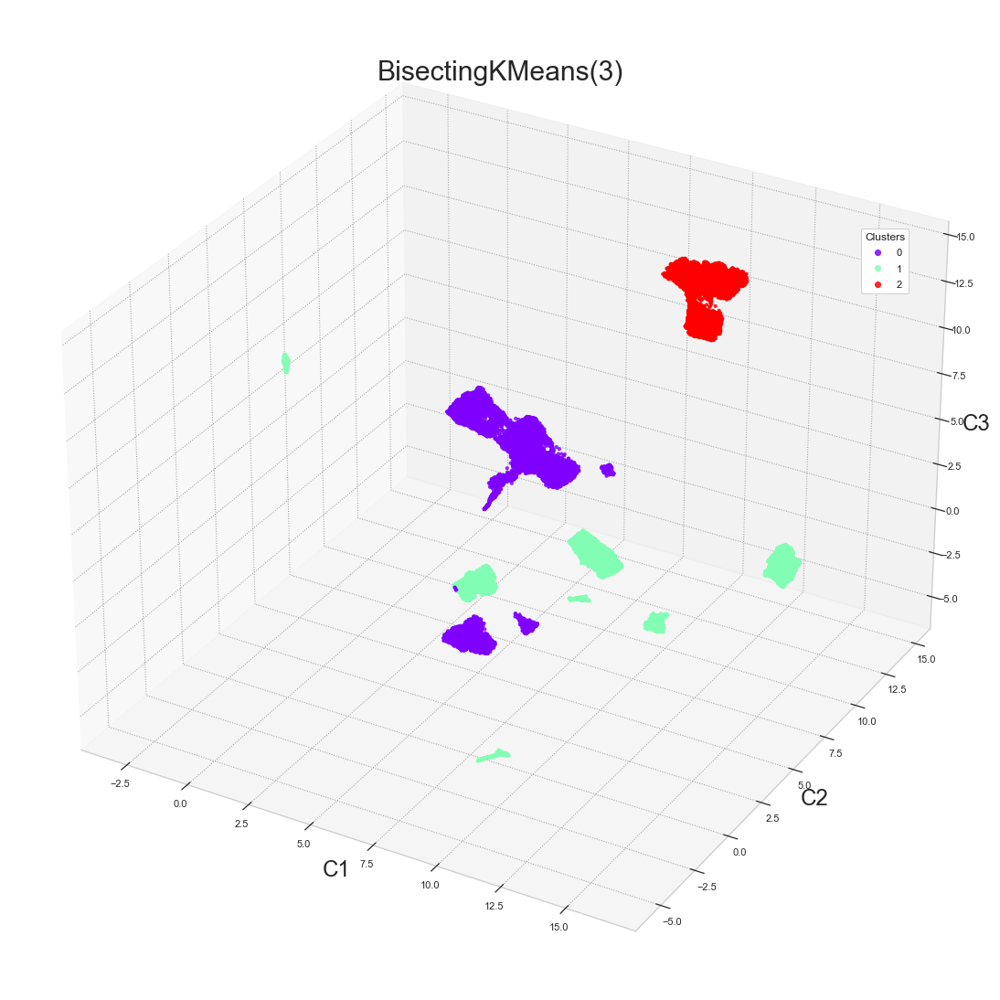

-------------------- BisectingKMeans(4) --------------------
Model                     BisectingKMeans(4)
Calinski-Harabasz(Var)          139862.13375
Davies-Bouldin(Sim)                 0.769382
Silhouette                          0.636364
Time(s)                             0.519989
hue                                   umaped
Name: 1100, dtype: object


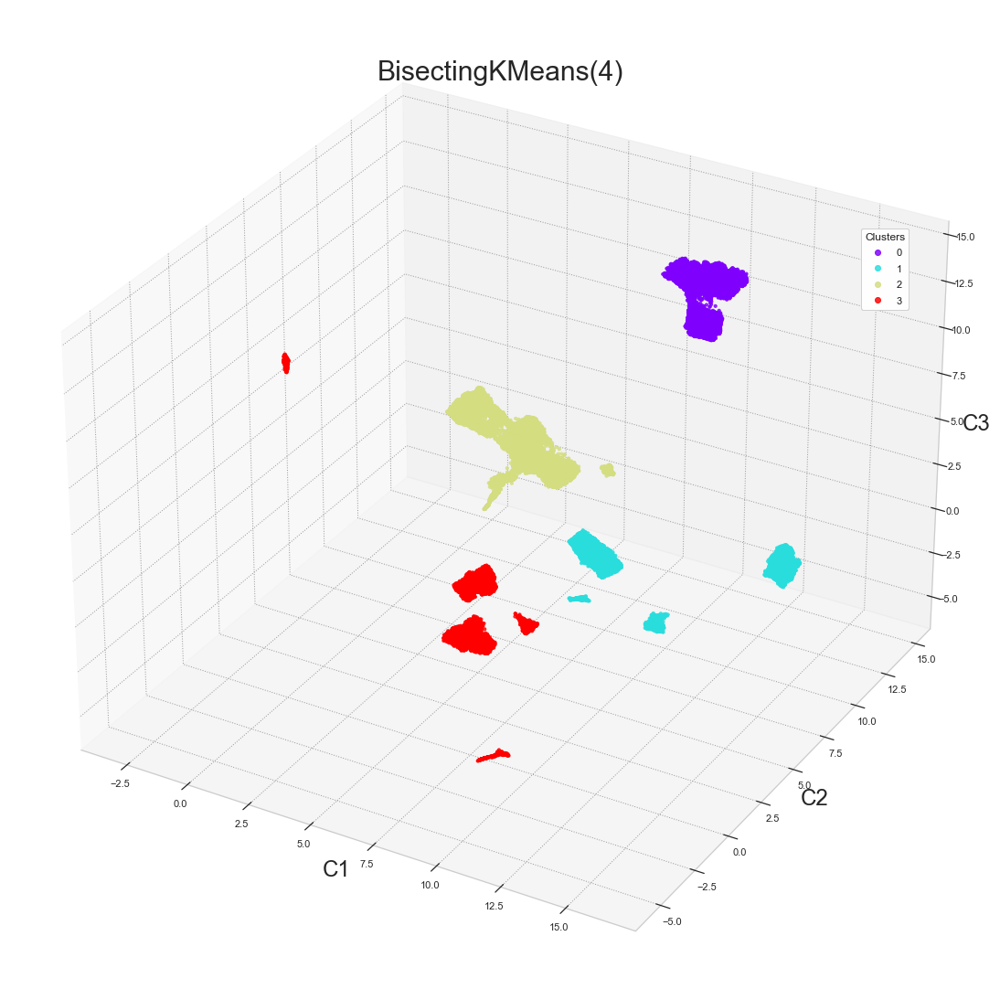

-------------------- BisectingKMeans(5) --------------------
Model                     BisectingKMeans(5)
Calinski-Harabasz(Var)         176487.886345
Davies-Bouldin(Sim)                  0.57894
Silhouette                          0.679977
Time(s)                             0.633986
hue                                   umaped
Name: 1101, dtype: object


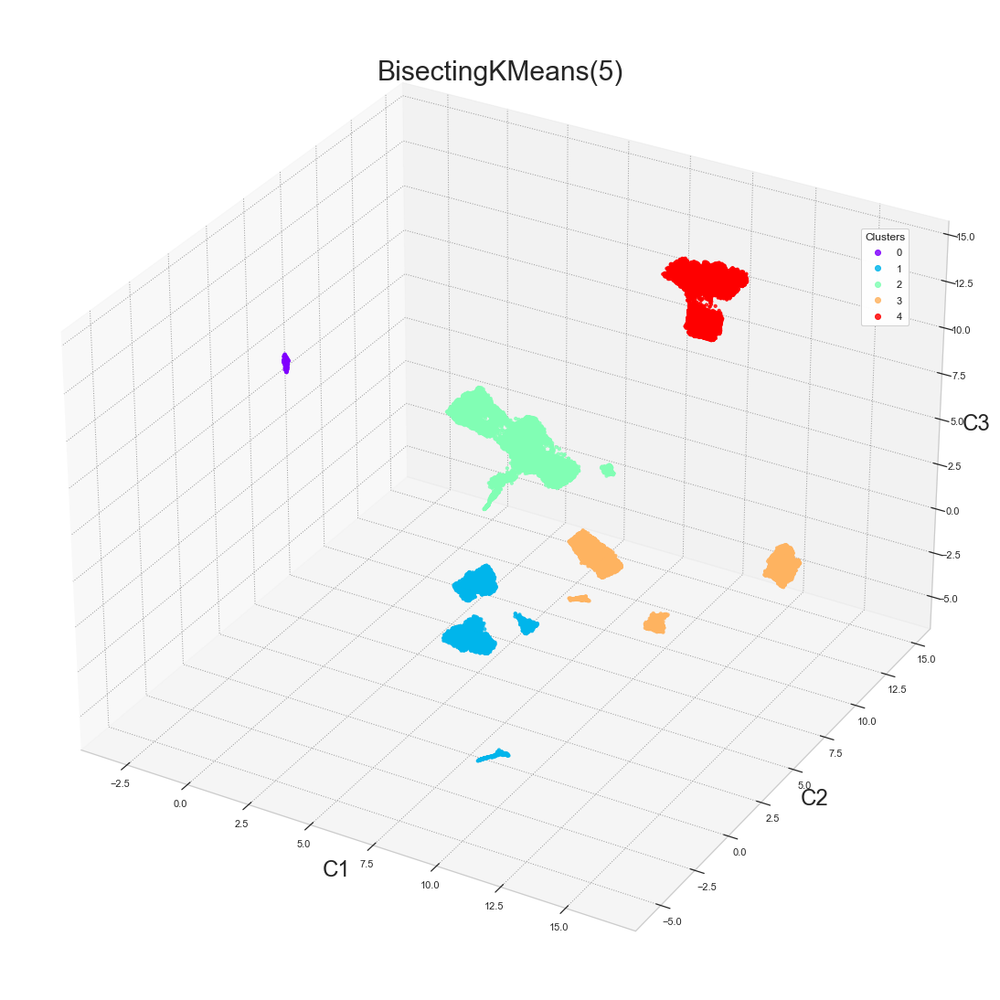

-------------------- BisectingKMeans(6) --------------------
Model                     BisectingKMeans(6)
Calinski-Harabasz(Var)         213967.299068
Davies-Bouldin(Sim)                 0.467404
Silhouette                          0.704277
Time(s)                             0.701532
hue                                   umaped
Name: 1102, dtype: object


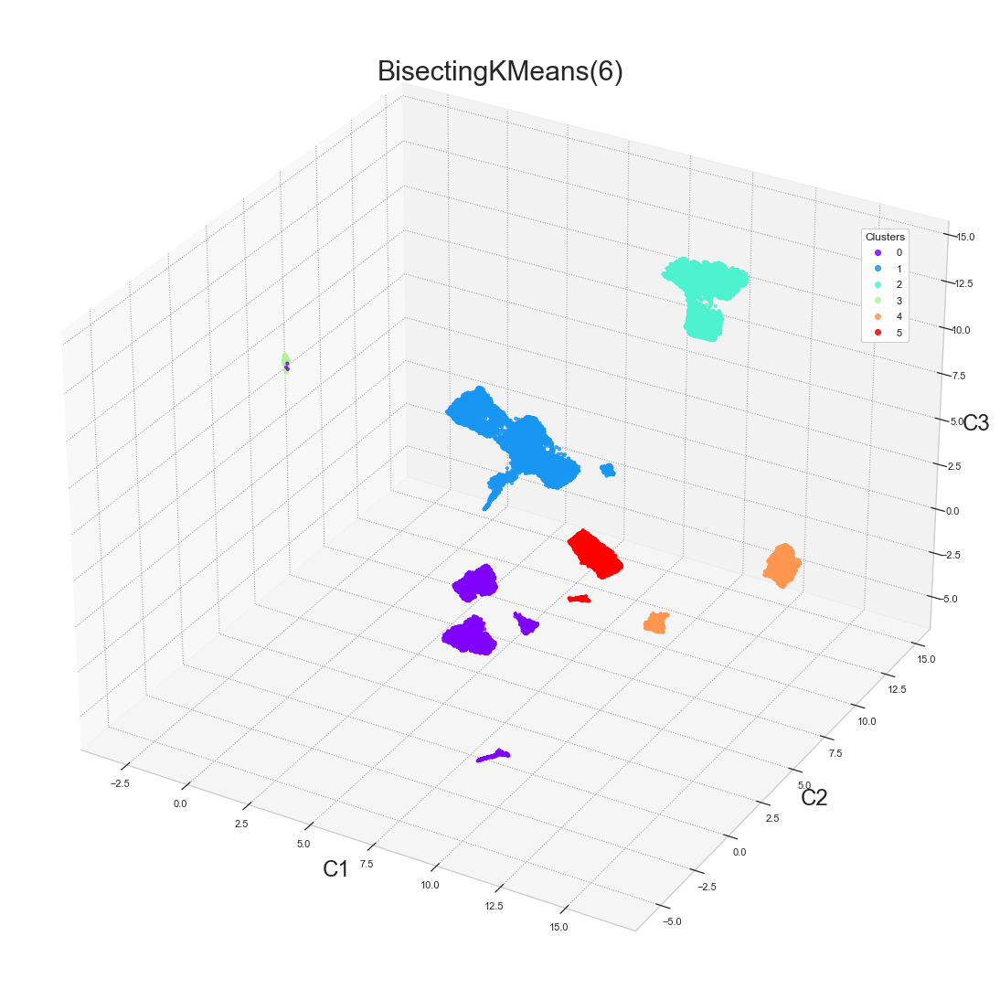

-------------------- BisectingKMeans(7) --------------------
Model                     BisectingKMeans(7)
Calinski-Harabasz(Var)         269711.001582
Davies-Bouldin(Sim)                 0.405589
Silhouette                           0.72806
Time(s)                              0.82246
hue                                   umaped
Name: 1103, dtype: object


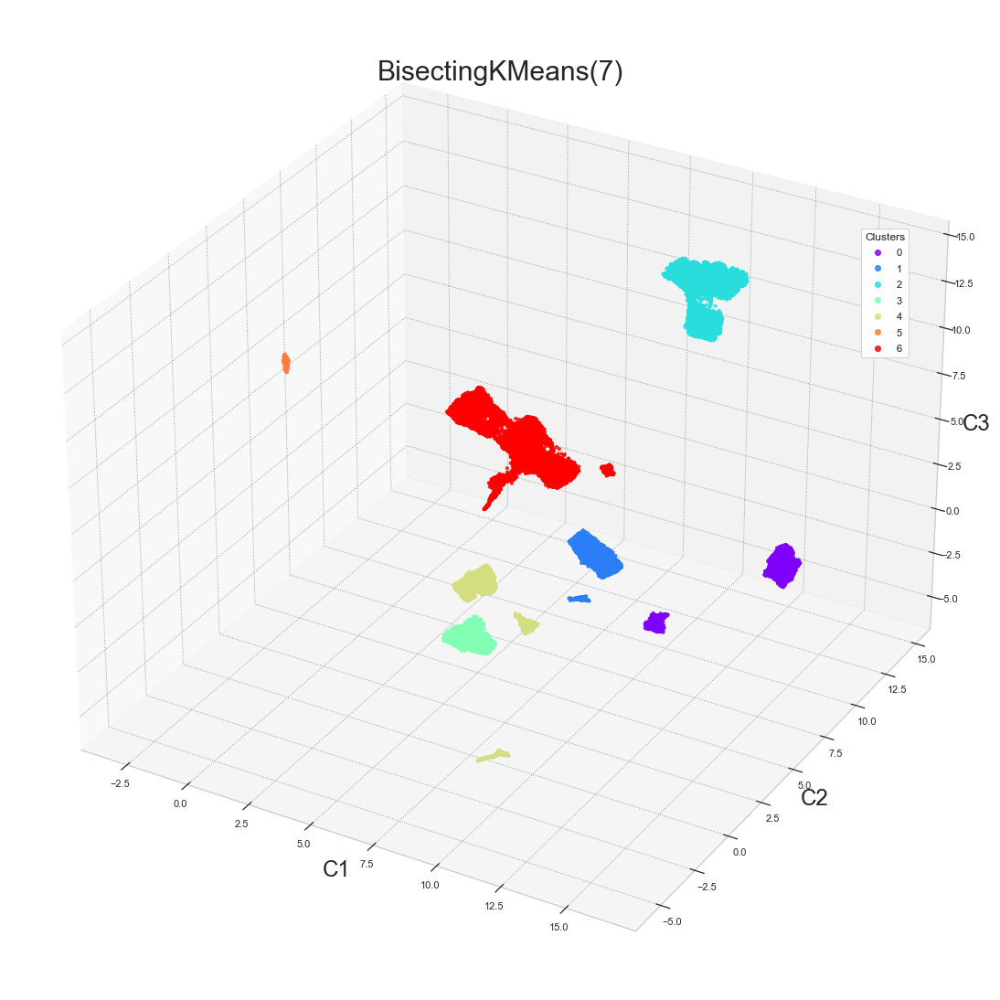

-------------------- BisectingKMeans(8) --------------------
Model                     BisectingKMeans(8)
Calinski-Harabasz(Var)         268865.287301
Davies-Bouldin(Sim)                 0.562703
Silhouette                          0.642641
Time(s)                             1.480773
hue                                   umaped
Name: 1104, dtype: object


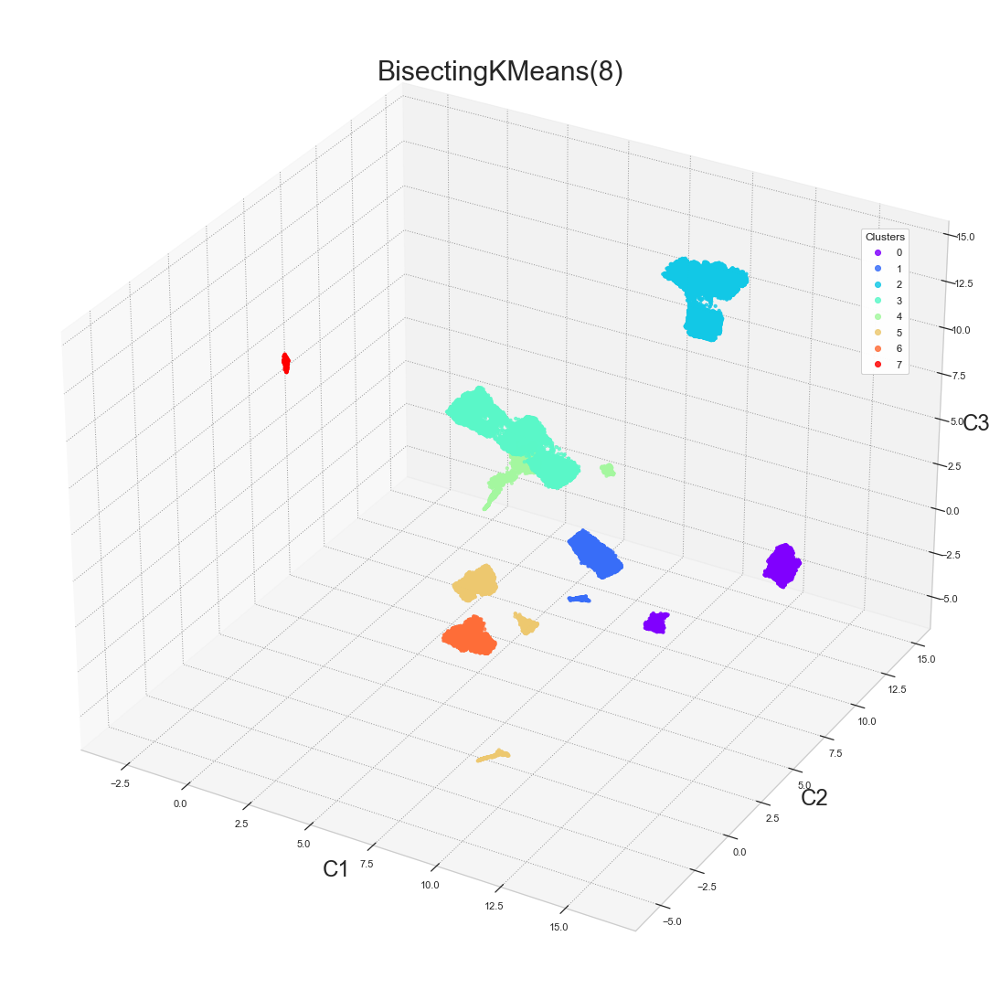

-------------------- BisectingKMeans(9) --------------------
Model                     BisectingKMeans(9)
Calinski-Harabasz(Var)         273641.611717
Davies-Bouldin(Sim)                 0.618241
Silhouette                          0.568618
Time(s)                             1.026565
hue                                   umaped
Name: 1105, dtype: object


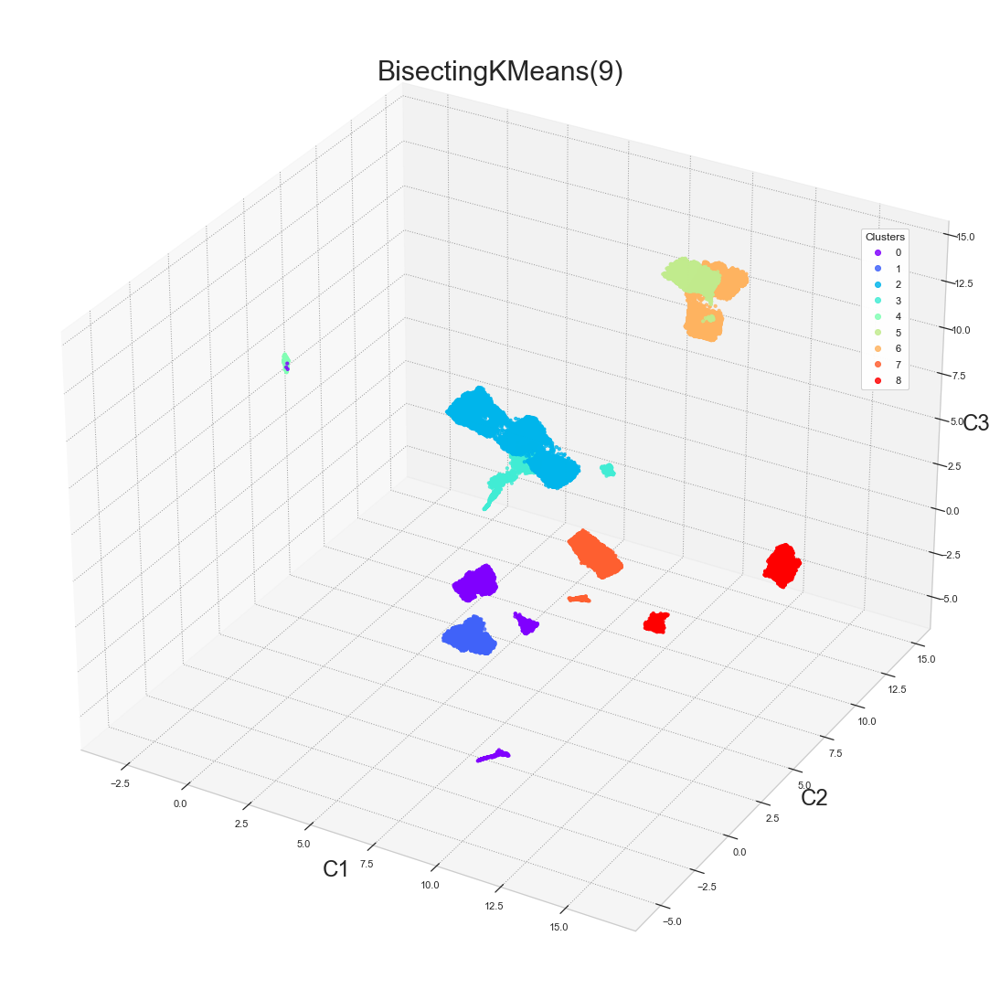

-------------------- BisectingKMeans(10) --------------------
Model                     BisectingKMeans(10)
Calinski-Harabasz(Var)          261058.553792
Davies-Bouldin(Sim)                  0.611824
Silhouette                           0.574838
Time(s)                              1.256775
hue                                    umaped
Name: 1106, dtype: object


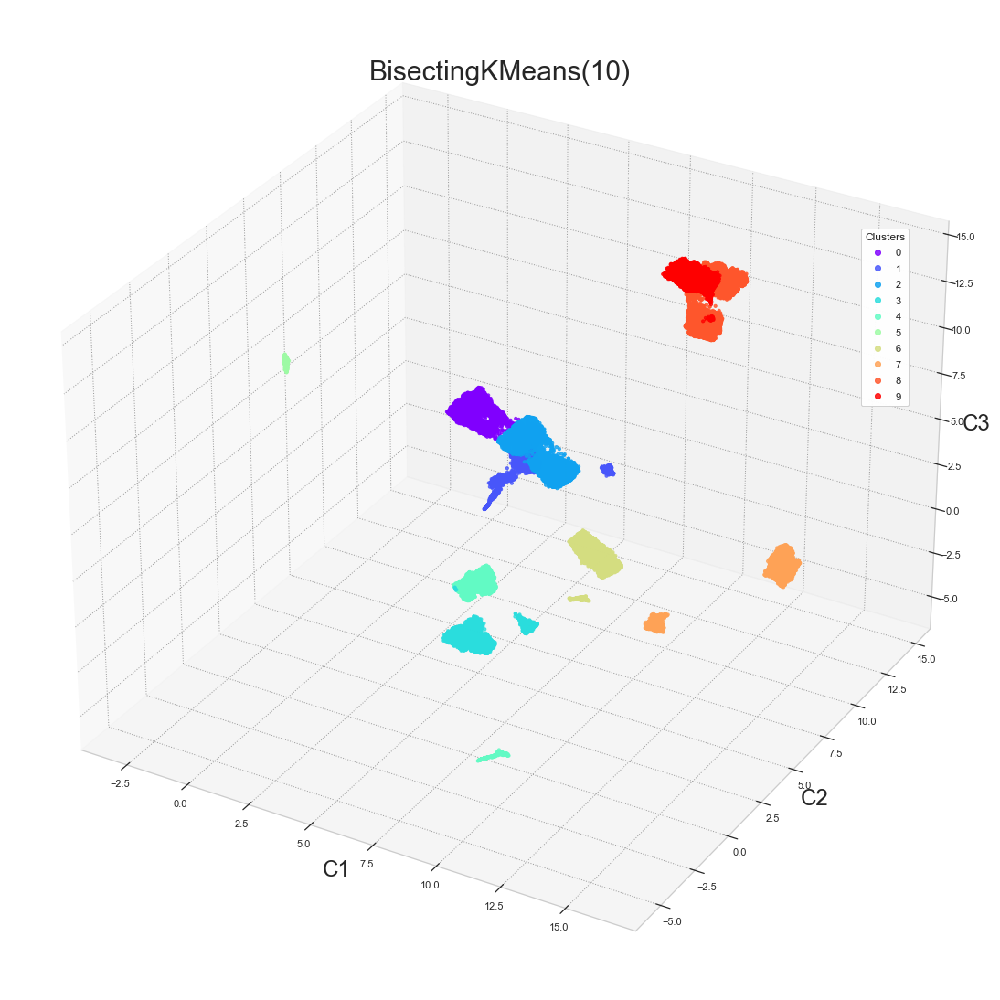

-------------------- BisectingKMeans(11) --------------------
Model                     BisectingKMeans(11)
Calinski-Harabasz(Var)          339031.625477
Davies-Bouldin(Sim)                  0.515504
Silhouette                           0.610184
Time(s)                              1.723289
hue                                    umaped
Name: 1107, dtype: object


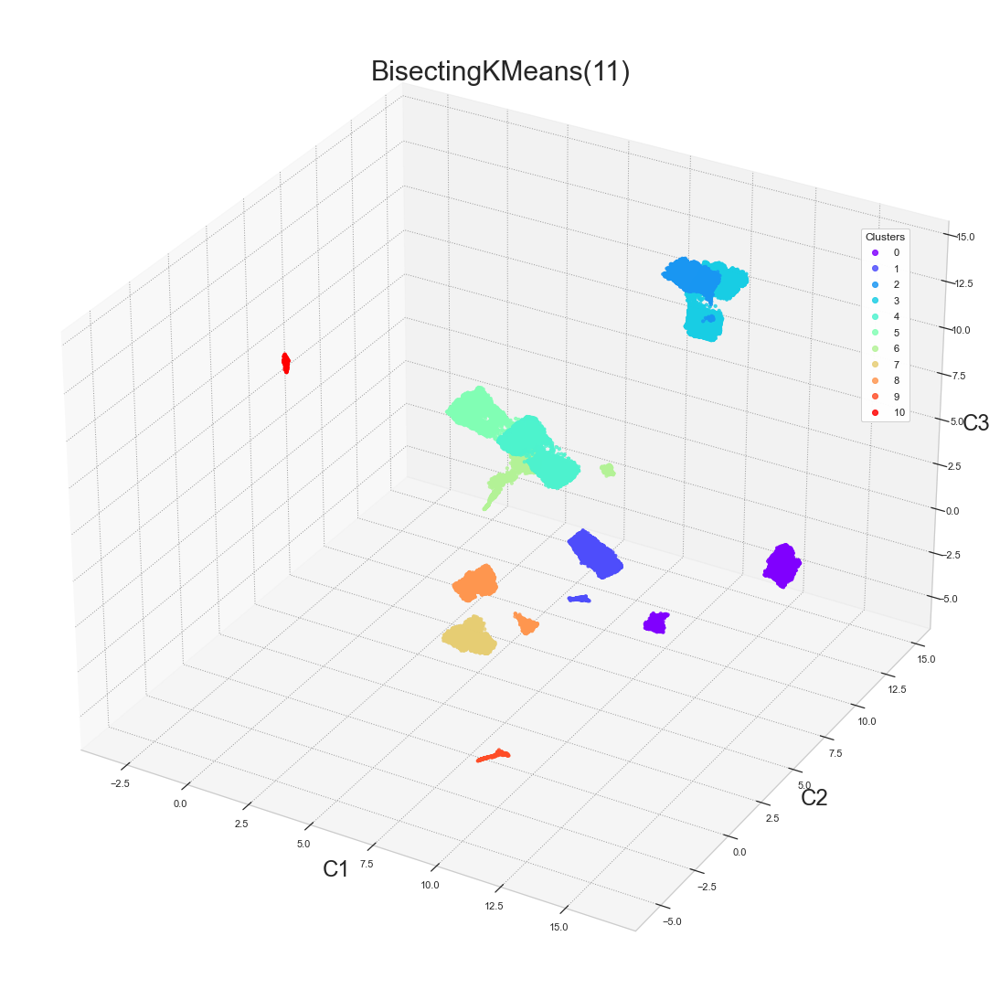

-------------------- BisectingKMeans(12) --------------------
Model                     BisectingKMeans(12)
Calinski-Harabasz(Var)          431768.399942
Davies-Bouldin(Sim)                   0.45916
Silhouette                           0.620415
Time(s)                              1.625317
hue                                    umaped
Name: 1108, dtype: object


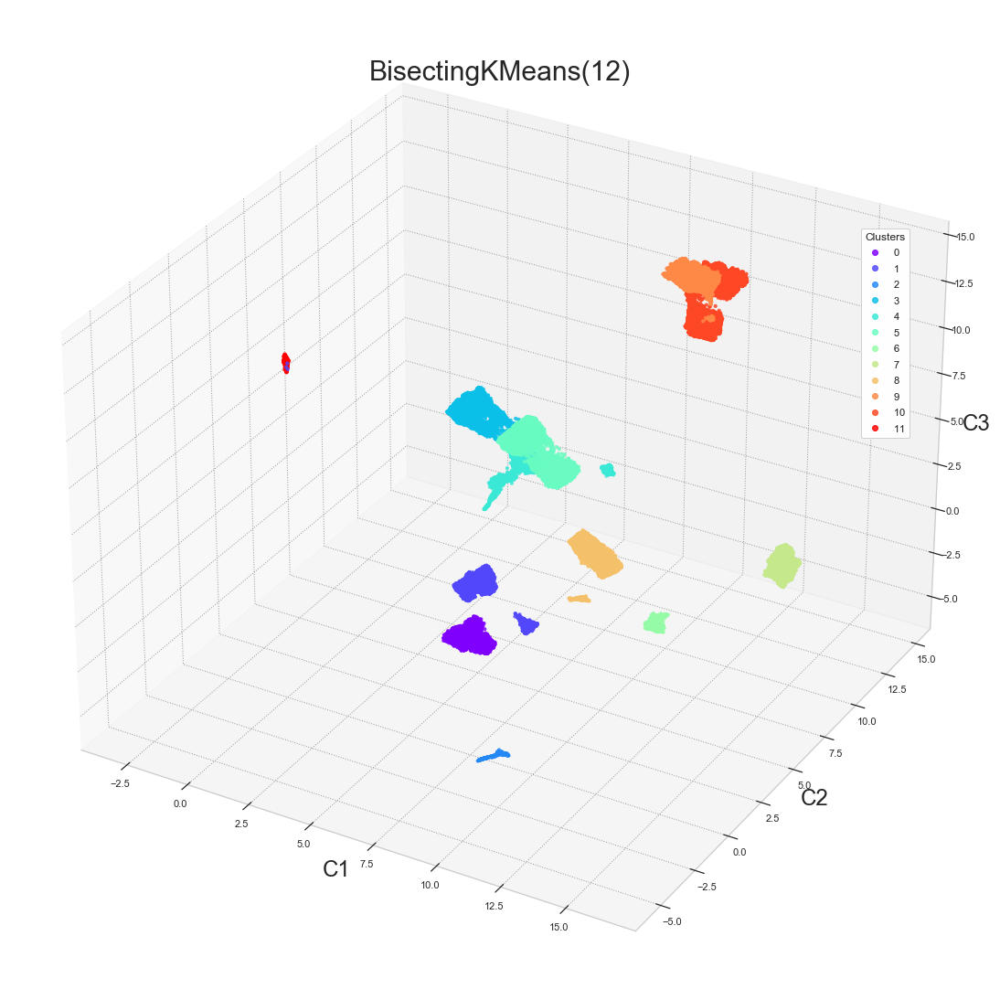

-------------------- BisectingKMeans(13) --------------------
Model                     BisectingKMeans(13)
Calinski-Harabasz(Var)          450851.591963
Davies-Bouldin(Sim)                  0.490157
Silhouette                           0.629448
Time(s)                              2.245132
hue                                    umaped
Name: 1109, dtype: object


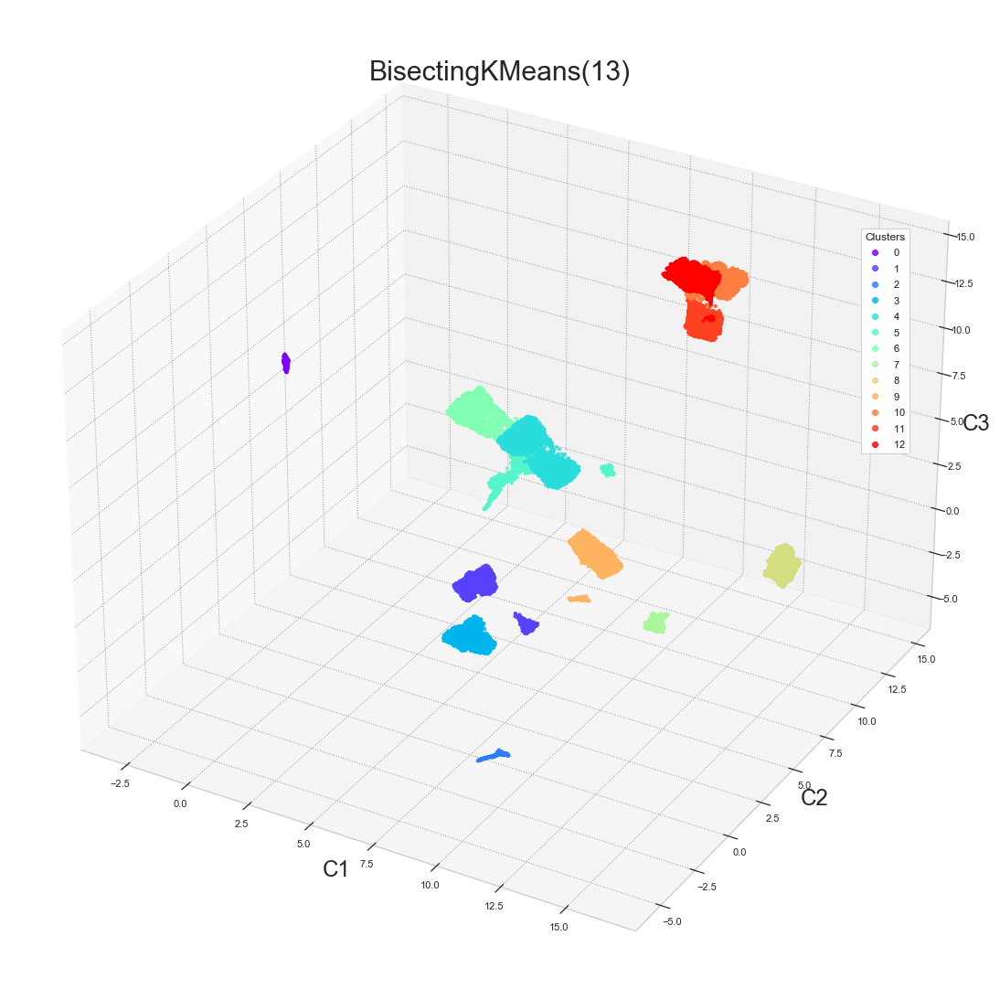

In [76]:
bisecting_kmeans = []
for i in range(n_iter):
    for k in range(kmin, kmax+1):
        cls = clustering(data, BisectingKMeans(n_clusters=k, random_state=None, init='k-means++', n_init=3), 'BisectingKMeans('+str(k)+')', projection, Perfs, scale=scale, scores=scores, hue=hue, display_components=display_components)
        bisecting_kmeans.append(cls)

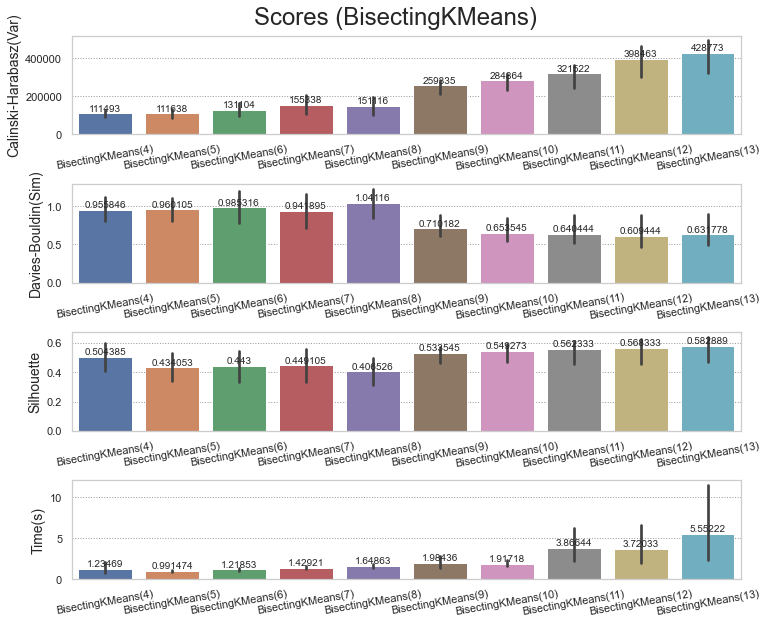

In [130]:
display_scores(Perfs[Perfs['Model'].str.startswith('BisectingKMeans')], y='BisectingKMeans', width=12, height =10, rotation=10, hspace=0.5)

In [128]:
best_models.append('BisectingKMeans(4)')

Les résultats des algorithmes la famille KMeans(++) seront comparés à la fin de cette partie. Mais avant cela, on s’intéresse aux algorithmes prenant en charge les données de type catégoriel seules (KModes) ou mixées aux données numériques (KPrototypes).

## 2.4. KModes

<p>Certaines informations comme la catégorie des produits et la région géographique sont des données catégorielles, qui sans une transformation adéquate en données numériques ne sont pas exploitables par la plupart des algorithmes de Clustering actuels.</p>
<p>Pour cela, deux algorithmes proposent de modifier le KMeans pour l’adapter aux traitement de données catégorielles ou mixtes. KModes est le premier de ces algorithmes et traite uniquement les données catégorielles.</p>


In [15]:
n_iter = 1
kmin = 2
kmax = 13

In [16]:
data = pd.read_csv('olist.csv', low_memory=low_memory)
scale = 'std'
hue = 'df'
display_components=3 # <1 aucun diplay, 3 display 3D, sinon display 2D sur le nombre de composantes choisies
# %matplotlib widget

In [17]:
# préparation des données pour le clustering
X = data.iloc[:, 1:].values
categs = ['multi_orders(F)', 'payment_value(M)', 'daytime', 'weekday', 'month', 'review_score(S)', 'pcateg', 'payment_type', 'customer_state']
X = data[categs].values

-------------------- KModes(2) --------------------
Model                      KModes(2)
Calinski-Harabasz(Var)    274.264857
Davies-Bouldin(Sim)        14.900105
Silhouette                  0.010052
Time(s)                    99.586552
hue                               df
Name: 910, dtype: object


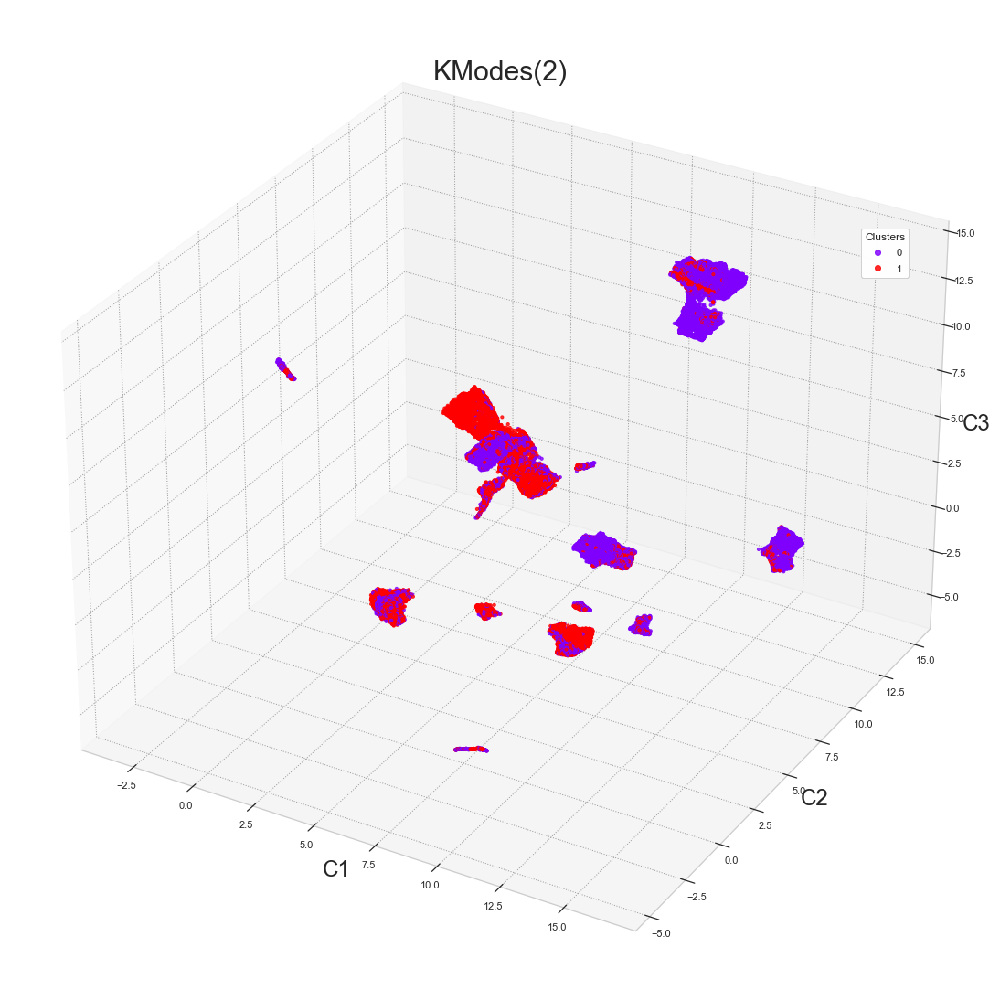

-------------------- KModes(3) --------------------
Model                      KModes(3)
Calinski-Harabasz(Var)    263.931055
Davies-Bouldin(Sim)        12.321321
Silhouette                 -0.027864
Time(s)                   128.304928
hue                               df
Name: 911, dtype: object


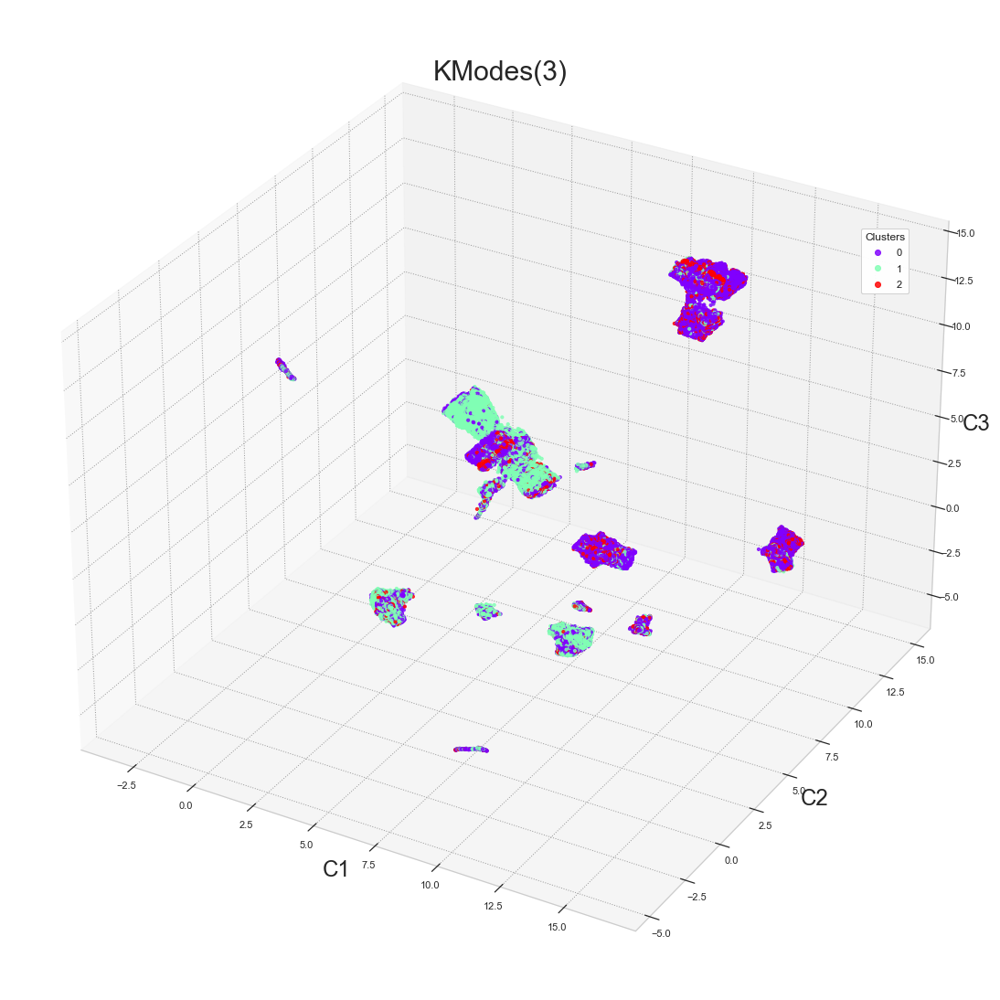

-------------------- KModes(4) --------------------
Model                      KModes(4)
Calinski-Harabasz(Var)    232.017288
Davies-Bouldin(Sim)        18.817811
Silhouette                 -0.036334
Time(s)                   151.171382
hue                               df
Name: 912, dtype: object


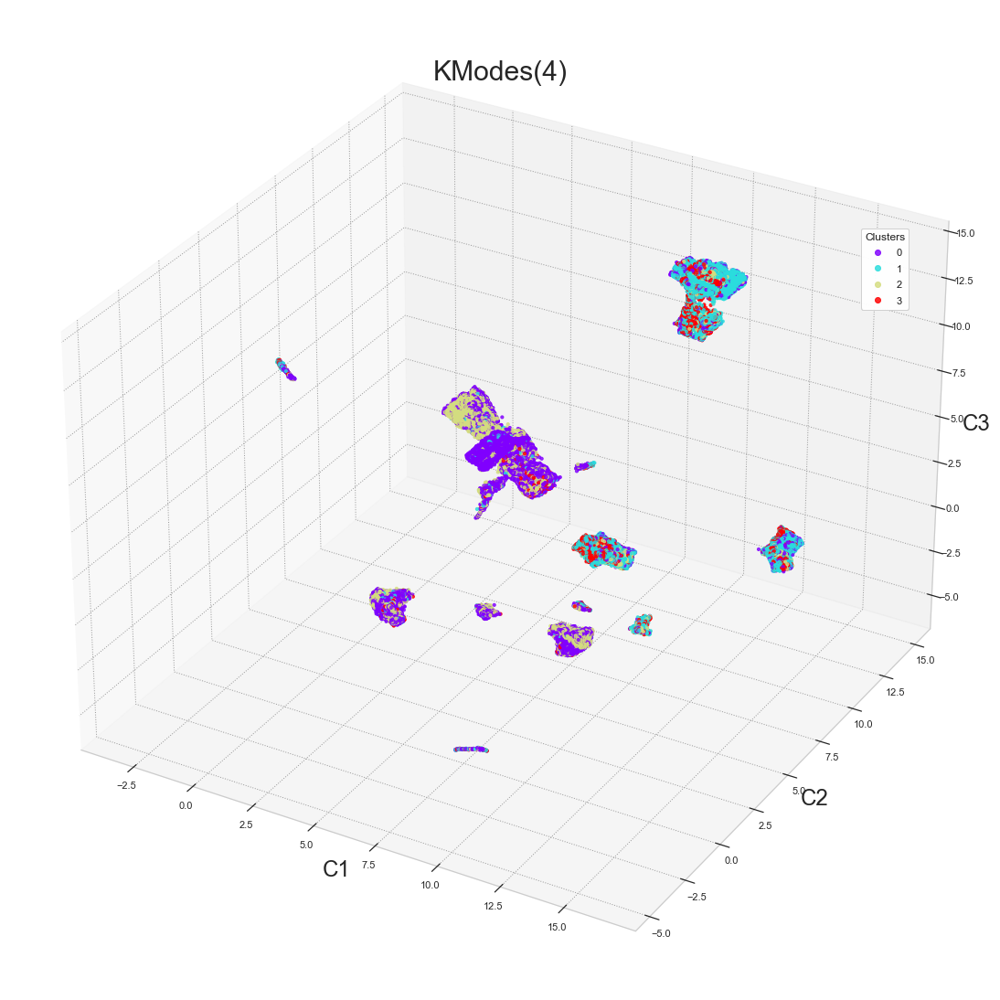

-------------------- KModes(5) --------------------
Model                      KModes(5)
Calinski-Harabasz(Var)    373.663672
Davies-Bouldin(Sim)        11.429898
Silhouette                 -0.023714
Time(s)                   148.318842
hue                               df
Name: 913, dtype: object


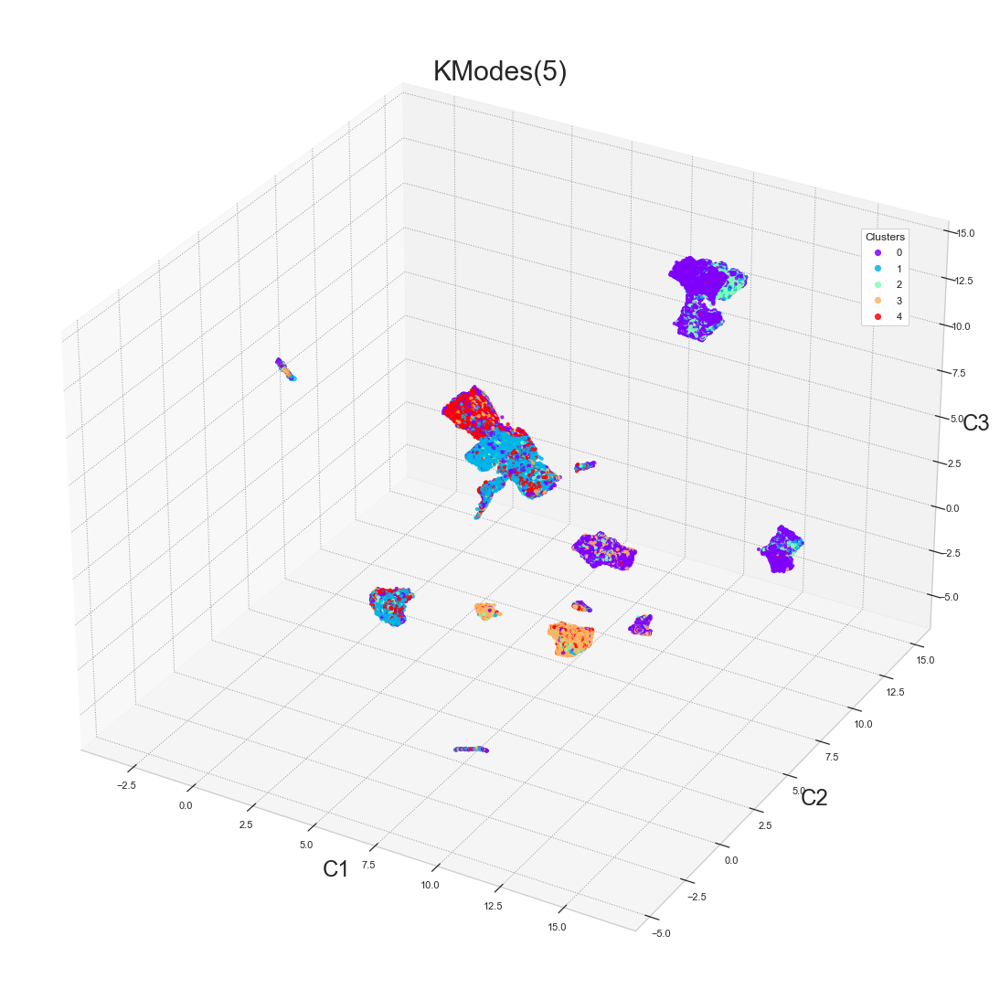

-------------------- KModes(6) --------------------
Model                      KModes(6)
Calinski-Harabasz(Var)    262.426454
Davies-Bouldin(Sim)        12.798787
Silhouette                 -0.033189
Time(s)                   153.729633
hue                               df
Name: 914, dtype: object


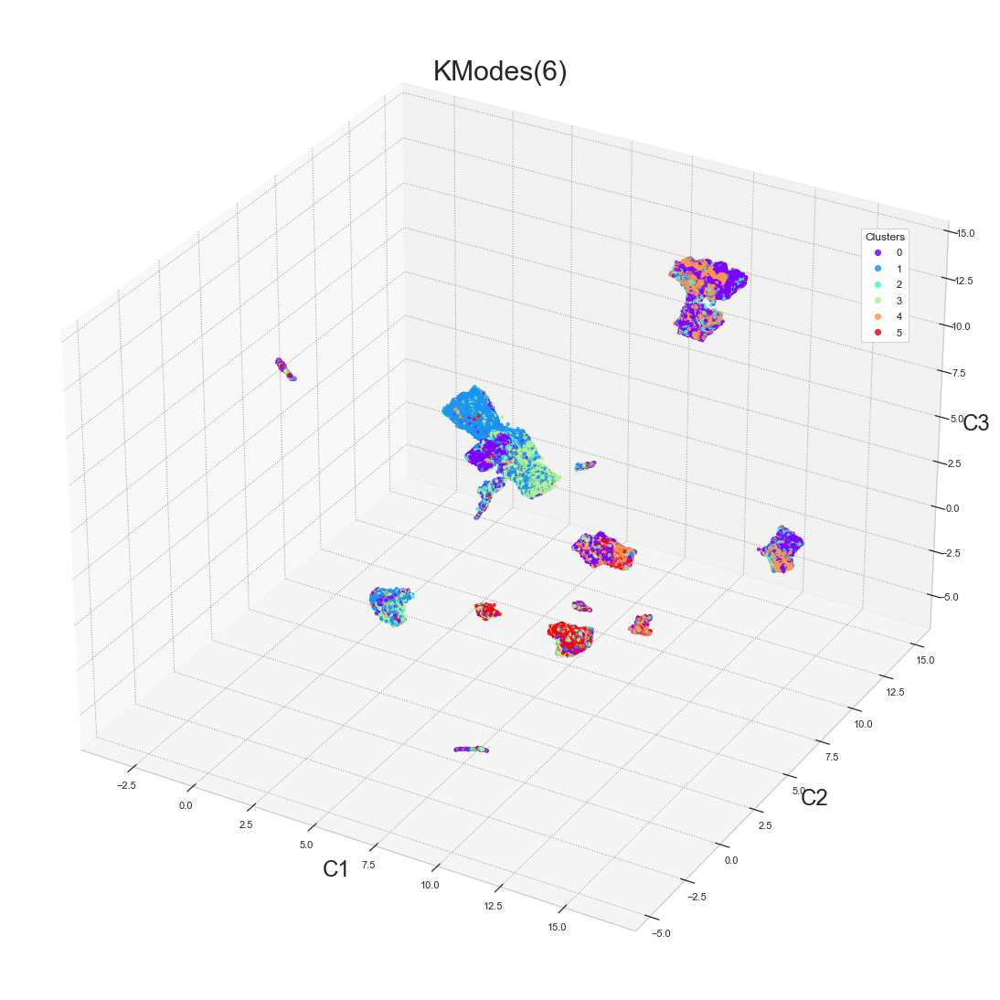

-------------------- KModes(7) --------------------
Model                      KModes(7)
Calinski-Harabasz(Var)    259.216482
Davies-Bouldin(Sim)        14.248127
Silhouette                 -0.032492
Time(s)                   133.792883
hue                               df
Name: 915, dtype: object


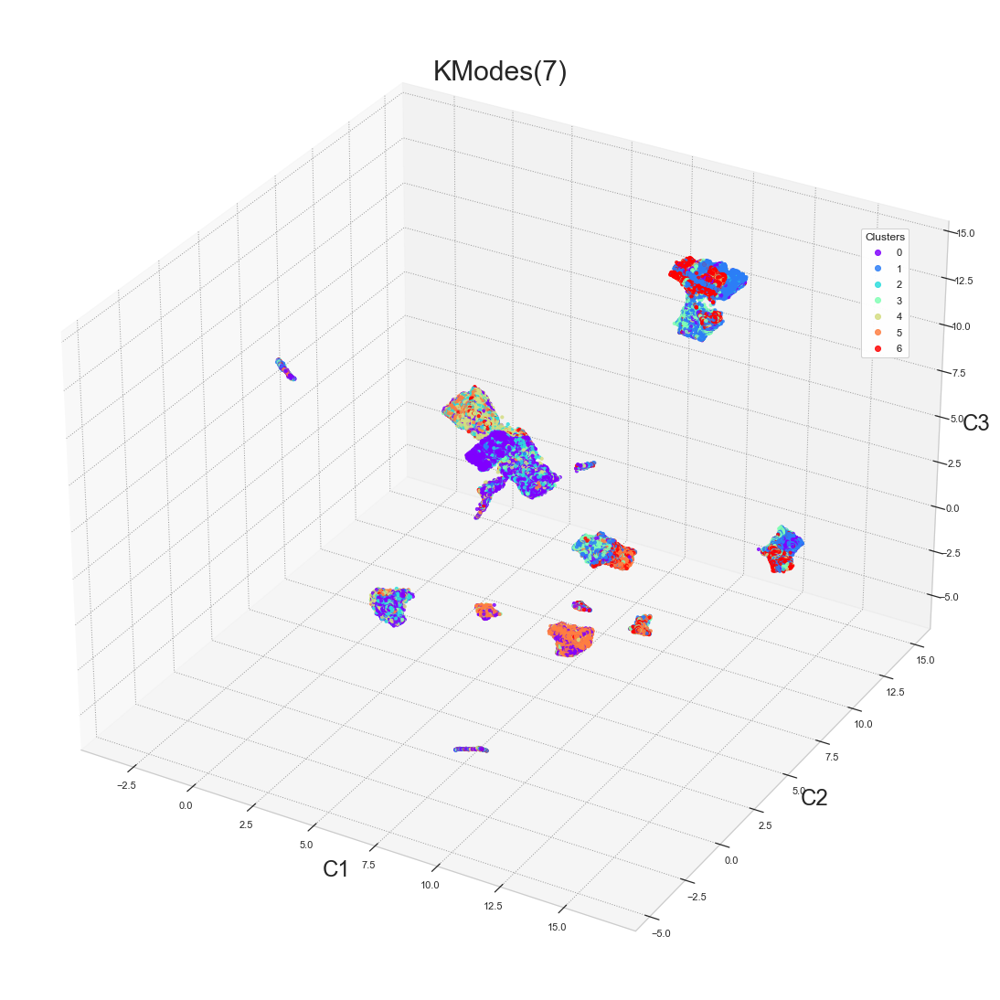

-------------------- KModes(8) --------------------
Model                      KModes(8)
Calinski-Harabasz(Var)    274.975691
Davies-Bouldin(Sim)        12.127868
Silhouette                 -0.035942
Time(s)                   143.248594
hue                               df
Name: 916, dtype: object


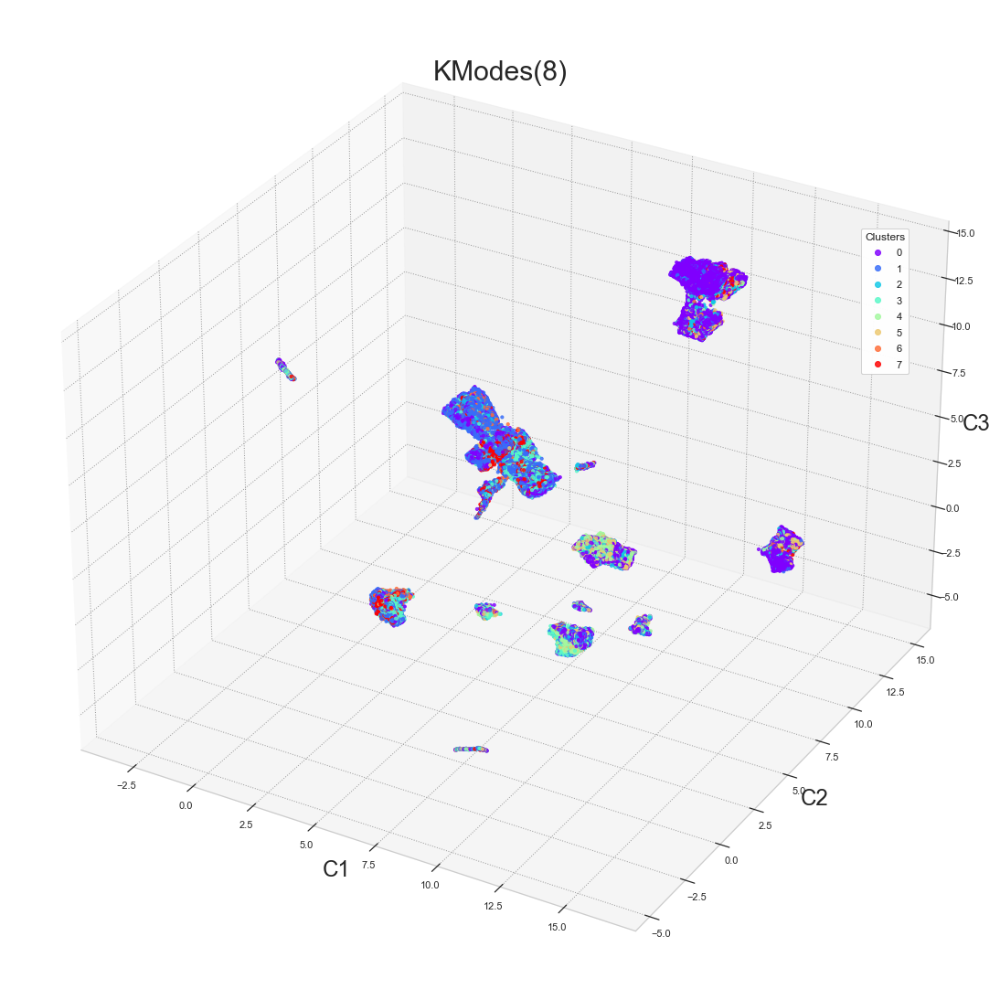

-------------------- KModes(9) --------------------
Model                      KModes(9)
Calinski-Harabasz(Var)    251.233785
Davies-Bouldin(Sim)        11.195516
Silhouette                 -0.043064
Time(s)                   163.481062
hue                               df
Name: 917, dtype: object


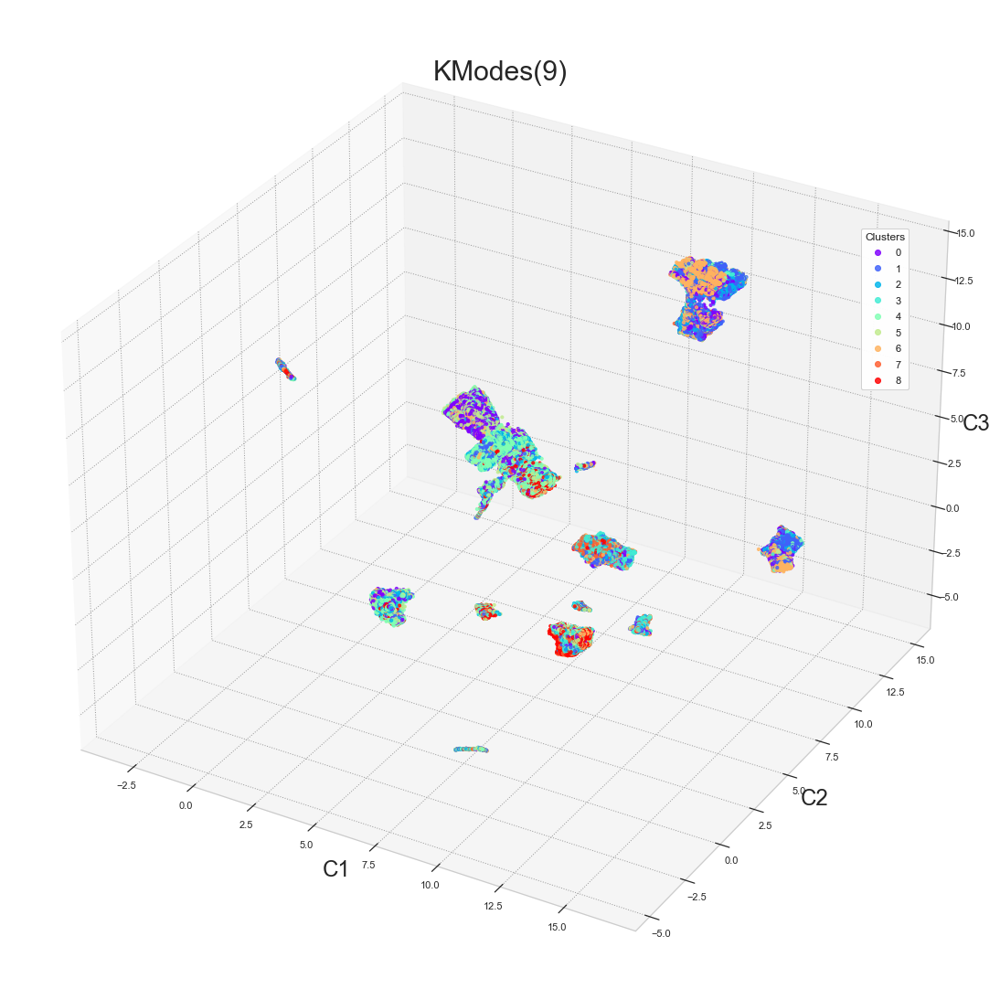

-------------------- KModes(10) --------------------
Model                     KModes(10)
Calinski-Harabasz(Var)    176.445103
Davies-Bouldin(Sim)        11.611868
Silhouette                 -0.033884
Time(s)                    178.89678
hue                               df
Name: 918, dtype: object


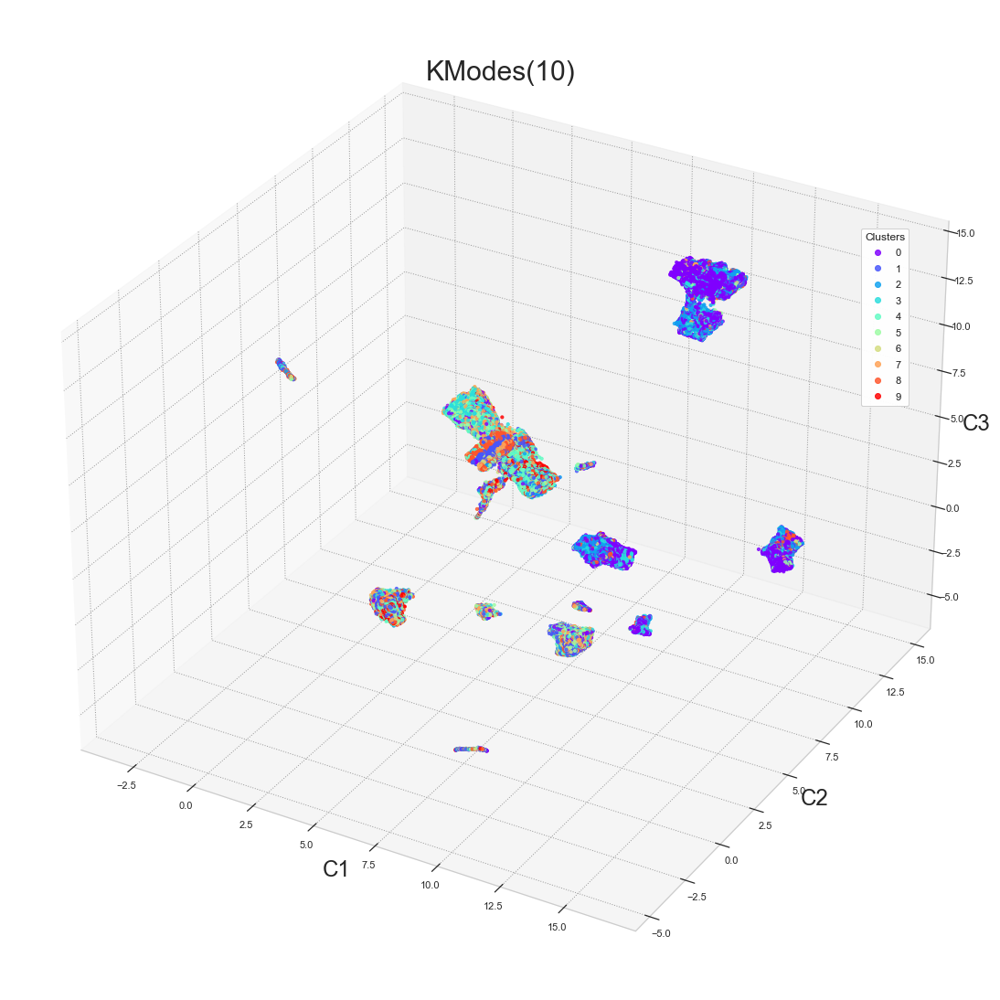

-------------------- KModes(11) --------------------
Model                     KModes(11)
Calinski-Harabasz(Var)    194.057359
Davies-Bouldin(Sim)        11.861712
Silhouette                 -0.049606
Time(s)                    162.91149
hue                               df
Name: 919, dtype: object


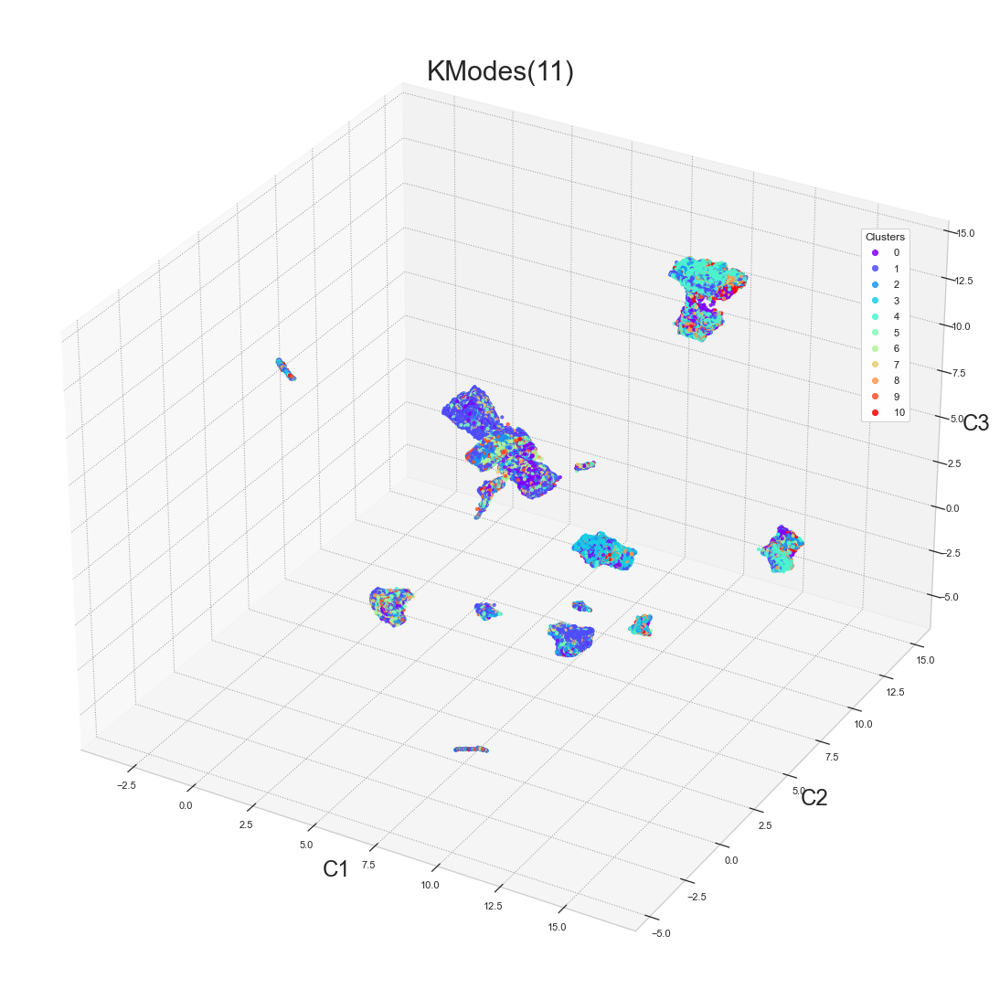

-------------------- KModes(12) --------------------
Model                     KModes(12)
Calinski-Harabasz(Var)    209.810001
Davies-Bouldin(Sim)         10.98665
Silhouette                 -0.056202
Time(s)                   192.965935
hue                               df
Name: 920, dtype: object


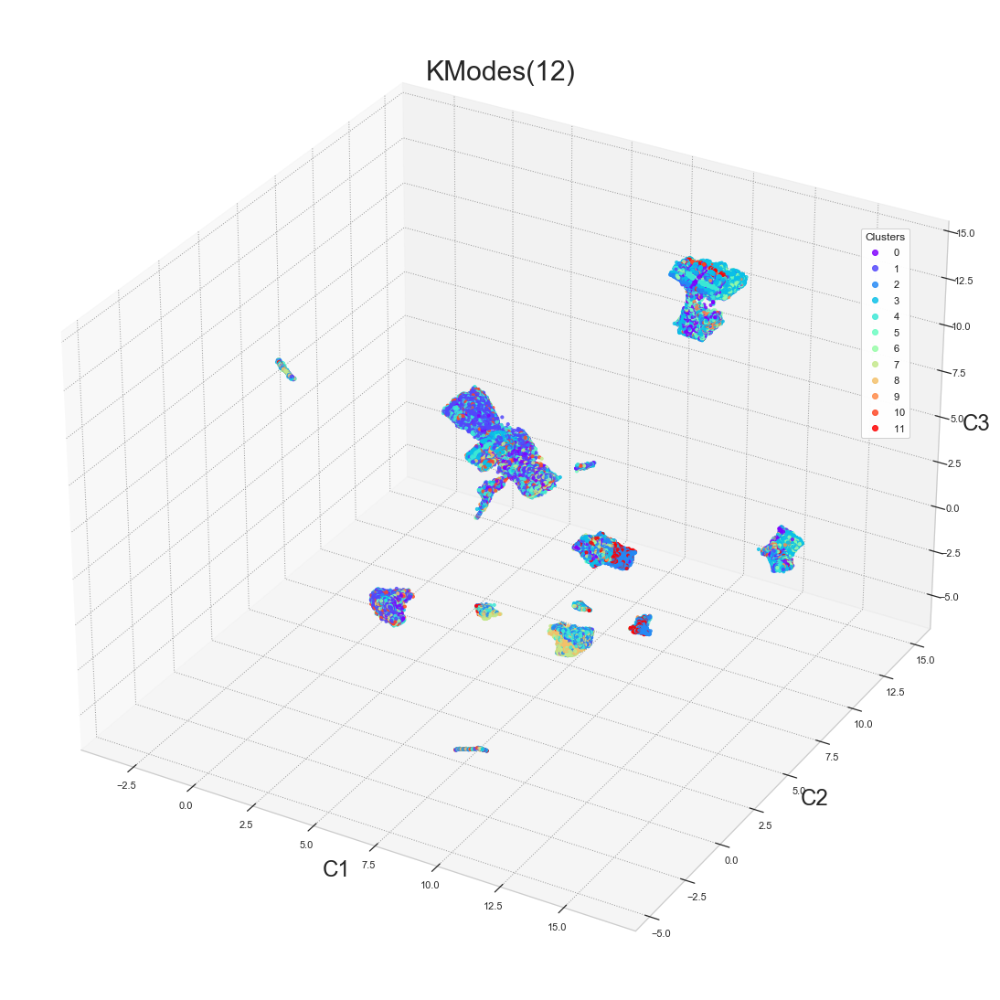

-------------------- KModes(13) --------------------
Model                     KModes(13)
Calinski-Harabasz(Var)    221.784959
Davies-Bouldin(Sim)         9.405966
Silhouette                 -0.053709
Time(s)                   224.818055
hue                               df
Name: 921, dtype: object


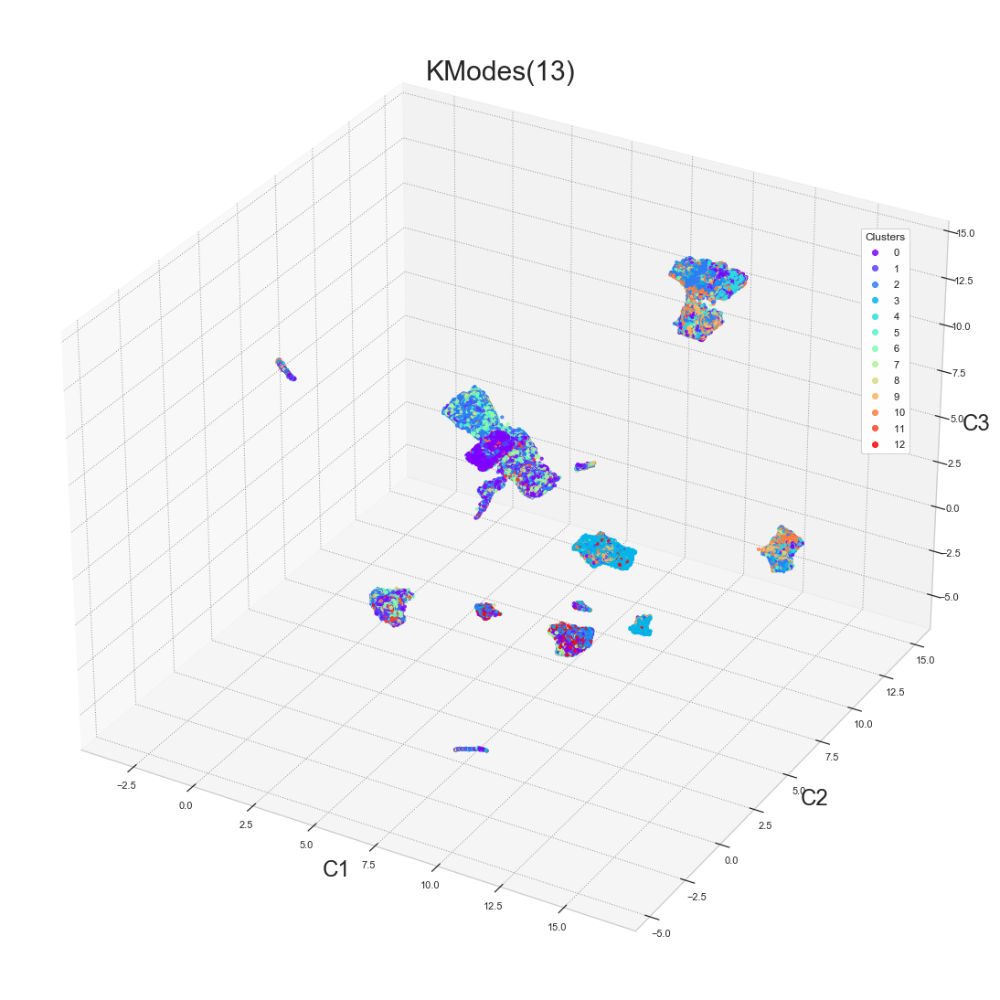

In [18]:
kmodes = []
for i in range(n_iter):
    for k in range(kmin, kmax+1):
        cls = clustering(data, KModes(n_jobs = -1, n_clusters = k, init = 'Huang', random_state = None), 'KModes('+str(k)+')', projection, Perfs, scale=scale, scores=scores, hue=hue, display_components=display_components)
        kmodes.append(cls)


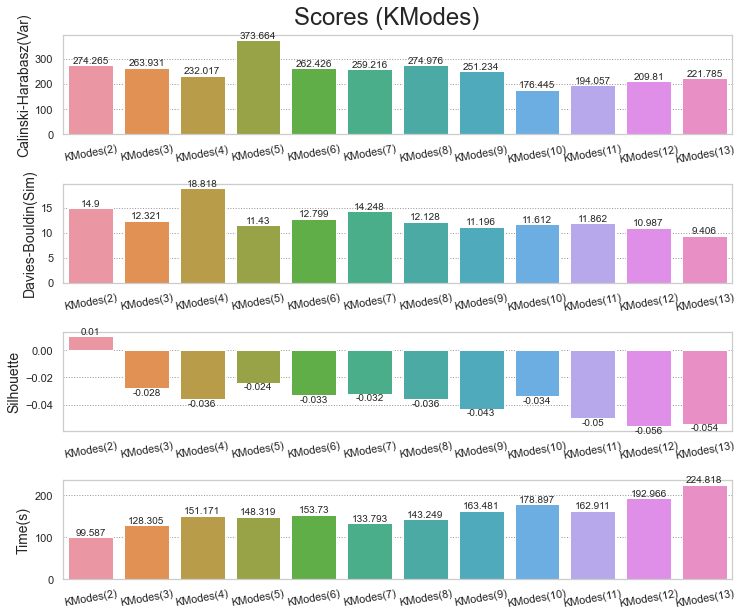

In [169]:
display_scores(Perfs[Perfs['Model'].str.startswith('KModes')], y='KModes', width=12, height =10, rotation=10, hspace=0.5)

KModes ne semble pas pouvoir distinguer les différents groupes de données.

In [150]:
best_models.append('KModes(4)')

## 2.5. KPrototype

Ce deuxième algorithme, prend en charge les données mixtes (catégorielles et numériques)en combinant un KMeans classique sur les données numérique avec un KModes sur les données catégorielles.

In [28]:
# préparation des données pour le clustering
X = data.iloc[:, 1:]
categs = ['multi_orders(F)', 'payment_value(M)', 'daytime', 'weekday', 'month', 'review_score(S)', 'pcateg', 'payment_type', 'customer_state']
catColumnsPos = [X.columns.get_loc(col) for col in categs]

-------------------- KPrototypes(2) --------------------
Model                     KPrototypes(2)
Calinski-Harabasz(Var)        4498.23164
Davies-Bouldin(Sim)             3.073004
Silhouette                      0.127948
Time(s)                       313.419056
hue                                   df
Name: 922, dtype: object


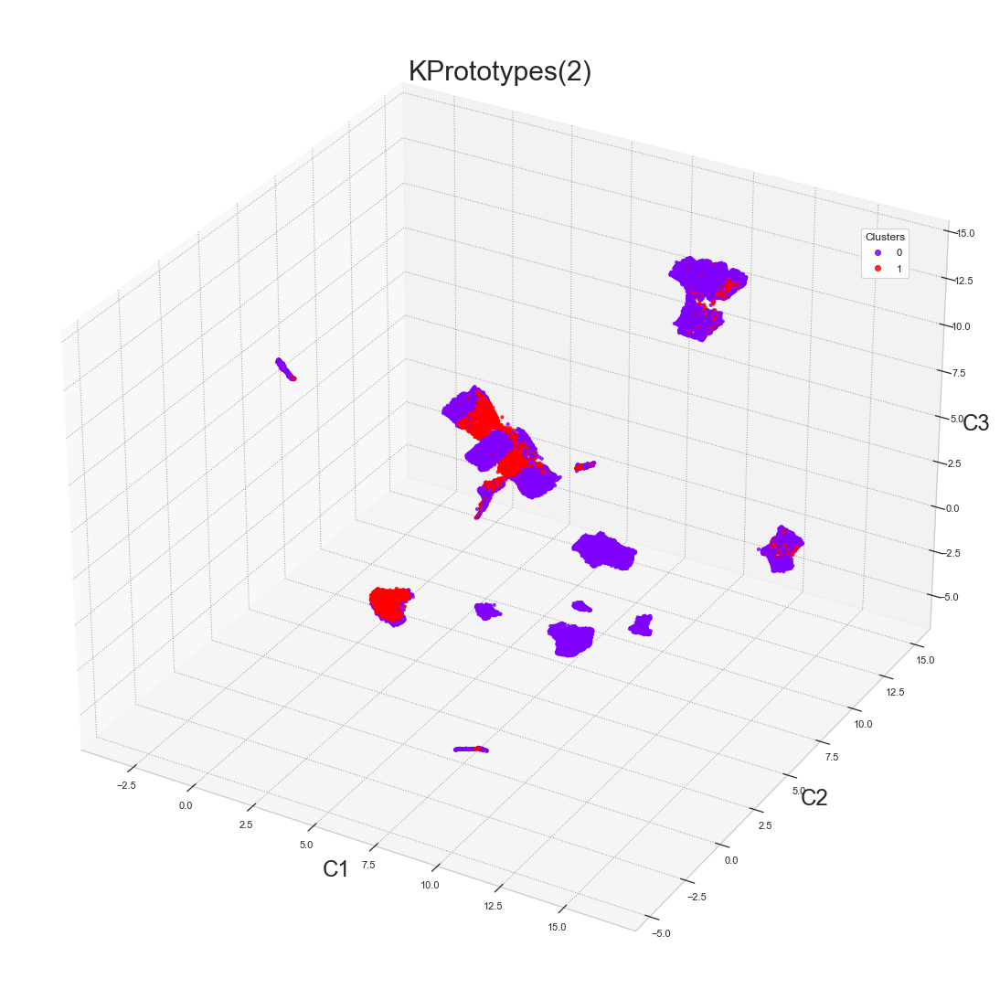

-------------------- KPrototypes(3) --------------------
Model                     KPrototypes(3)
Calinski-Harabasz(Var)       2761.315509
Davies-Bouldin(Sim)             4.975424
Silhouette                      0.035995
Time(s)                       439.690876
hue                                   df
Name: 923, dtype: object


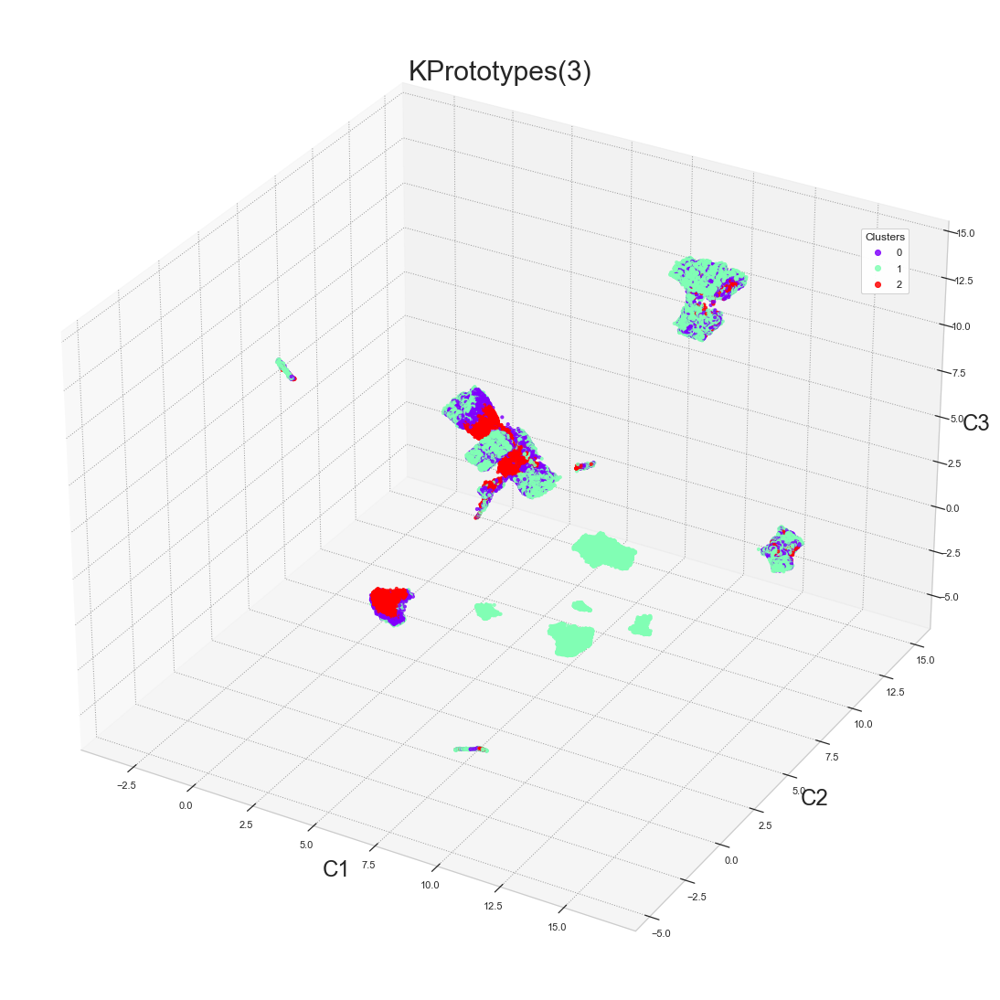

-------------------- KPrototypes(4) --------------------
Model                     KPrototypes(4)
Calinski-Harabasz(Var)       1919.107916
Davies-Bouldin(Sim)             6.868904
Silhouette                      0.010603
Time(s)                        462.76678
hue                                   df
Name: 924, dtype: object


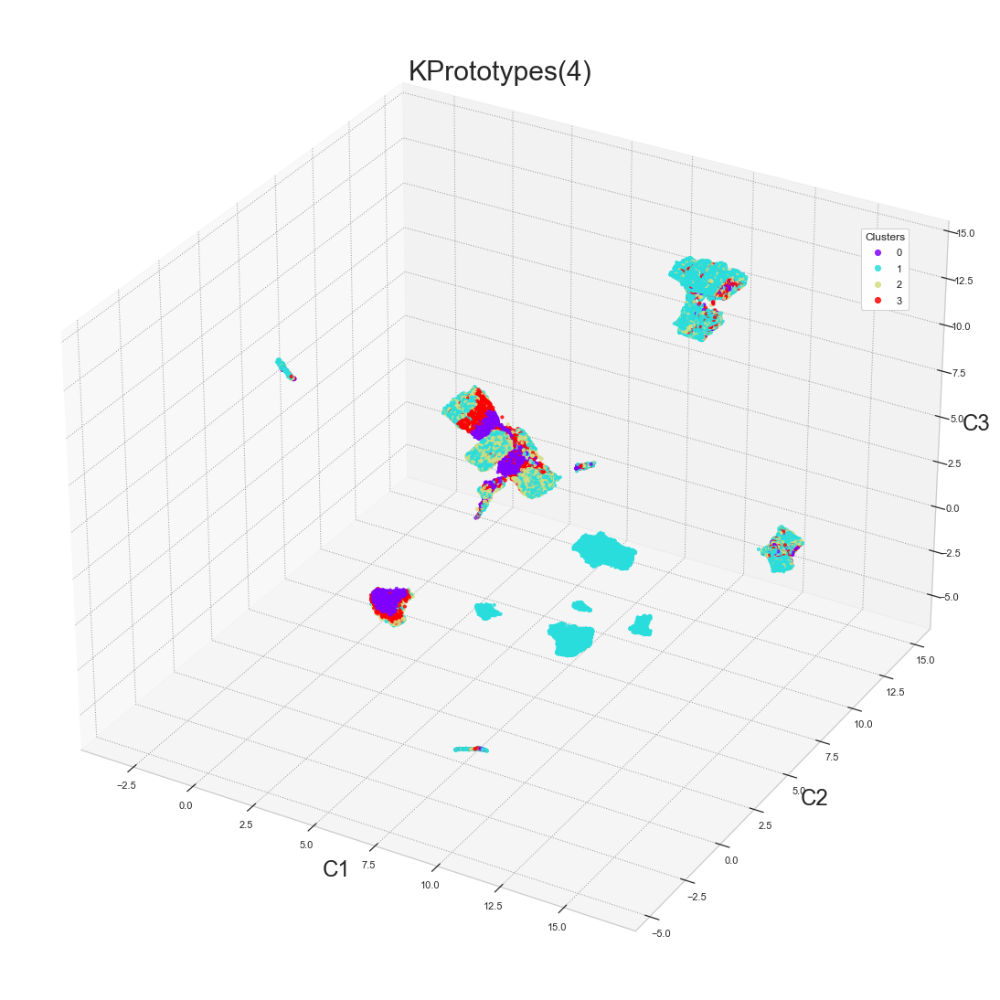

-------------------- KPrototypes(5) --------------------
Model                     KPrototypes(5)
Calinski-Harabasz(Var)       1474.699128
Davies-Bouldin(Sim)            11.149451
Silhouette                      0.005901
Time(s)                        475.87344
hue                                   df
Name: 925, dtype: object


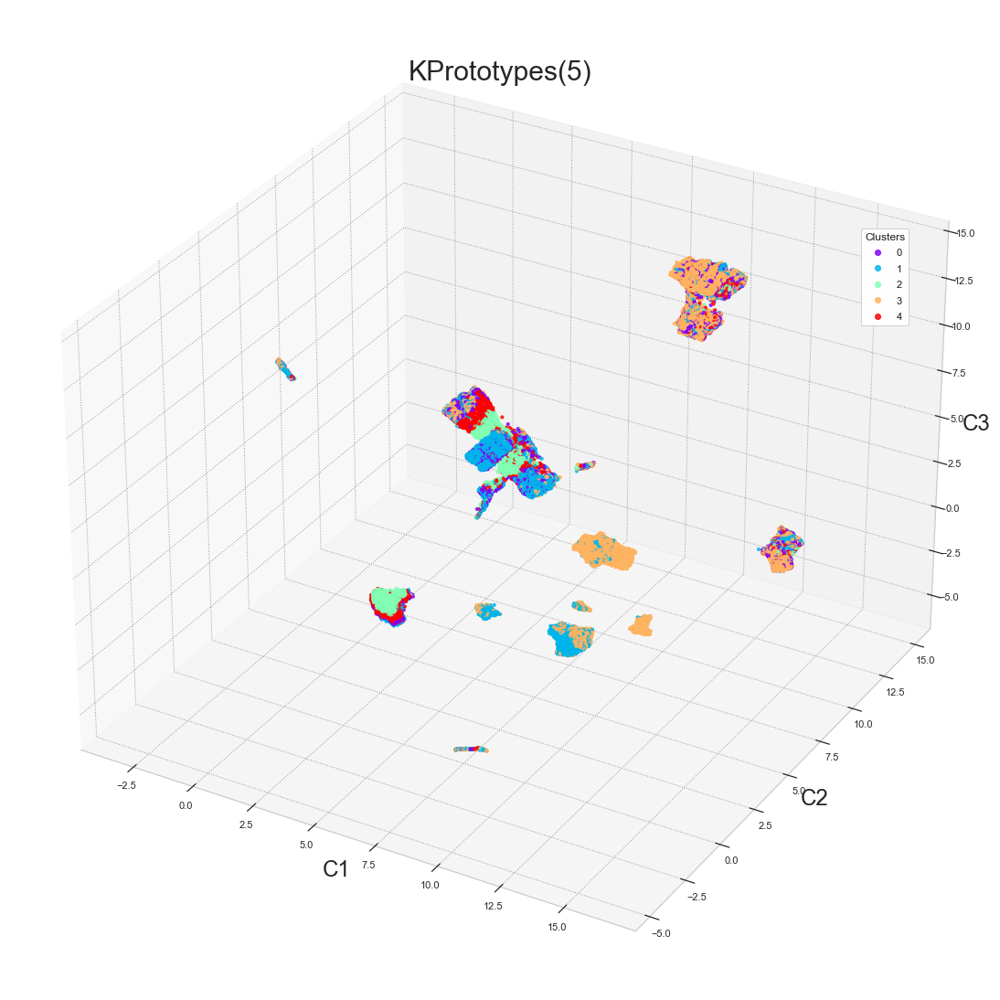

-------------------- KPrototypes(6) --------------------
Model                     KPrototypes(6)
Calinski-Harabasz(Var)       1215.835724
Davies-Bouldin(Sim)            10.324356
Silhouette                      0.005363
Time(s)                       620.086454
hue                                   df
Name: 926, dtype: object


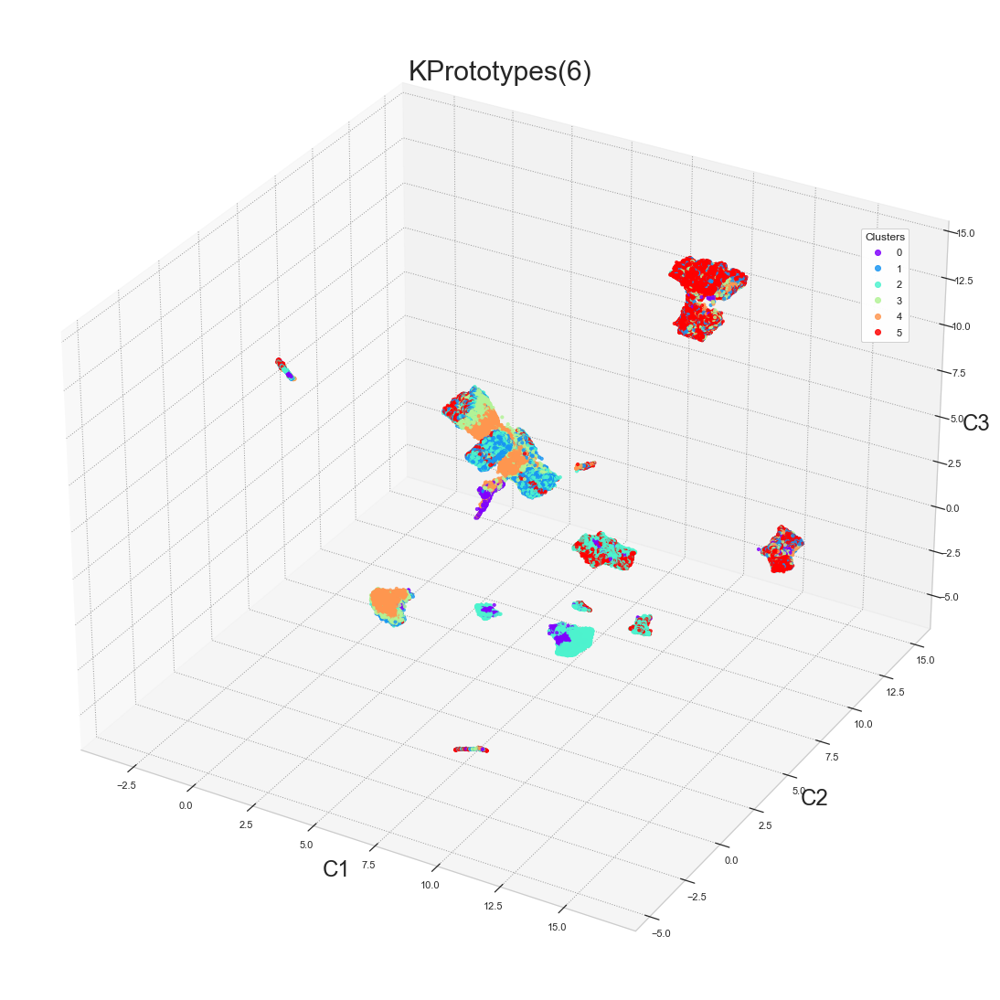

-------------------- KPrototypes(7) --------------------
Model                     KPrototypes(7)
Calinski-Harabasz(Var)       1036.953894
Davies-Bouldin(Sim)            10.158115
Silhouette                      0.002256
Time(s)                       545.436874
hue                                   df
Name: 927, dtype: object


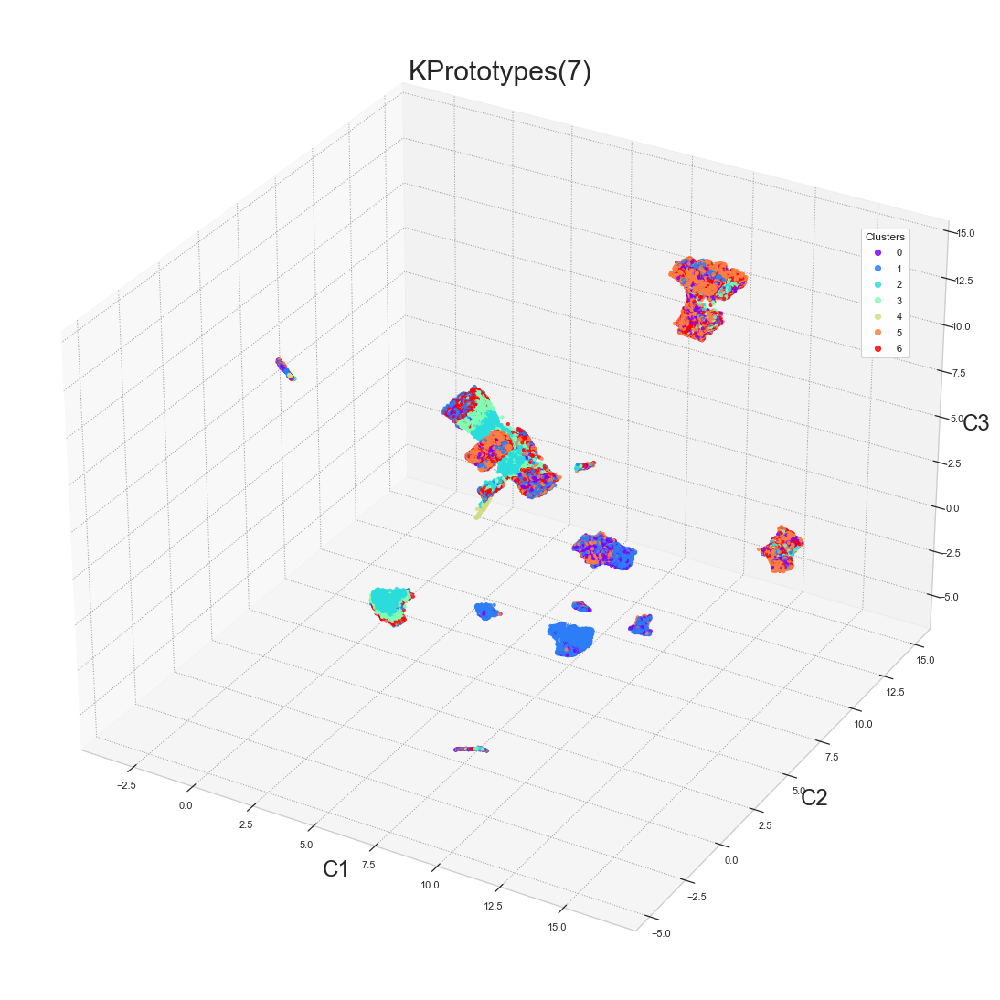

-------------------- KPrototypes(8) --------------------
Model                     KPrototypes(8)
Calinski-Harabasz(Var)        898.831851
Davies-Bouldin(Sim)            10.245443
Silhouette                     -0.001695
Time(s)                       769.101727
hue                                   df
Name: 928, dtype: object


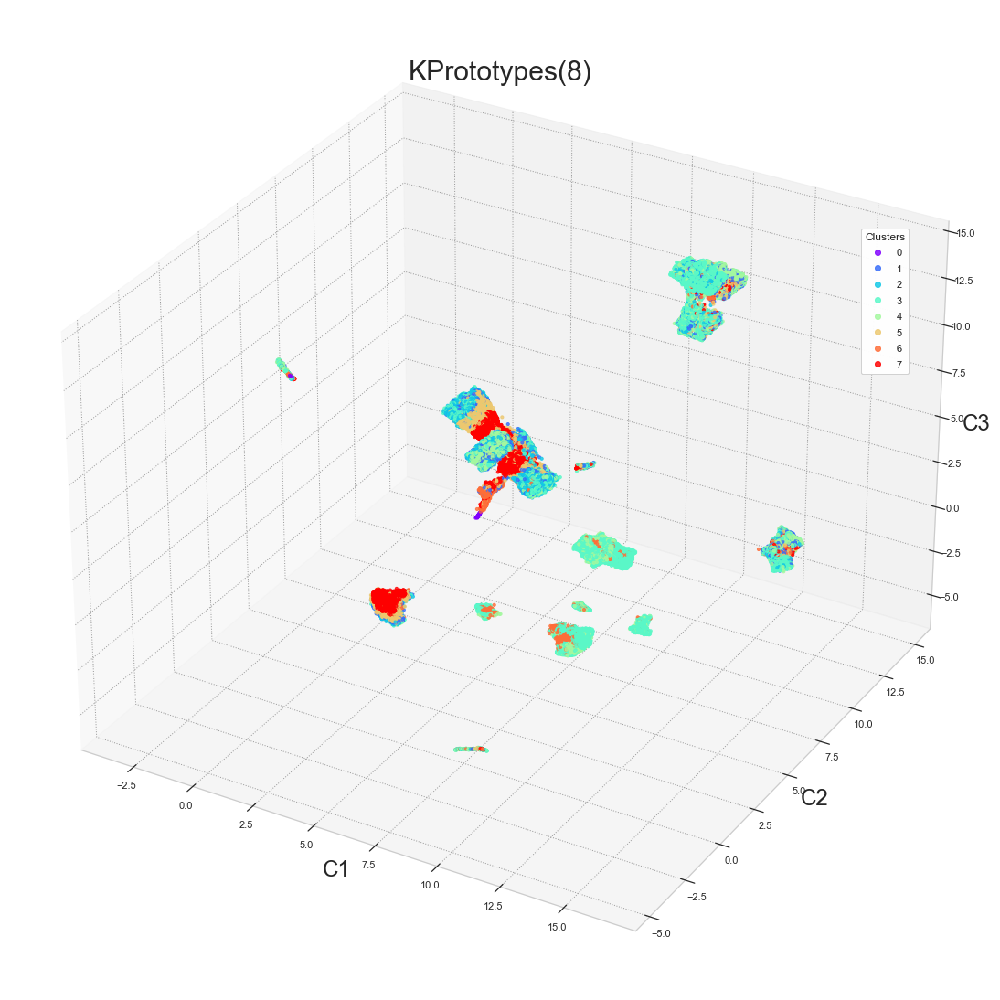

-------------------- KPrototypes(9) --------------------
Model                     KPrototypes(9)
Calinski-Harabasz(Var)        805.861176
Davies-Bouldin(Sim)            12.800959
Silhouette                     -0.007845
Time(s)                       613.255155
hue                                   df
Name: 929, dtype: object


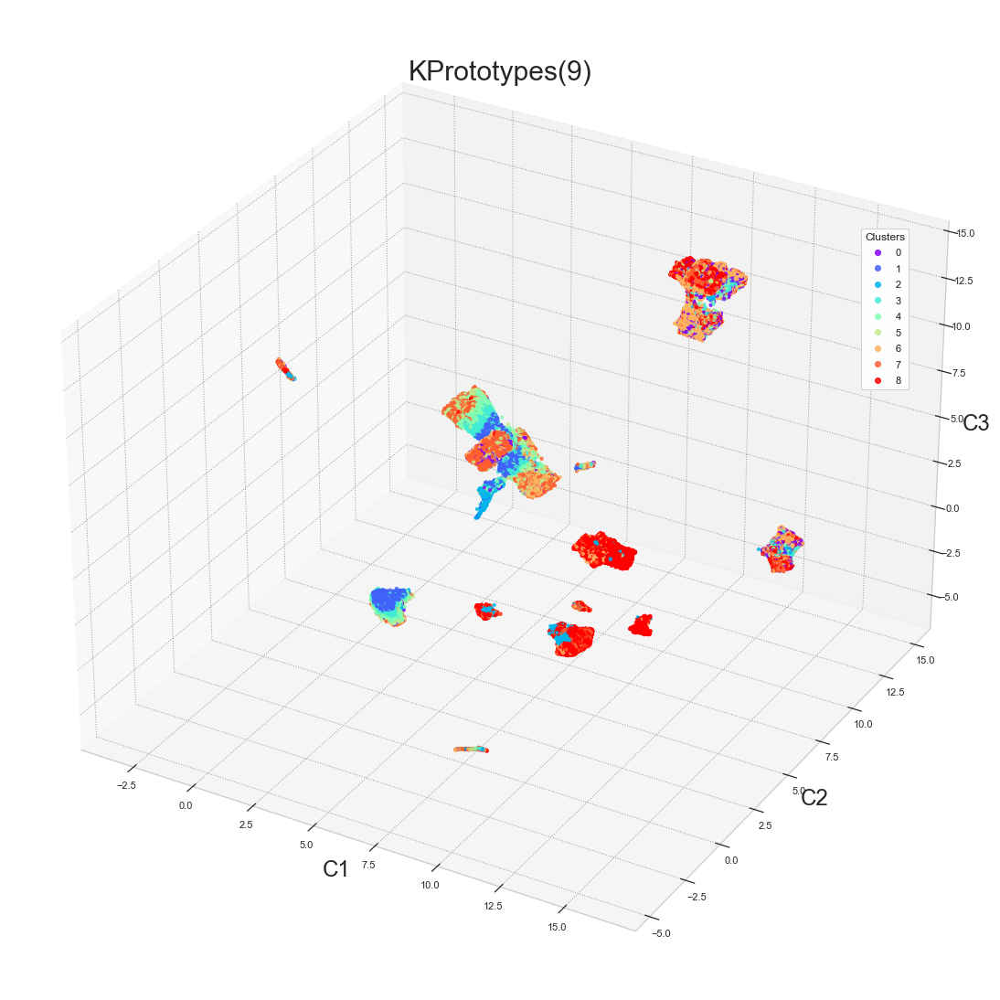

-------------------- KPrototypes(10) --------------------
Model                     KPrototypes(10)
Calinski-Harabasz(Var)         731.410015
Davies-Bouldin(Sim)             11.218519
Silhouette                      -0.006101
Time(s)                        758.681389
hue                                    df
Name: 930, dtype: object


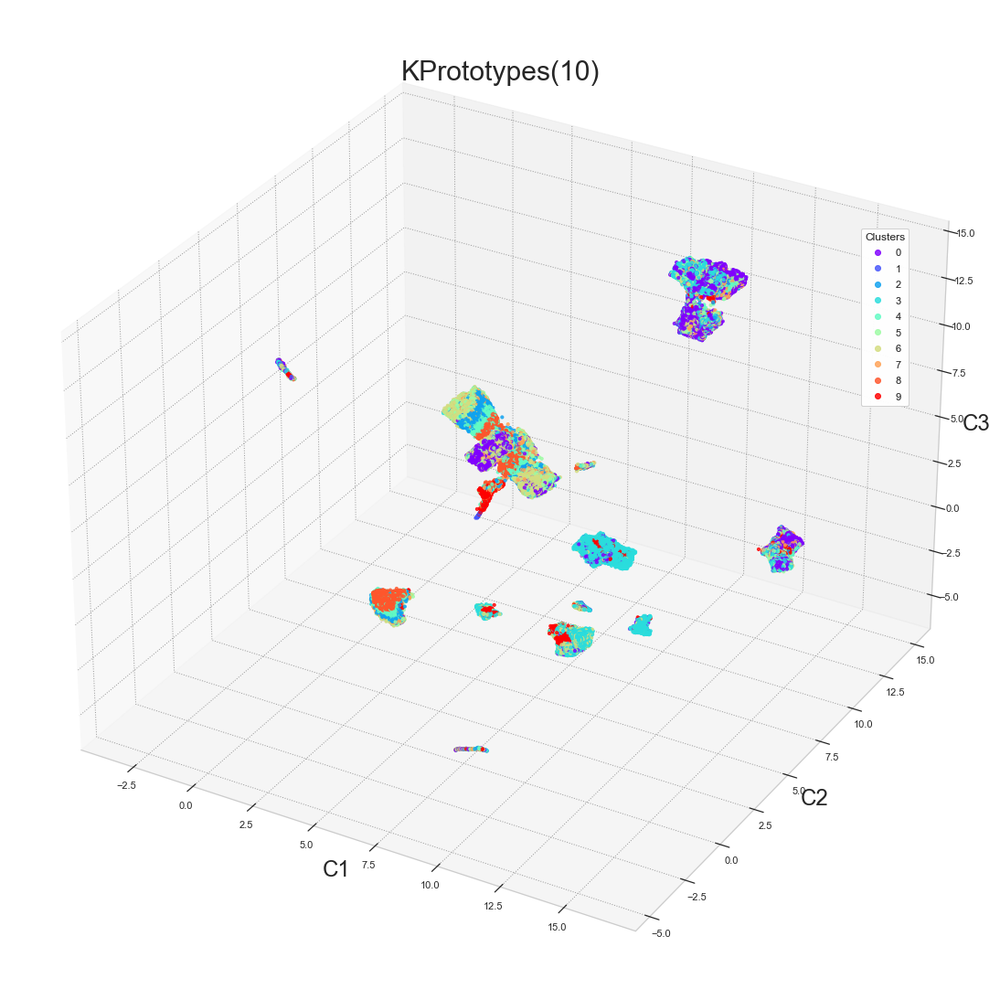

-------------------- KPrototypes(11) --------------------
Model                     KPrototypes(11)
Calinski-Harabasz(Var)         701.602624
Davies-Bouldin(Sim)              9.941161
Silhouette                      -0.017098
Time(s)                        887.153904
hue                                    df
Name: 931, dtype: object


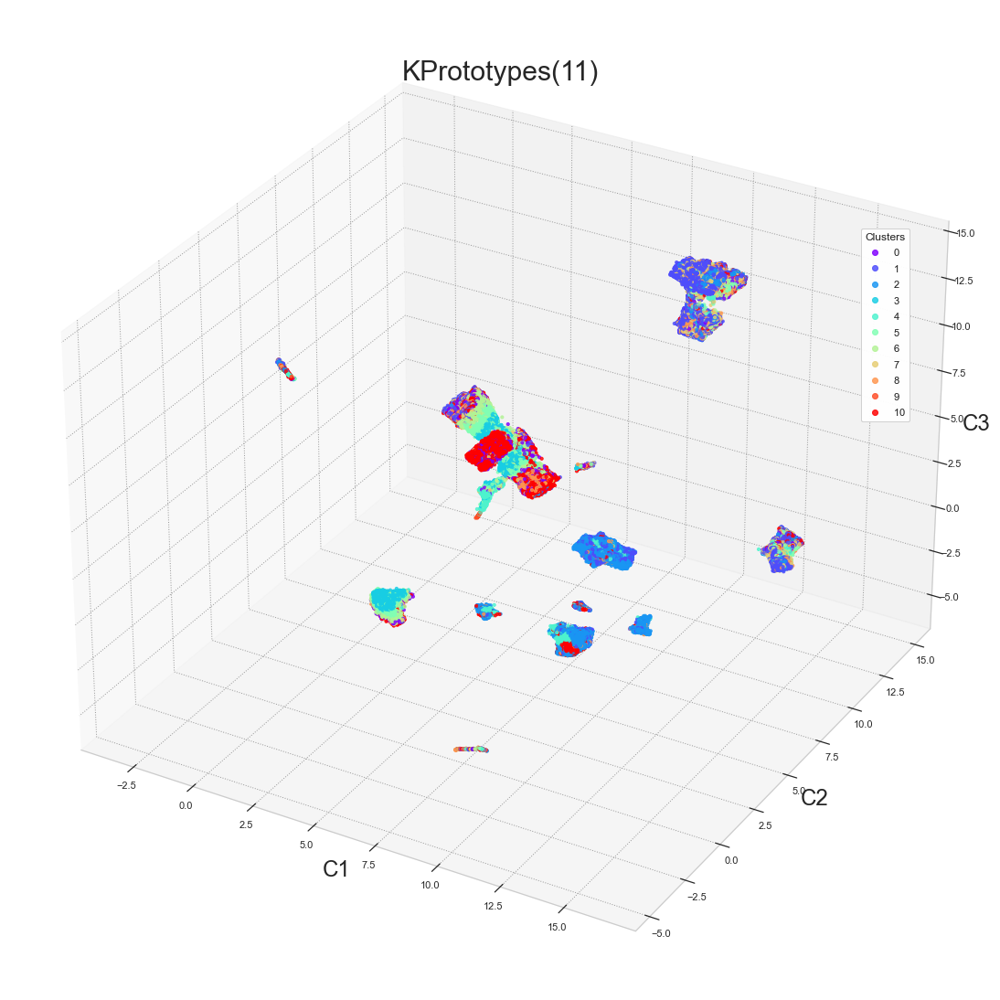

-------------------- KPrototypes(12) --------------------
Model                     KPrototypes(12)
Calinski-Harabasz(Var)         630.880085
Davies-Bouldin(Sim)             11.323038
Silhouette                      -0.017142
Time(s)                        958.960141
hue                                    df
Name: 932, dtype: object


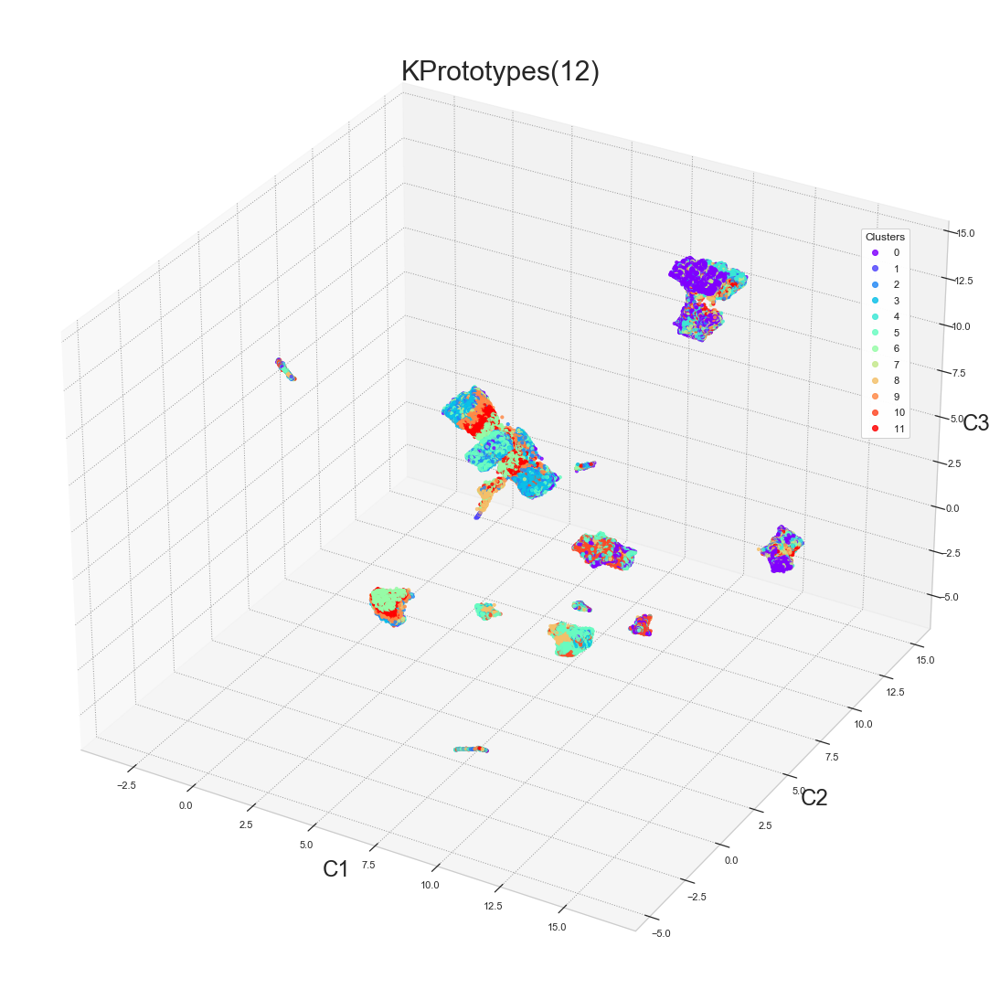

-------------------- KPrototypes(13) --------------------
Model                     KPrototypes(13)
Calinski-Harabasz(Var)         597.961176
Davies-Bouldin(Sim)              10.32076
Silhouette                      -0.029233
Time(s)                        970.808588
hue                                    df
Name: 933, dtype: object


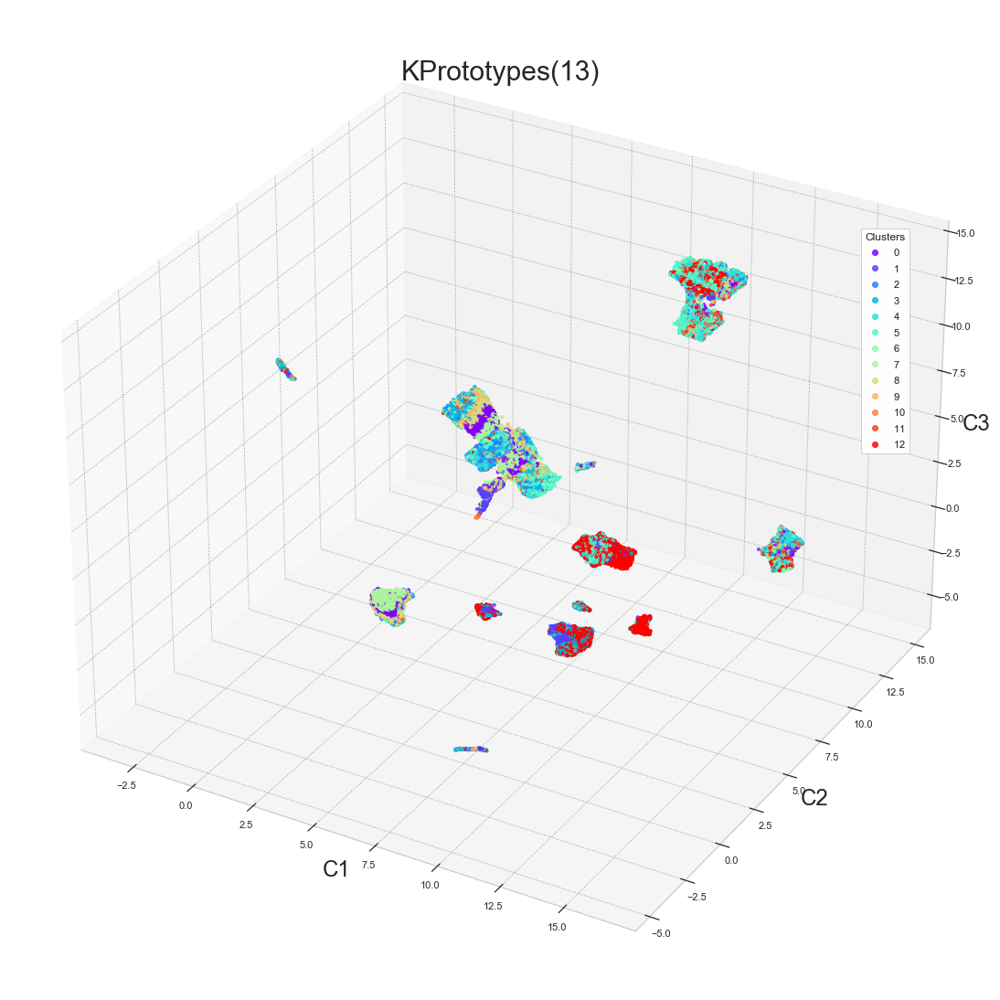

In [36]:
kprototypes = []
for i in range(n_iter):
    for k in range(kmin, kmax+1):
        cls = clustering(data, KPrototypes(n_jobs = -1, n_clusters = k, init = 'Huang', random_state = None), 'KPrototypes('+str(k)+')', projection, Perfs, scale=scale, scores=scores, hue=hue, display_components=display_components, categories=catColumnsPos)
        kprototypes.append(cls)

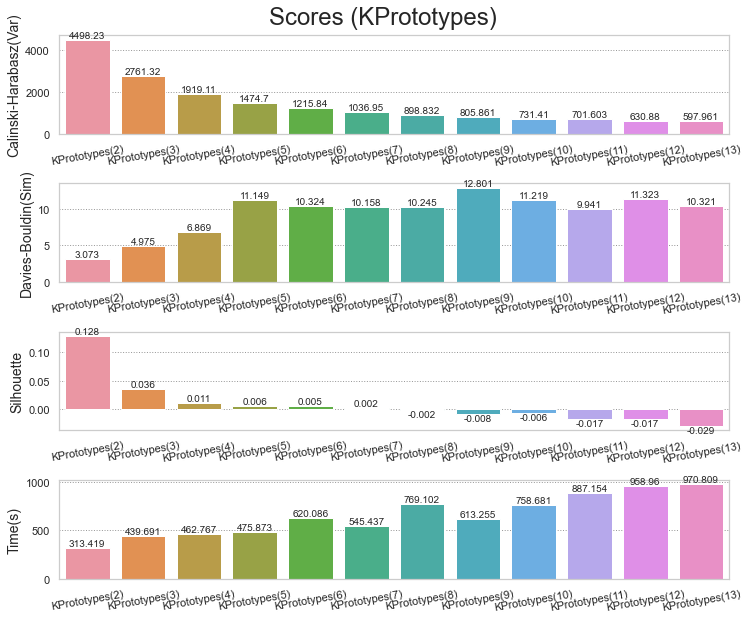

In [170]:
display_scores(Perfs[Perfs['Model'].str.startswith('KPrototypes')], y='KPrototypes', width=12, height =10, rotation=10, hspace=0.5)

In [151]:
best_models.append('KPrototypes(4)')

<p>KPrototypes présente une segmentation légèrement meilleure à KModes. Cela est due à la partie KMeans de l’algorithme.</p>
<p>KModes et KPrototypes seront comparés entres eux et avec tous les autres algorithmes dans la section suivantes.</p>

## 2.6. Comparaison

Maintenant que tous les algorithmes choisis ont été exécutés, on passe à la comparaison de leurs scores et ce sur les meilleurs modèles (segmentation) qu’il génèrent.

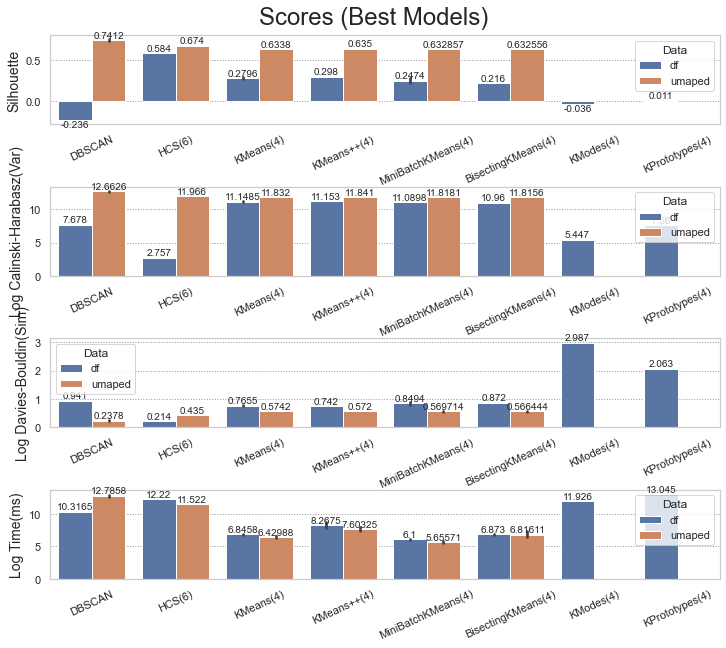

In [174]:
%matplotlib inline
# On passe au log pour une meilleure visibilité et comparaisons des scores
Log_Perfs = Perfs.copy()
Log_Perfs['Log Calinski-Harabasz(Var)'] = np.log(Perfs['Calinski-Harabasz(Var)'])
Log_Perfs['Log Davies-Bouldin(Sim)'] = np.log(Perfs['Davies-Bouldin(Sim)']+1)
Log_Perfs['Log Time(ms)'] = np.log(Perfs['Time(s)']*1000)
Log_Perfs = Log_Perfs.drop(columns=['Time(s)', 'Calinski-Harabasz(Var)', 'Davies-Bouldin(Sim)'])
display_scores((Log_Perfs[Log_Perfs['Model'].isin(best_models)]), y='Best Models', hue='Data', width=12, height =10, rotation=25, hspace=0.7)

<p>Le clustering par densité (DBSCAN) et agglomération (HCS) produit, avec une forte complexité temporelle, une première segmentation pertinente mais qui nécessite un post-traitement manuel afin d’affiner (réduire) les résultats proposés.</p>
<p>En ce qui concerne les données catégorielles (KModes) et mixtes (KPrototypes), n’ont pas pu distinguer les groupes de données. Cela se traduit par les plus mauvais scores, même si KPrototypes est légèrement meilleur que KModes.</p>
<p>Les algorithmes de la famille KMeans, donnent les meilleurs scores. En particulier MiniBatchKMeans ++, qui est une variante plus stable et plus faible en complexité temporelle que le KMeans standard, offre le meilleur compromis entre qualité de la segmentation et le temps d’exécution.</p>
<p>De plus, tous les algorithmes précédents performent bien sur les données réduites dimensionnellement par UMAP que sur les données non-réduites, grâce à l’exhibition de groupes denses éloignés et hétérogène par UMAP.</p>
<p>Ainsi, le meilleur modèle de segmentation retenu est celui généré par MiniBatchKMeans ++ avec 4 clusters (k=4).</p>


In [176]:
Perfs.to_csv('Perfs.csv', index=False)

In [168]:
best_k=4

# 3. Evaluation & Interprétabilité

Cette troisième et dernière partie s’articule autour de l’évaluation du modèle sélectionné et l’interprétation de sa segmentation.

## 3.1. Evaluation

### 3.1.1. Stabilité Algorithmique

<p>Le premier à évaluer et la consistance des résultats i.e. le modèle produit toujours la même segmentation. Autrement dit, on veut montrer que le hasard à chaque exécution n’influe pas sur le résultat.</p>
<p>Pour ce faire, on réexécute le modèle plusieurs fois et ce pour plusieurs valeurs de la seed du générateur aléatoire.</p>

In [ ]:
scores = ['Calinski-Harabasz(Var)', 'Davies-Bouldin(Sim)', 'Silhouette']
Perfs_seeds = pd.DataFrame(columns=['Model']+scores, index=[])
meta_cls_seeds = []
n_seeds = 10
n_iter = 2

for j in range(n_iter):
    cls_seeds = []
    for i in range(n_seeds):        
        cls = clustering(data, MiniBatchKMeans(n_clusters=best_k, random_state=i, init='k-means++', tol=0.001, batch_size = 2048), 'MiniBatchKMeans++('+str(i)+')', umaped, Perfs_seeds, scale=scale, scores=scores, hue=hue, display_components=0)
        cls_seeds.append(cls)
    meta_cls_seeds.append(cls_seeds)

Une fois les réexécutions effectuées, on calcul la matrice des ARI pour chaque pair de valeurs de seed.

In [183]:
n_rept = len(meta_cls_seeds)
ARIs = np.zeros((n_seeds, n_seeds))

for h in range(n_rept):
    cls_seeds = meta_cls_seeds[h]
    for i in range(n_seeds):
        for j in range(n_seeds):
            ARIs[i,j] += adjusted_rand_score(cls_seeds[i].labels_, cls_seeds[j].labels_)
ARIs /= n_rept

In [ ]:
On affiche cette matrice avec une heatmap.

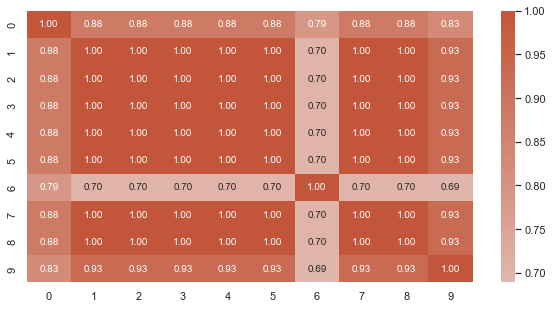

In [191]:
fig, ax = plt.subplots(figsize=(10, 5))
ax = sns.heatmap(ARIs, vmax=1, center=0.5, annot=True, fmt=".2f", cmap = sns.diverging_palette(230, 20, as_cmap=True))
plt.show()

Sur 10 valeurs de seed, la segmentation produite est quasiment identique à chaque fois. Donc ce modèle est très stable algorithmiquement parlant.

## 3.1.2. ROC & AUC

<p>Maintenant on s’intéresse à la reproductibilité de cette segmentation et de son potentiel prédictif du profil/groupe de nouveaux clients.</p>
<p>Ainsi, un modèle supervisé en OneVsAll est entrainé à prédire le cluster d’un individu.</p>

In [556]:
data = pd.read_csv('olist.csv', low_memory=low_memory)
model = clustering(pd.DataFrame(umaped, columns=['C'+str(i) for i in range (1,4)]), MiniBatchKMeans(n_clusters=best_k, random_state=None, init='k-means++', tol=0.0001, batch_size = 1024*2), 'MiniBatchKMeans++', umaped, None, scale=scale, scores=scores, hue=hue, display_components=0)
data['Cluster'] = model.labels_

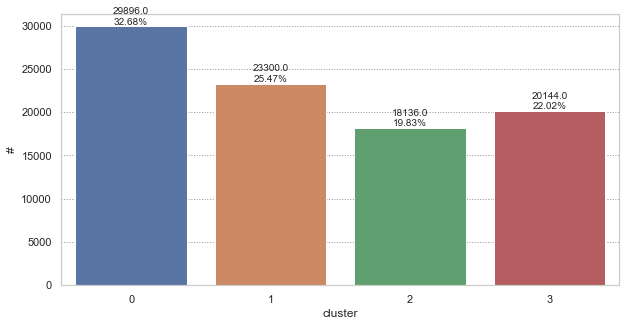

In [546]:
clusters = data.groupby('Cluster').count().iloc[:,0]
barplot(x=clusters.index.tolist(), y=clusters, ylabel='#', xlabel='cluster')

In [548]:
from sklearn.multiclass import OneVsRestClassifier
from sklearn.ensemble import  HistGradientBoostingClassifier
from sklearn.metrics import roc_curve, auc
from sklearn.preprocessing import label_binarize
from itertools import cycle

# Sélection des attributs
XCols = colsOfType(data)
y = 'Cluster'
# Binarize the output
data = data.sort_values(by=[y])
X = data.iloc[:,1:-1]
y = label_binarize(data[y], classes=data[y].unique().tolist())
n_classes = y.shape[1]
# shuffle and split training and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=0)
X_train=Std_Scaled(X_train)
X_test=Std_Scaled(X_test)

# Sélection des scores pour l'évaluation des modèles
score_cv = 'roc_auc_ovr_weighted'

param_grid = {'random_state':np.arange(5), 'l2_regularization': np.logspace(-2, 2, 5), 'learning_rate': np.logspace(-4, -1, 4), 'max_depth':np.arange(1,5)}
cv_hgbc = RandomizedSearchCV(
        HistGradientBoostingClassifier(),  
        param_grid,     # hyperparamètres à tester
        cv=5,           # nombre de folds de validation croisée
        scoring=score_cv,   # score à optimiser
        n_jobs=-1
    )

# Learn to predict each class against the other
classifier = OneVsRestClassifier(cv_hgbc, n_jobs=-1)
y_score = classifier.fit(X_train, y_train).decision_function(X_test)

Une fois le modèle supervisé entrainé, on évalue sa puissance prédictif avec le score AUC.

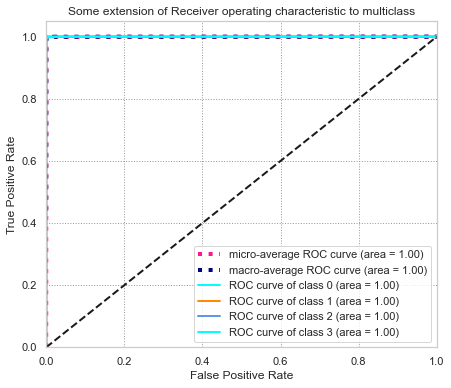

In [549]:
# Compute ROC curve and ROC area for each class
fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test[:, i], y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

# Compute micro-average ROC curve and ROC area
fpr["micro"], tpr["micro"], _ = roc_curve(y_test.ravel(), y_score.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])
# First aggregate all false positive rates
all_fpr = np.unique(np.concatenate([fpr[i] for i in range(n_classes)]))

# Then interpolate all ROC curves at this points
mean_tpr = np.zeros_like(all_fpr)
for i in range(n_classes):
    mean_tpr += np.interp(all_fpr, fpr[i], tpr[i])

# Finally average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = all_fpr
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])

# Plot all ROC curves
lw=2
plt.figure(figsize=(7, 6))

plt.plot(fpr["micro"], tpr["micro"], label="micro-average ROC curve (area = {0:0.2f})".format(roc_auc["micro"]), color="deeppink", linestyle=":", linewidth=4)
plt.plot(fpr["macro"], tpr["macro"], label="macro-average ROC curve (area = {0:0.2f})".format(roc_auc["macro"]), color="navy", linestyle=":", linewidth=4)

colors = cycle(["aqua", "darkorange", "cornflowerblue"])
for i, color in zip(range(n_classes), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=lw, label="ROC curve of class {0} (area = {1:0.2f})".format(i, roc_auc[i]))

plt.plot([0, 1], [0, 1], "k--", lw=lw)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("Some extension of Receiver operating characteristic to multiclass")
plt.legend(loc="lower right")
plt.show()

La courbe ROC et l’AUC indiquent que le modèle supervisé prédit parfaitement le cluster des individus.

## 3.2. Interprétabilité

On passe enfin à l’interprétabilité, la description des caractéristiques groupes de clients identifiés grâce à
<ul>
    <li>la sélection des attributs les plus importants dans cette segmentation (SHAP) ;</li>
    <li>les valeurs de ces dits attributs pour les centres des groupes (individu moyen qui résume les caractéristiques du groupe) ;</li>
</ul>

-------------- Class 0  --------------


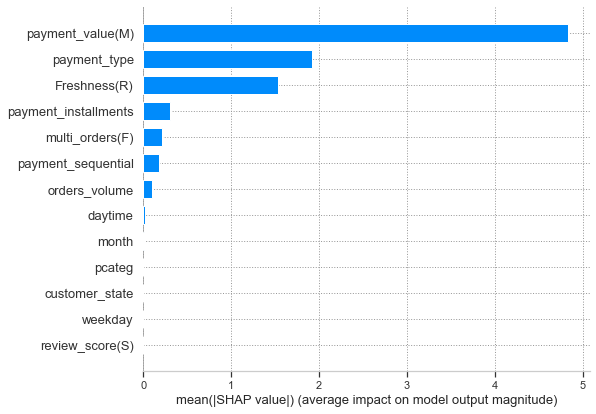

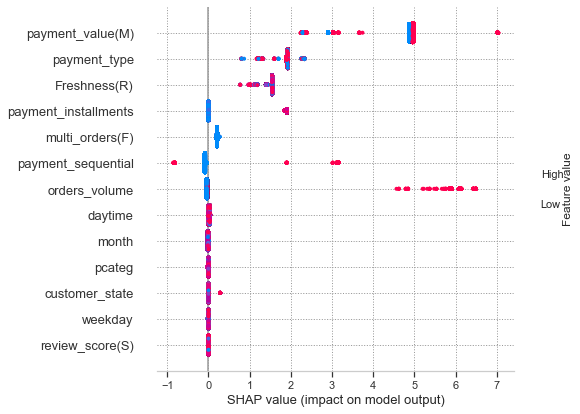

-------------- Class 1  --------------


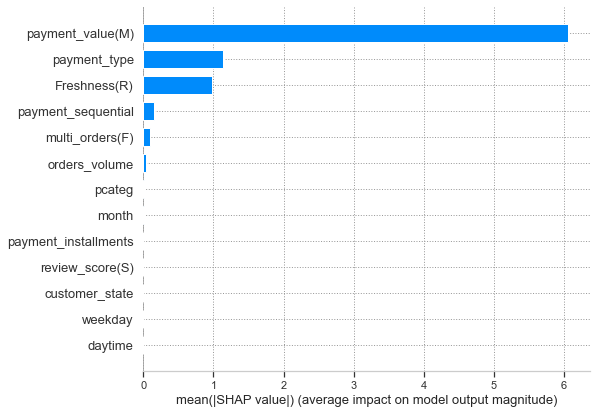

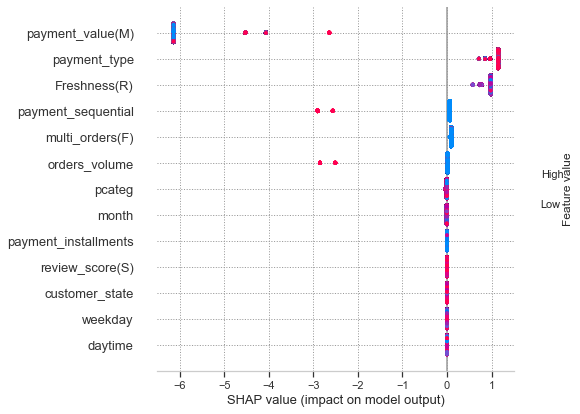

-------------- Class 2  --------------


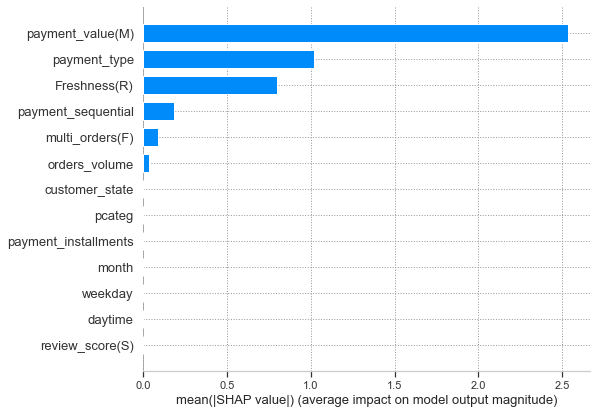

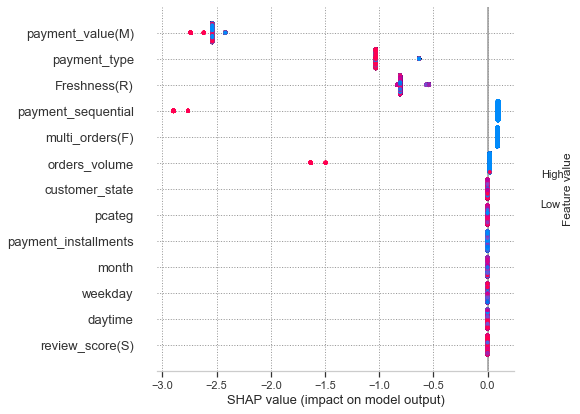

-------------- Class 3  --------------


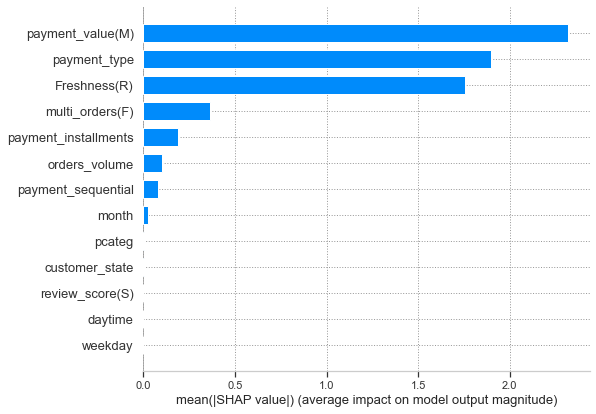

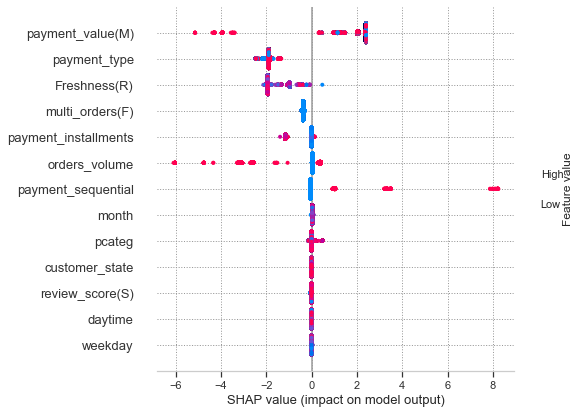

In [551]:
#Importance des attributs avec les SHAP values
for i in range(4):
    print('-------------- Class', str(i), ' --------------')
    explainer = shap.TreeExplainer(classifier.estimators_[i].best_estimator_)
    shap_values = explainer.shap_values(X)
    shap.summary_plot(shap_values, X, plot_type="bar")
    shap.summary_plot(shap_values, X)

À partir des SHAP values, deux groupes d’attributs sont importants :
<ul>
    <li><strong>RFM</strong>: Récence, Fréquence et Montant des commandes ;</li>
    <li><strong>Paiements</strong>: Types, Echelons, Tranches des paiement des commandes ;</li>
</ul>
<p>On affiche donc, les centroïdes des clusters avec ces dits attributs importants.</p>

In [557]:
data.groupby(by='Cluster').mean()[['Freshness(R)','multi_orders(F)','payment_value(M)','payment_type','payment_sequential','payment_installments']]

,Freshness(R),multi_orders(F),payment_value(M),payment_type,payment_sequential,payment_installments
Cluster,,,,,,
0,0.745553,0.000100,2.013313,2.990367,1.045792,4.257693
1,0.754190,0.000000,1.000000,2.999957,1.000300,2.269657
2,0.537860,0.000000,1.032201,2.190726,1.000000,1.595831
3,0.531888,0.134134,1.917891,2.388701,1.134234,2.861547


<ul>
    <li><strong>Cluster 0</strong>: clients ayant fait une seule commande récente avec un montant élevé et ayant payé cette commande avec une carte de crédit sur potentiellement beaucoup d’échelons ;</li>
    <li><strong>Cluster 1</strong>: clients ayant fait une seule commande récente avec un montant faible et ayant payé cette commande avec une carte de crédit sur peu d’échelons ;</li>
    <li><strong>Cluster 2</strong>: clients ayant fait une seule commande ancienne avec un montant faible et ayant payé cette commande par boleto et ce quasiment en une seule fois ;</li>
    <li><strong>Cluster 3</strong>: clients ayant fait une potentiellement plus d’une commande ancienne avec un montant total élevé et ayant payé plus par boleto en une seule fois que par carte de crédit en quelques échelons ;</li>
</ul>

<p><strong>À Noter ! </strong> l’orde/n° des clusters ne représente pas un ordre d’importance. Cela représente juste l’ordre de leur découverte par le modèle.</p>
